In [1]:
%matplotlib inline
import numpy as np
from matplotlib import pyplot as plt
import torch
from torch import nn, optim
from torch.autograd import Variable
import time
from time import strftime, localtime

import wavenet_model as wavemod
import MBH_generate as mbhb

import importlib
importlib.reload(wavemod)
importlib.reload(mbhb)

CUDA = True

/home/nataliak/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
torch.cuda.get_device_name(0)

'GeForce GTX 1080 Ti'

In [9]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


## sine wave generator

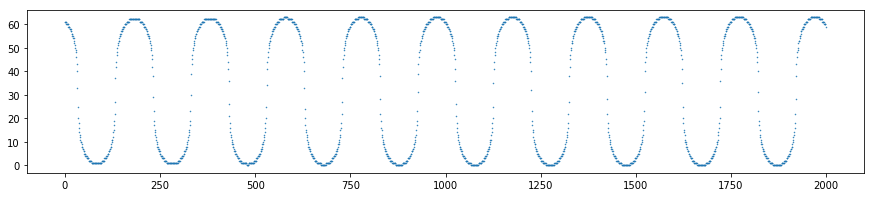

In [4]:
def sine_generator(seq_size = 6000, mu=256):
    framerate = 44100
    t = np.linspace(0,5,framerate*5)
    data = np.sin(2*np.pi*220*t) + np.sin(2*np.pi*224*t)
    data = data/2
    while True:
        start = np.random.randint(0,data.shape[0]-seq_size)
        ys = data[start:start+seq_size]
        ys = encode_mu_law(ys,mu)
        yield Variable(torch.from_numpy(ys[:seq_size]))
        
g = sine_generator(mu=64, seq_size=2000)
x = next(g)
plt.figure(figsize=[15,3])
plt.plot(x.data.tolist(),'.', ms=1)

## sine gaussian generator

In [6]:
def sine_gaussian_generator(mu):
    
    framerate = 1000
    t = np.linspace(0,5,framerate*5)
    a = 1.0
    phi_0 = np.pi
    f_0 = 2.0
    tau = 0.5
       
    while True:
        
        t_0 = np.random.uniform(t.min(), t.max())   
        signal = a*(np.exp(-(t-t_0)**2/tau**2))*(np.cos(2*np.pi*f_0*(t-t_0)+phi_0))
        #noise = np.random.normal(0.0, 0.01, t.size)
        #data = signal + noise
        ys = wavemod.encode_mu_law(signal, mu)
        ys = Variable(torch.from_numpy(ys)).to(device)
        
        #if (torch.cuda.is_available() and CUDA):
        #    ys = ys.cuda()
            
        yield ys

torch.Size([5000])

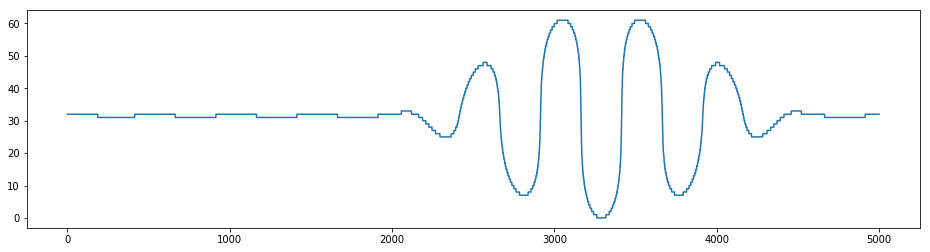

In [7]:
g = sine_gaussian_generator(mu=64)
x = next(g)

plt.figure(figsize=[16,4])
plt.plot(x.data.tolist(), ms=1)

x.shape

In [7]:
framerate = 1000
t = np.linspace(0,5,framerate*5)

t.shape

(5000,)

# Length and cadence

In [4]:
dt = 20.0
Tobs = 15*24*3600  # 2 weeks of data, cadance 100 seconds
N = int(Tobs/dt)

# Generate LISA like noise in time domain

In [5]:
# Define the frequency range
df = 1./Tobs
F = 0.5/dt
Nf = int(F/df+1)
freq = np.arange(Nf)*df

# Generate the noise for A and E antenna combinations
noise_freq = mbhb.generate_noise_AE(freq)

# Inverse transform the noise to the time domain
tm, noise_time = mbhb.ComputeTD(noise_freq, dt)
print(tm)
print(len(tm))


[0.00000e+00 2.00000e+01 4.00000e+01 ... 1.29594e+06 1.29596e+06
 1.29598e+06]
64800


# MBHB generator

In [6]:
def MBH_generator(mu,noise):
    
    tvec = np.arange(N)*dt
    print(len(tvec))
    print(tvec)
    theta = []
    
    theta.append(1.0) # [0] red shift
    z = theta[0]
    theta.append(0.32e6*(1.+z)) # [1] red shifted mass one
    theta.append(1.e6*(1.+z))   # [2] red shifted mass two
    theta.append(0.81) # [3] spin magnitude of the first 
    theta.append(0.73) # [4] spin magnitude of the second
    theta.append(-0.7415926535898035) # [5] psi -- polarisation angle
    theta.append(1.1) # [6] inclination angle with respect to barycenter
    theta.append(4.647) # [7] lambda -- sky position, longitude (barycenter)
    theta.append(-0.07) # [8] beta -- sky position, latitude (barycenter)
    theta.append(60*24*3600) # [9] Tc -- coalescence time 
    theta.append(dt)  # [10] casence
    theta.append(Tobs)  # [11] Tobs -- observation time, two months 
        
       
    while True:
        
        tc = np.random.uniform((Tobs-2*24*3600), Tobs)
        #theta[9] = tc
        mbh = mbhb.MBHB_TD(theta)
        A, E = mbh.TDI_signal(tvec)
        A_noise = A + noise
        signal = mbhb.normalise(A_noise)
        print(len(signal))
        
        plt.figure(figsize=[16,4])
        plt.plot(signal.data.tolist())
        
        
        #noise = np.random.normal(0.0, 0.01, t.size)
        
        ys = wavemod.encode_mu_law(signal, mu)
        #ys = signal
        ys = Variable(torch.from_numpy(ys)).to(device)
        
        plt.figure(figsize=[16,4])
        plt.plot(ys.data.tolist())
        
            
        yield ys

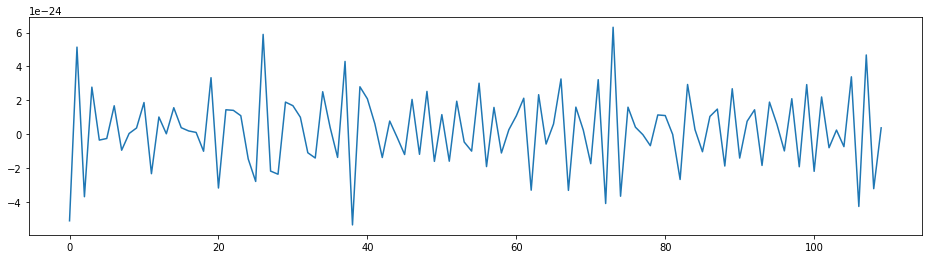

In [7]:
plt.figure(figsize=[16,4])
plt.plot(noise_time.data.tolist()[8990:9100])

64800
[0.00000e+00 2.00000e+01 4.00000e+01 ... 1.29594e+06 1.29596e+06
 1.29598e+06]
64800


torch.Size([64800])

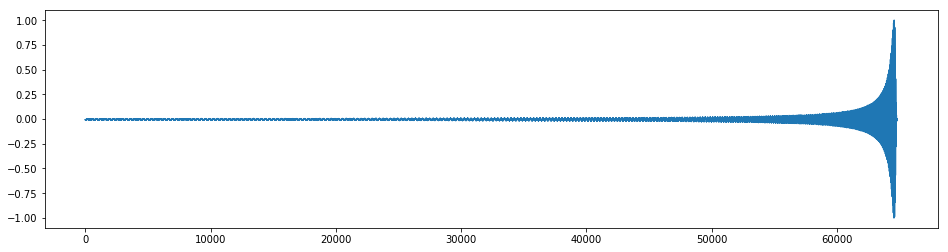

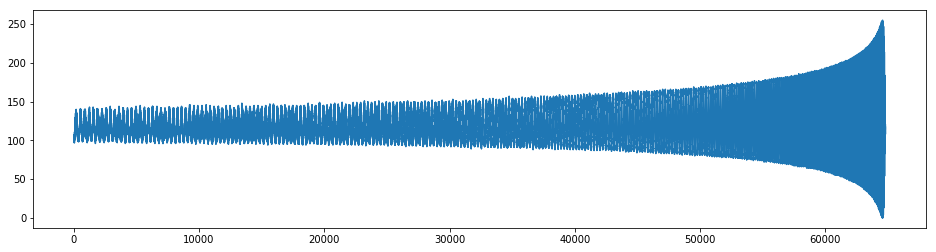

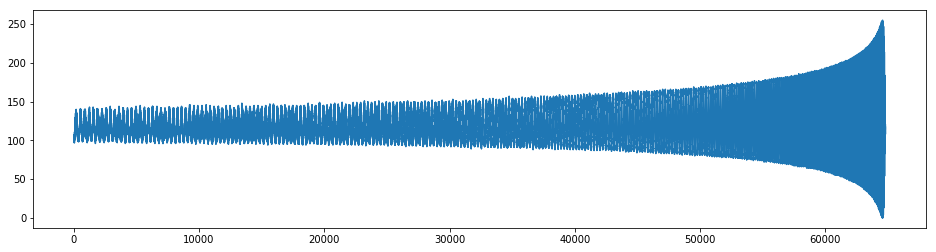

In [10]:
g_all = MBH_generator(mu=256,noise=noise_time)
x_all = next(g_all)

plt.figure(figsize=[16,4])
plt.plot(x_all.data.tolist())
#plt.plot(x.data.tolist(), ms=1)

x_all.shape

# Generate smaller batches

In [11]:
def MBH_generator_batch(mu,seq_size,noise):
    
    tvec = np.arange(N)*dt
    theta = []
    
    theta.append(1.0) # [0] red shift
    z = theta[0]
    theta.append(0.32e6*(1.+z)) # [1] red shifted mass one
    theta.append(1.e6*(1.+z))   # [2] red shifted mass two
    theta.append(0.81) # [3] spin magnitude of the first 
    theta.append(0.73) # [4] spin magnitude of the second
    theta.append(-0.7415926535898035) # [5] psi -- polarisation angle
    theta.append(1.1) # [6] inclination angle with respect to barycenter
    theta.append(4.647) # [7] lambda -- sky position, longitude (barycenter)
    theta.append(-0.07) # [8] beta -- sky position, latitude (barycenter)
    theta.append(60*24*3600) # [9] Tc -- coalescence time 
    theta.append(dt)  # [10] casence
    theta.append(Tobs)  # [11] Tobs -- observation time, two months 
    
    mbh = mbhb.MBHB_TD(theta)
    A, E = mbh.TDI_signal(tvec)
    A_noise = A + noise
    signal = mbhb.normalise(A_noise)

    while True:
        start = np.random.randint(0,signal.shape[0]-seq_size)
        ys = signal[start:start+seq_size]
        ys =wavemod.encode_mu_law(ys,mu)
        yield Variable(torch.from_numpy(ys[:seq_size])).to(device)
        




torch.Size([10000])

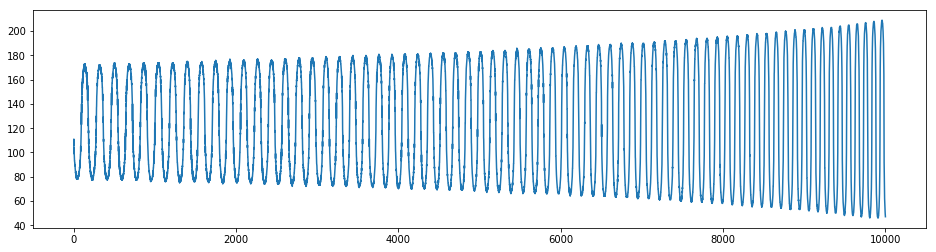

In [12]:
g = MBH_generator_batch(mu=256,seq_size=10000,noise=noise_time)
x = next(g)

plt.figure(figsize=[16,4])
plt.plot(x.data.tolist())
#plt.plot(x.data.tolist(), ms=1)

x.shape

64800
64800
64800
64800
64800


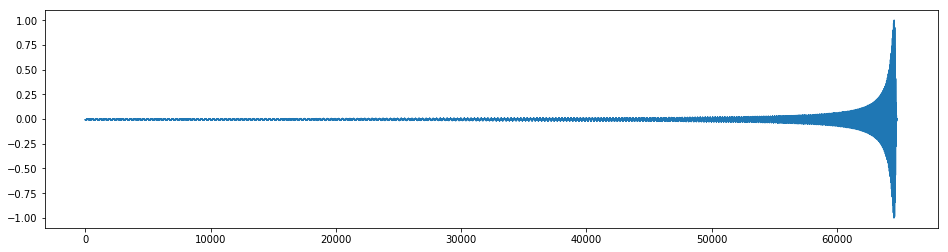

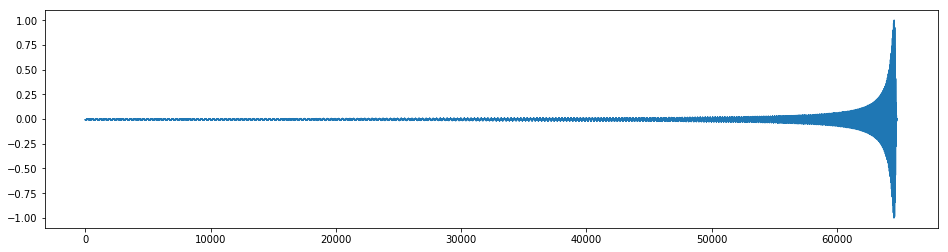

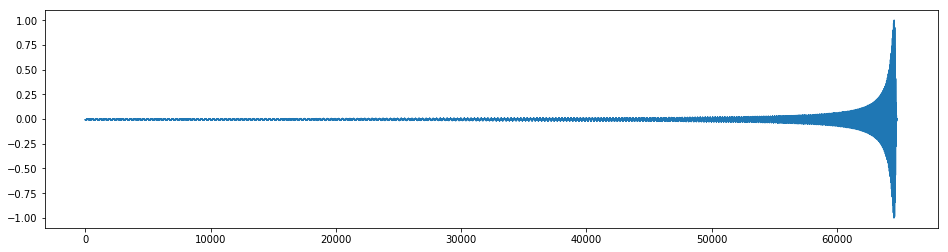

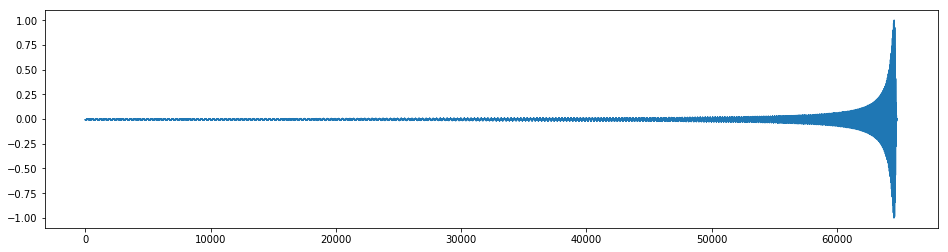

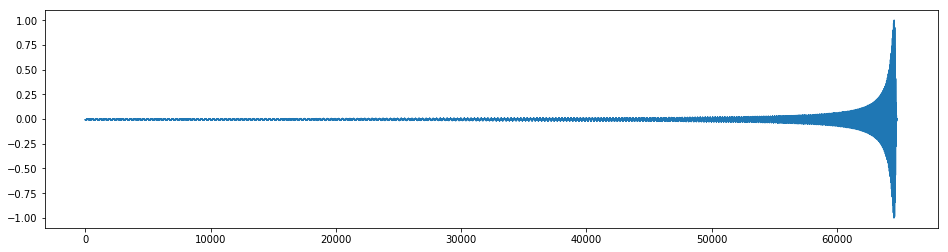

In [122]:
for epoch in range(1):
    
    for _ in range(5):
        
        batch = next(g)
        #plt.figure()
        #plt.plot(batch.data.tolist(), ms=1)

## network training

This network tries to generate the vibrating sine wave above. 
- The audio signal is quantized to 64 discrete integers.
- 24 channels in residue outputs
- 128 channels in skip outputs
- 20 dilation layers (n_repeat=2, dilation_depth=10)

No checkpoint found - Initializing new training


/home/nataliak/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:32: UserWarning: invalid index of a 0-dim tensor. This will be an error in PyTorch 0.5. Use tensor.item() to convert a 0-dim tensor to a Python number


It took 2.37 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
epoch 10, loss 4.739488124847412


/home/nataliak/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:38: UserWarning: invalid index of a 0-dim tensor. This will be an error in PyTorch 0.5. Use tensor.item() to convert a 0-dim tensor to a Python number


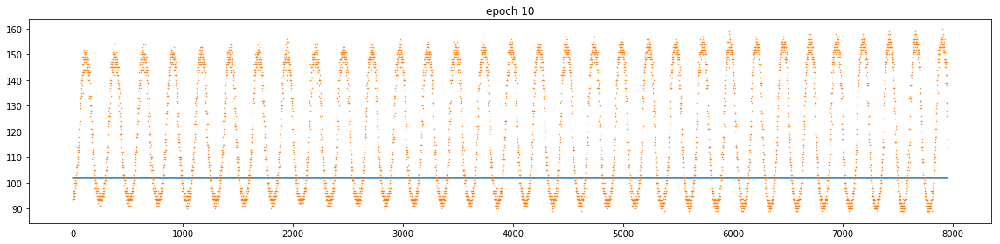

It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 20, loss 3.4922962188720703


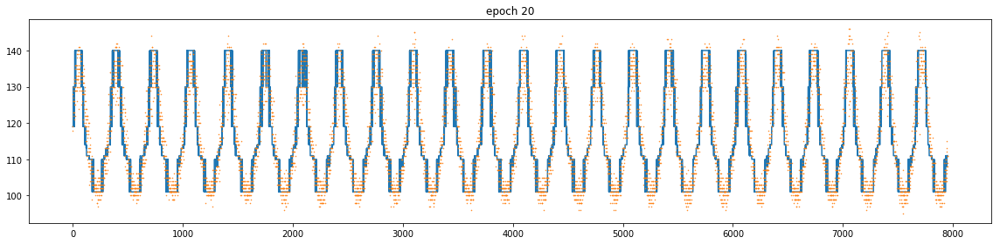

It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 30, loss 2.7845664024353027


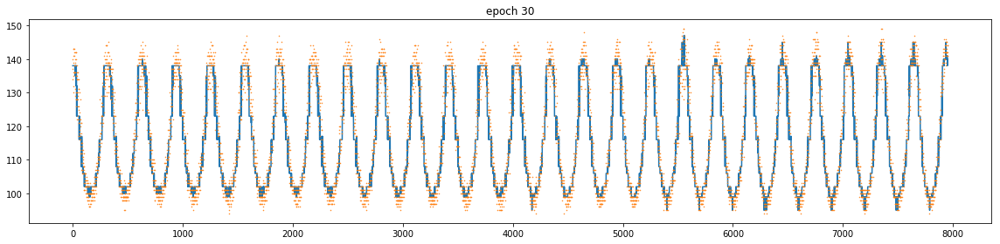

It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 40, loss 2.5582103729248047


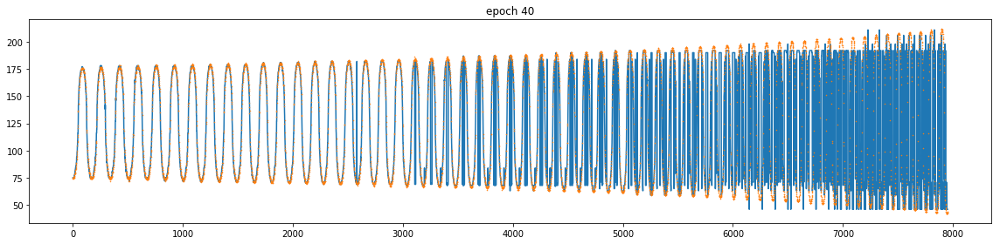

It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 50, loss 2.426811933517456


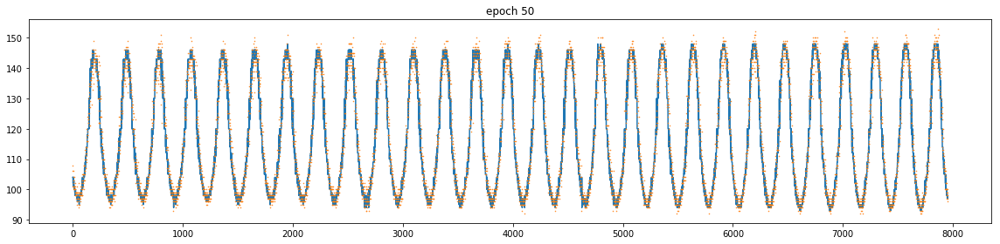

Checkpoint saved: checkpoint_epoch_mbh_batch_50_2018_07_27__10_28.pth
It took 0.13 seconds to save data file
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 60, loss 2.39271879196167


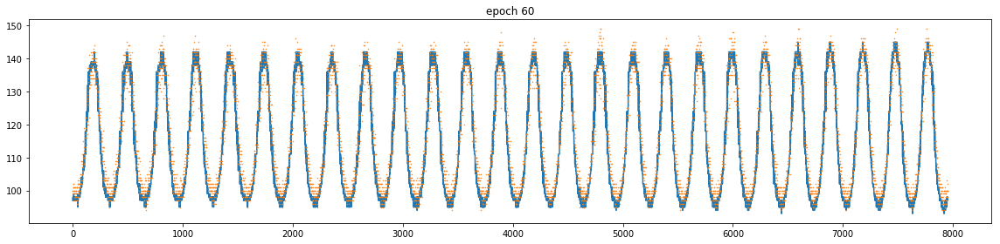

It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 70, loss 2.245532512664795


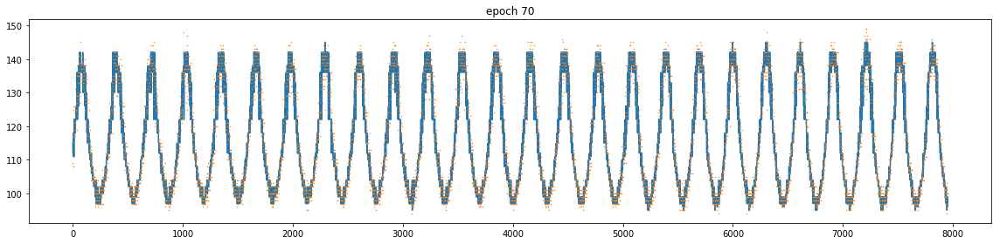

It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 80, loss 2.2006676197052


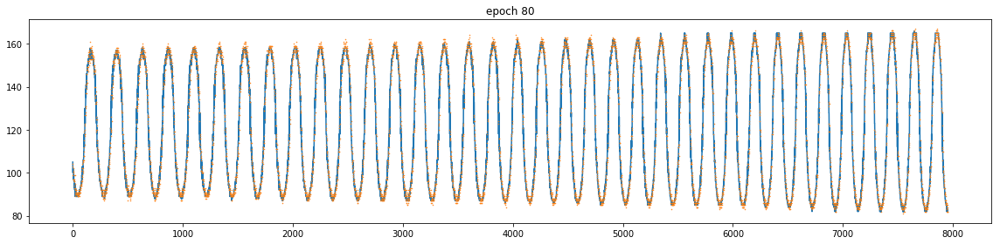

It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
epoch 90, loss 2.1022708415985107


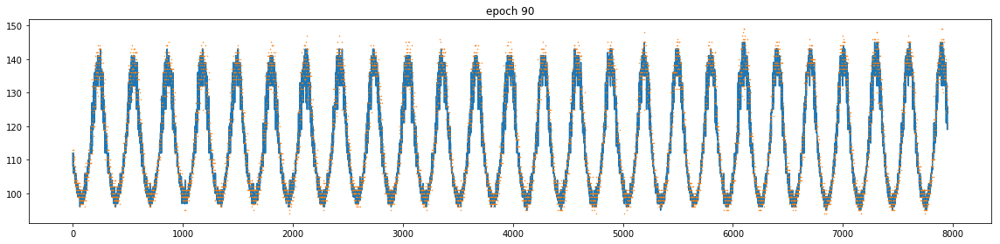

It took 1.25 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 100, loss 1.9956845045089722


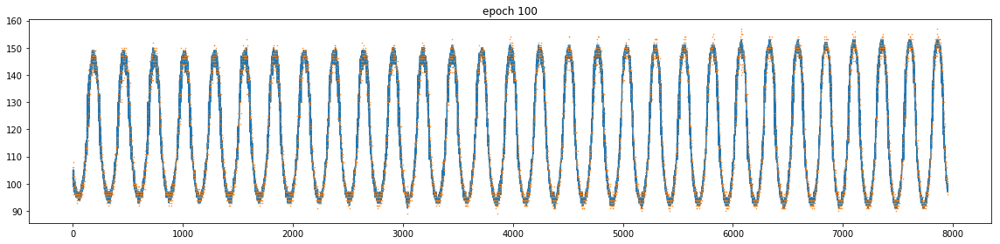

Checkpoint saved: checkpoint_epoch_mbh_batch_100_2018_07_27__10_29.pth
It took 0.04 seconds to save data file
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 110, loss 1.937042236328125


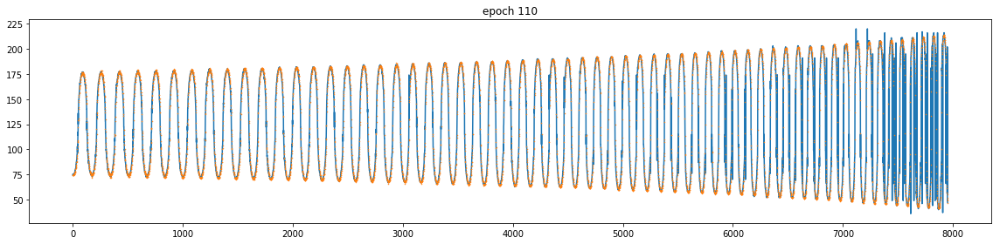

It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 120, loss 1.9318230152130127


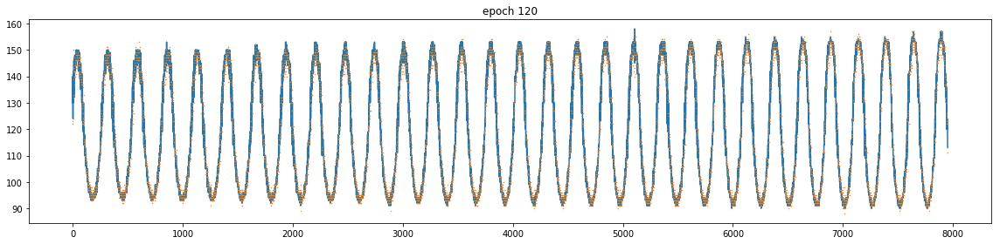

It took 1.27 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.40 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
epoch 130, loss 2.105943202972412


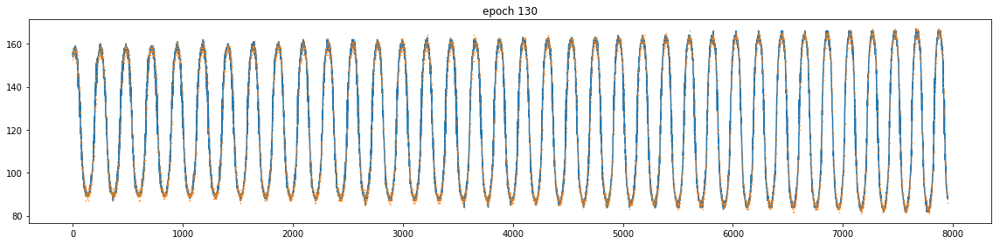

It took 1.30 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 140, loss 1.9780374765396118


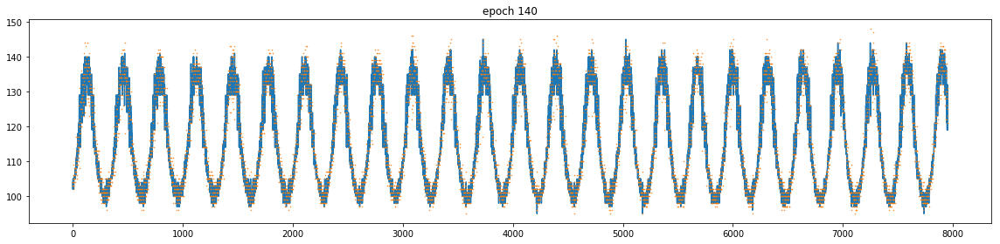

It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 150, loss 1.931546926498413


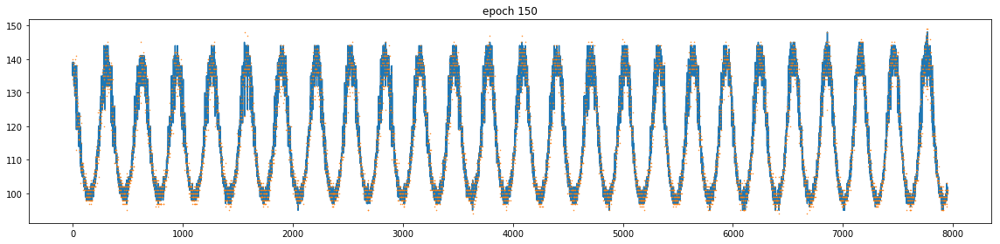

Checkpoint saved: checkpoint_epoch_mbh_batch_150_2018_07_27__10_30.pth
It took 0.04 seconds to save data file
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 160, loss 1.9065741300582886


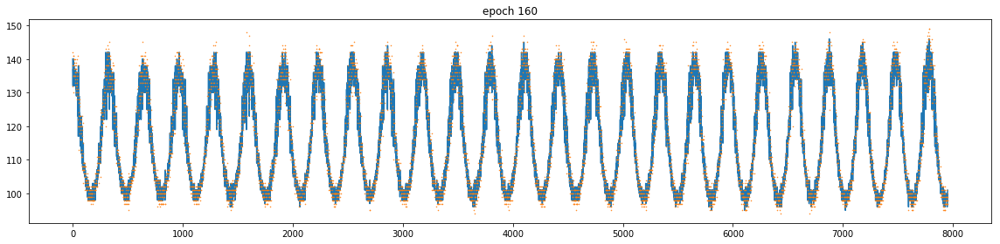

It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 170, loss 1.8882123231887817


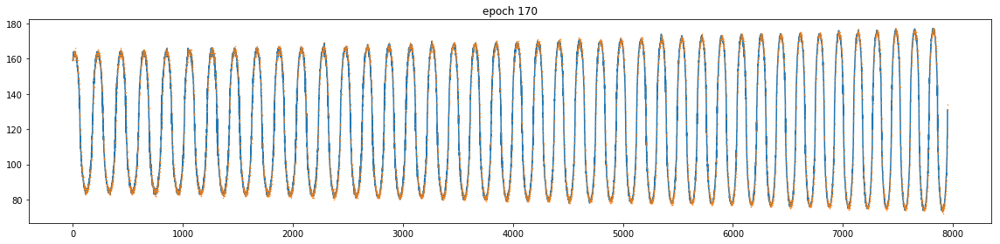

It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 180, loss 1.8639624118804932


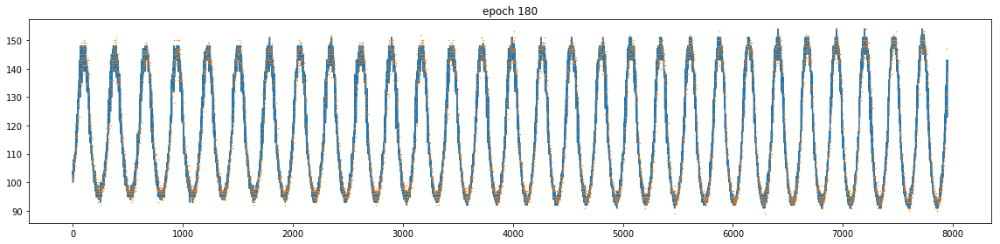

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 190, loss 1.8860995769500732


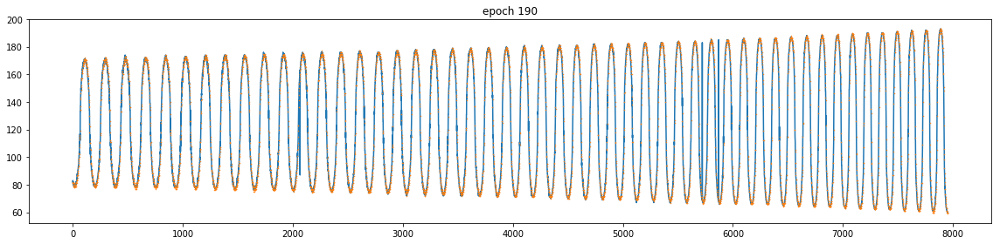

It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 200, loss 1.8220607042312622


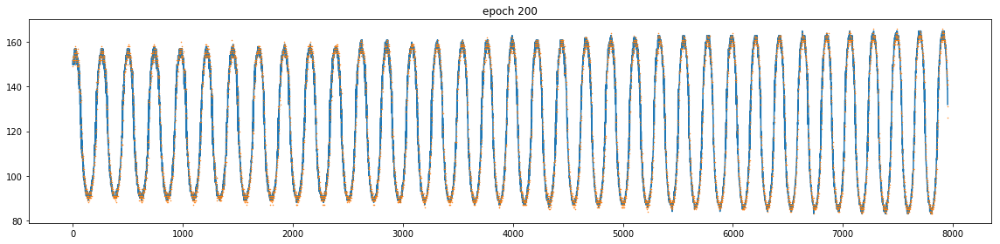

Checkpoint saved: checkpoint_epoch_mbh_batch_200_2018_07_27__10_31.pth
It took 0.09 seconds to save data file
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 210, loss 1.8063631057739258


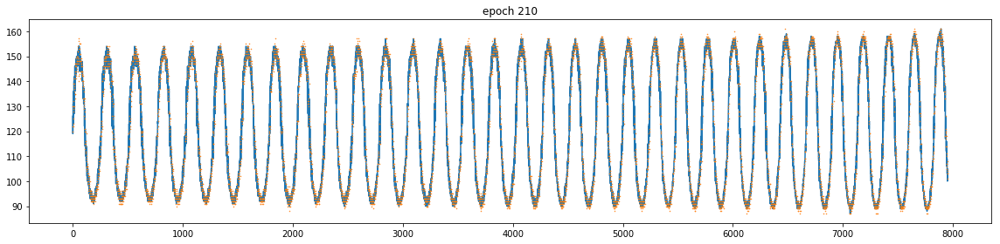

It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 220, loss 1.7153147459030151


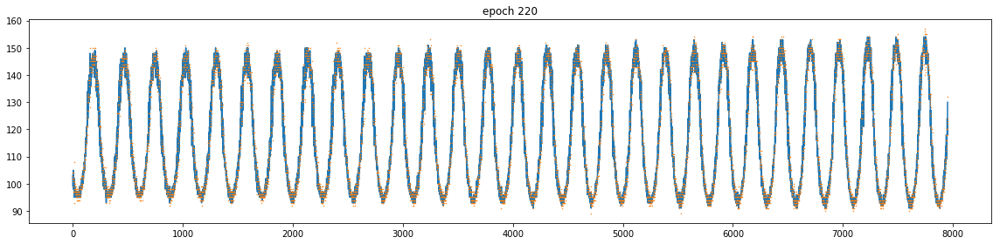

It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 230, loss 1.7670029401779175


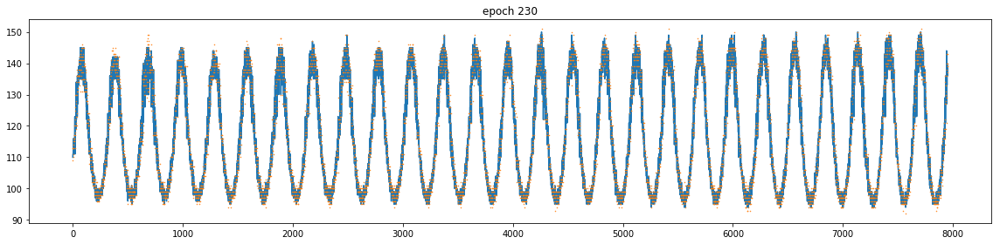

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 240, loss 1.7996410131454468


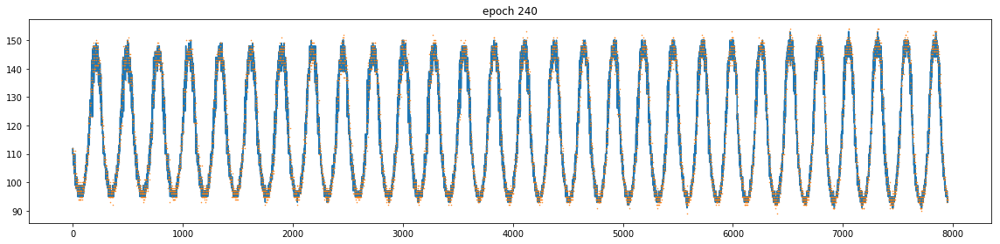

It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 250, loss 1.7161740064620972


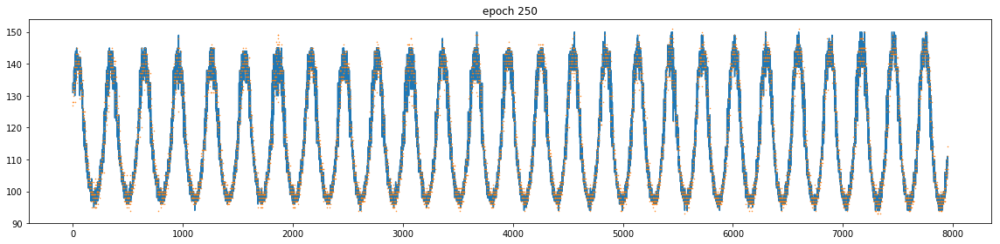

Checkpoint saved: checkpoint_epoch_mbh_batch_250_2018_07_27__10_32.pth
It took 0.04 seconds to save data file
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 260, loss 1.746624231338501


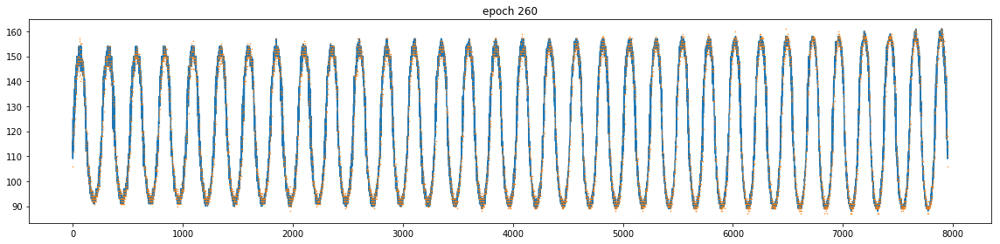

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 270, loss 1.7123732566833496


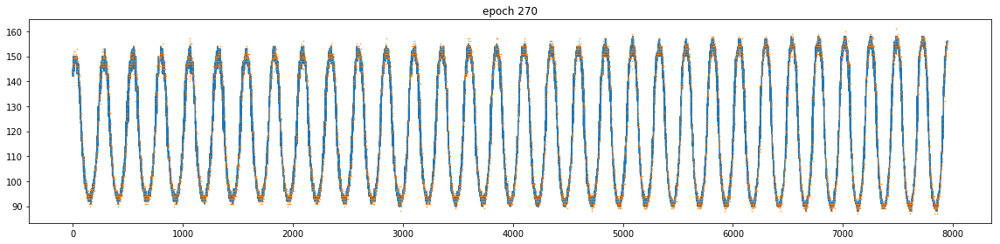

It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 280, loss 1.6531199216842651


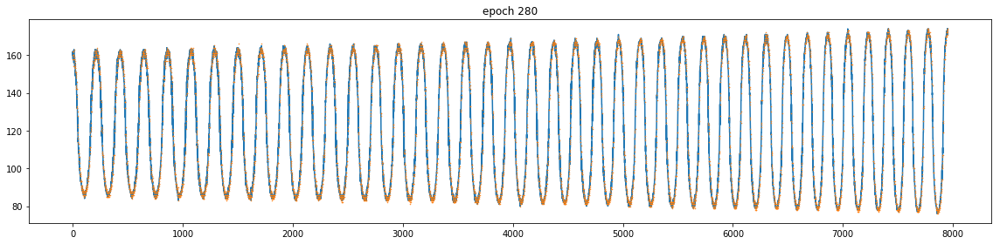

It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 290, loss 1.693122148513794


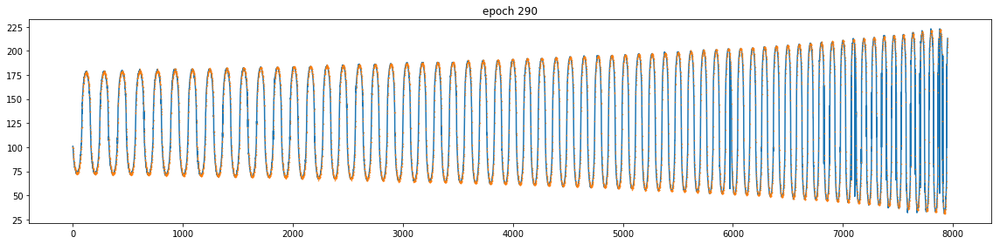

It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 300, loss 1.740713357925415


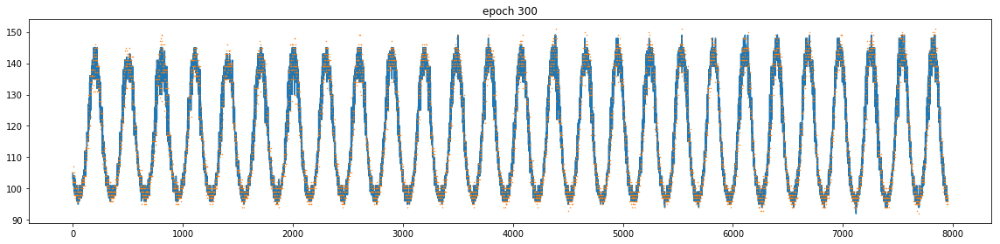

Checkpoint saved: checkpoint_epoch_mbh_batch_300_2018_07_27__10_33.pth
It took 0.05 seconds to save data file
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 310, loss 1.6943504810333252


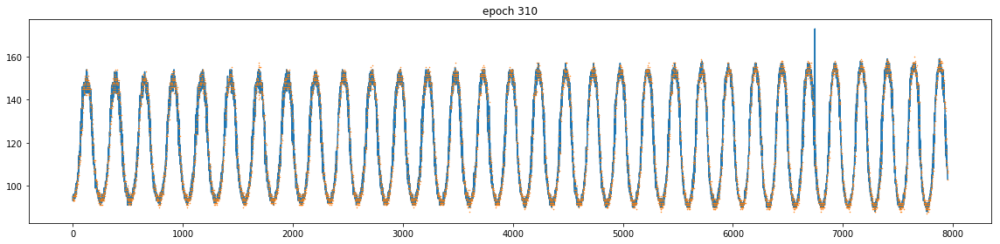

It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 320, loss 1.585936188697815


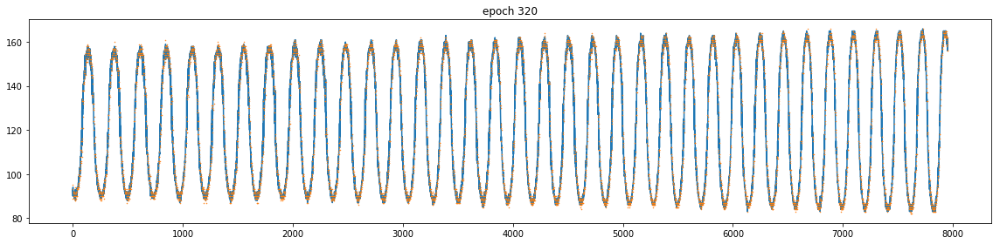

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 330, loss 1.4832546710968018


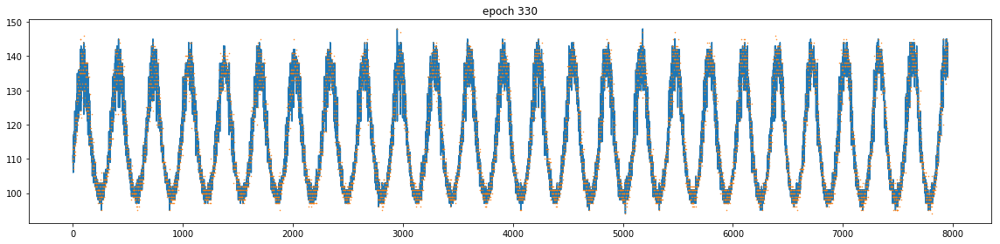

It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 340, loss 1.546927809715271


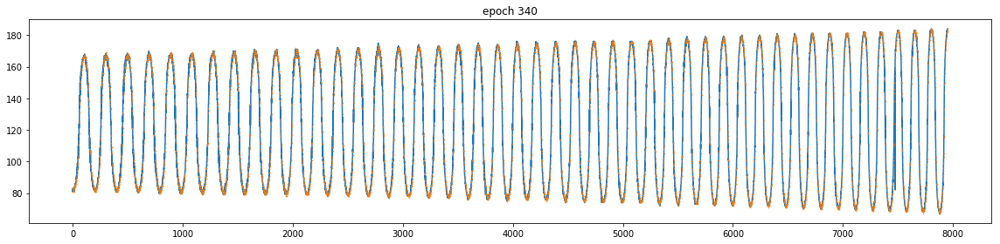

It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 350, loss 1.5492621660232544


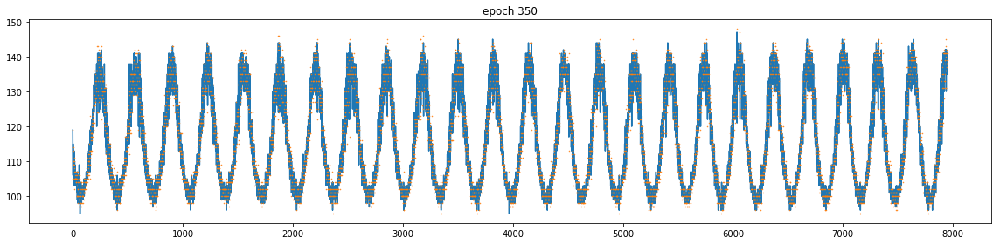

Checkpoint saved: checkpoint_epoch_mbh_batch_350_2018_07_27__10_34.pth
It took 0.05 seconds to save data file
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 360, loss 1.577146053314209


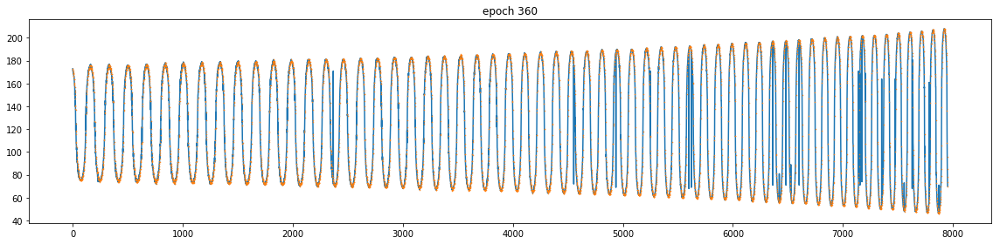

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 370, loss 1.3980796337127686


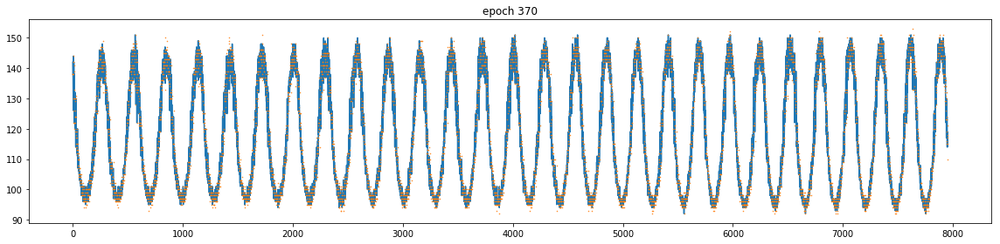

It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 380, loss 1.5166314840316772


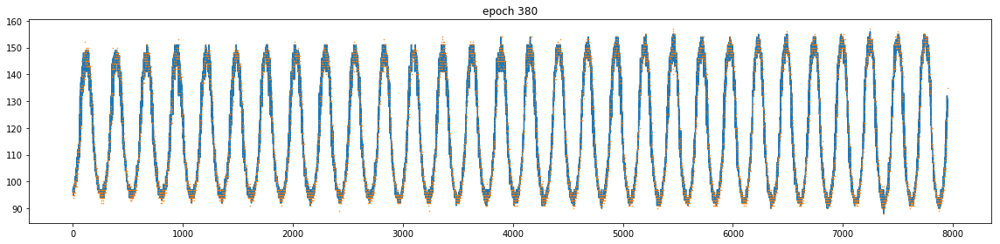

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 390, loss 1.5475598573684692


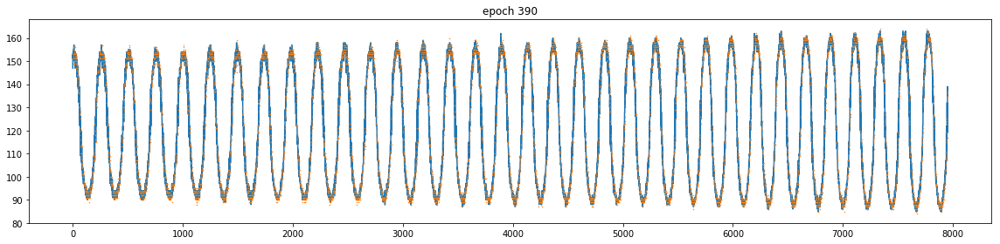

It took 1.29 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 400, loss 1.449938178062439


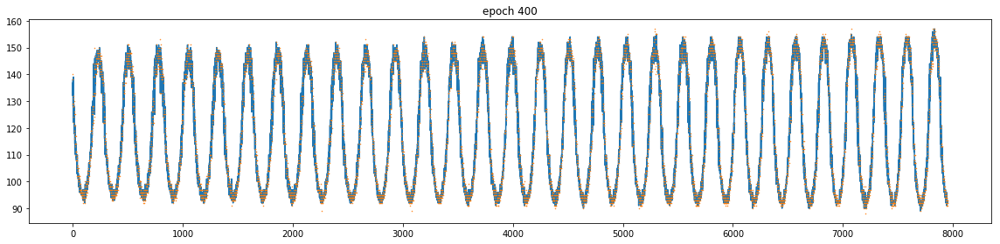

Checkpoint saved: checkpoint_epoch_mbh_batch_400_2018_07_27__10_35.pth
It took 0.05 seconds to save data file
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 410, loss 1.3397783041000366


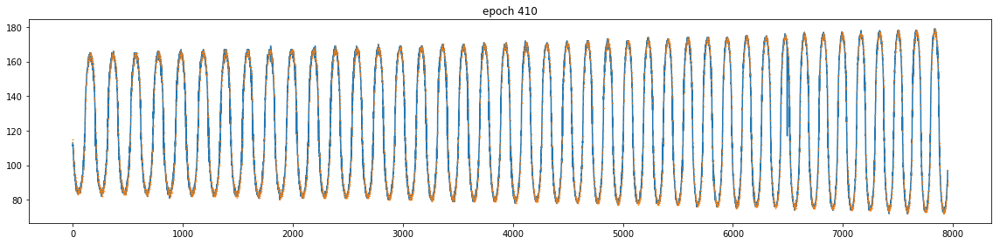

It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 420, loss 1.4642454385757446


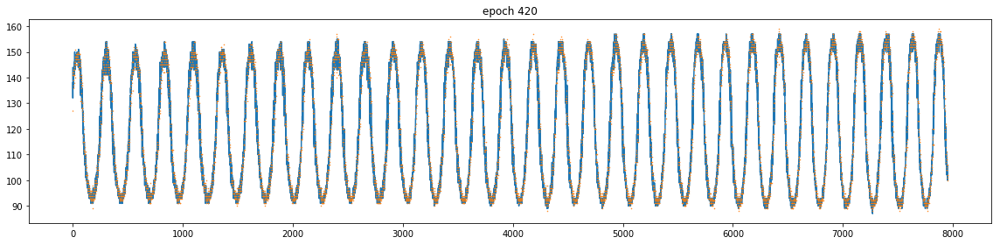

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 430, loss 1.3286763429641724


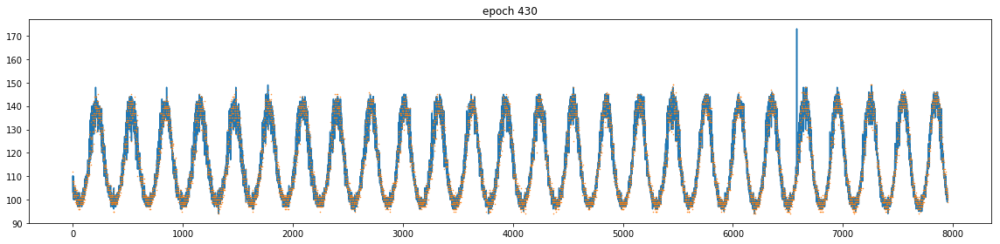

It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 440, loss 1.2693183422088623


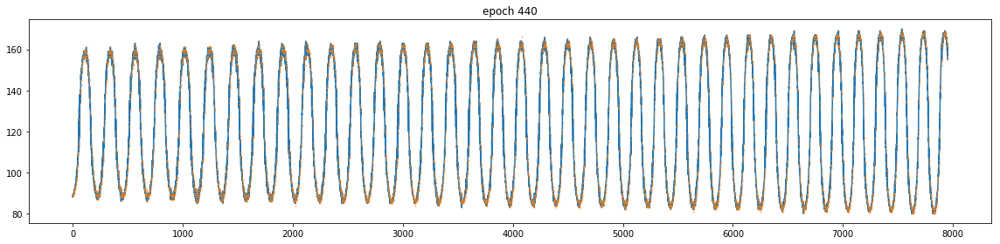

It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 450, loss 1.2199177742004395


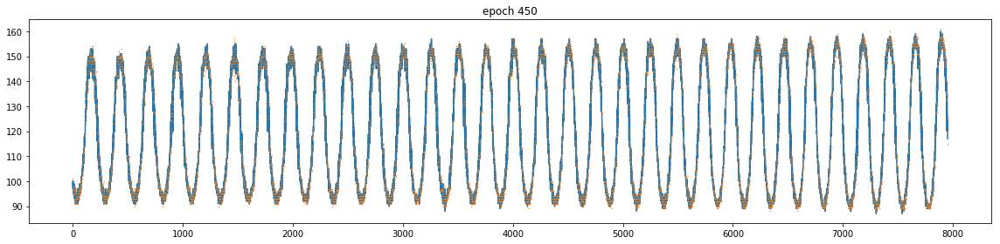

Checkpoint saved: checkpoint_epoch_mbh_batch_450_2018_07_27__10_36.pth
It took 0.05 seconds to save data file
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 460, loss 1.102243185043335


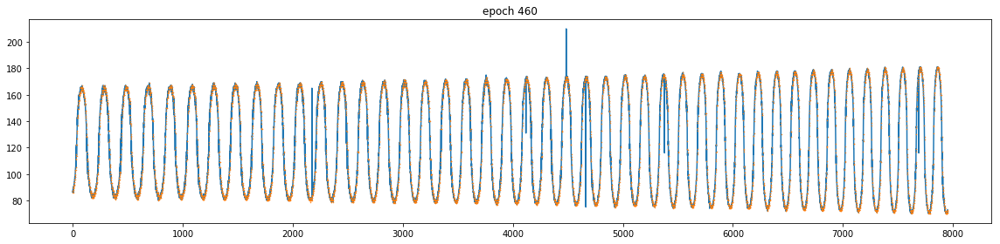

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 470, loss 1.2014836072921753


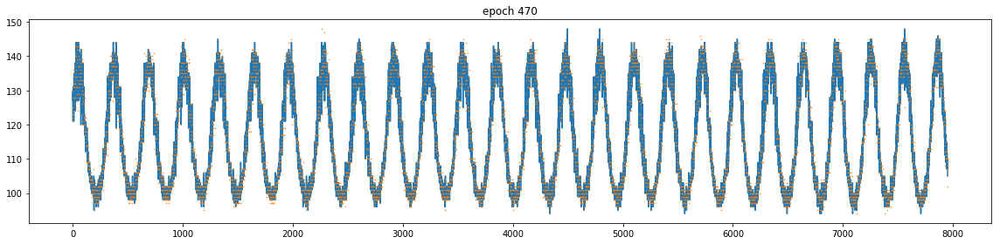

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 480, loss 1.2286601066589355


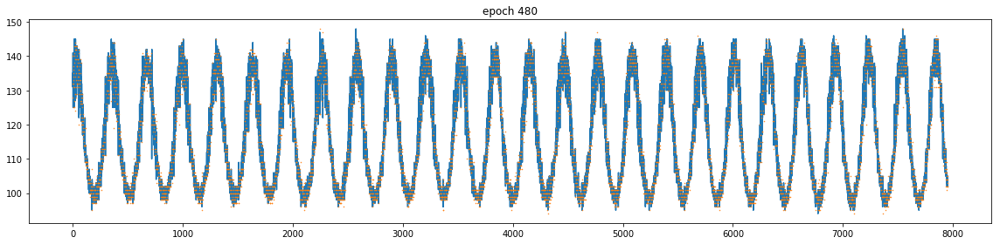

It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 490, loss 0.9799922704696655


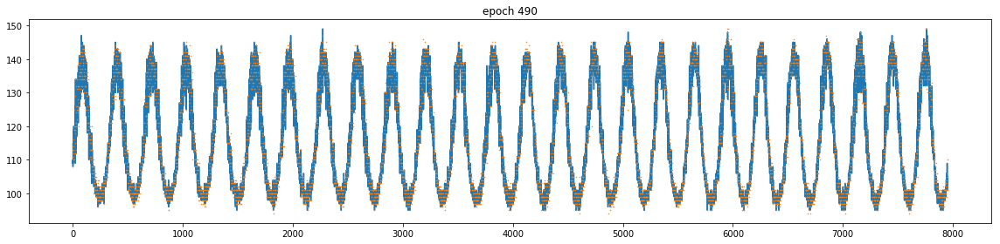

It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 500, loss 1.0057170391082764


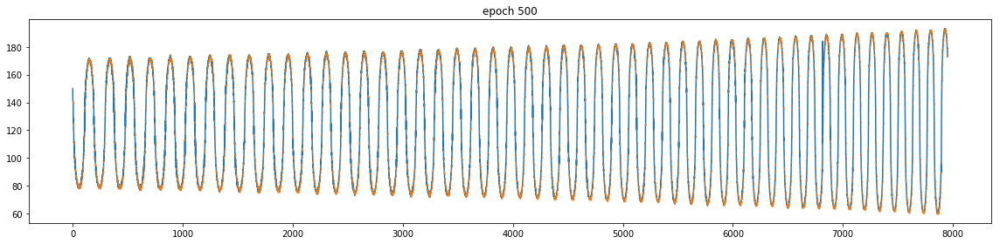

Checkpoint saved: checkpoint_epoch_mbh_batch_500_2018_07_27__10_38.pth
It took 0.05 seconds to save data file
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 510, loss 1.0401674509048462


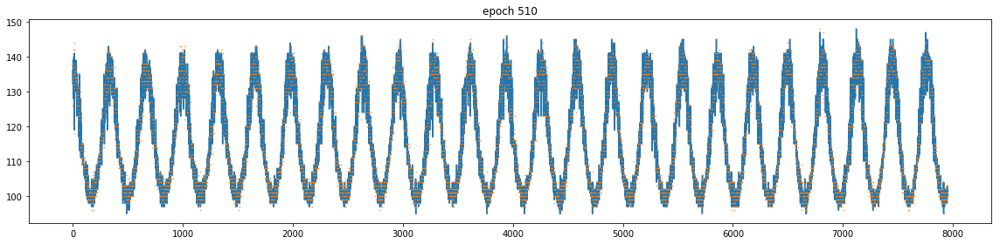

It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 520, loss 1.0352035760879517


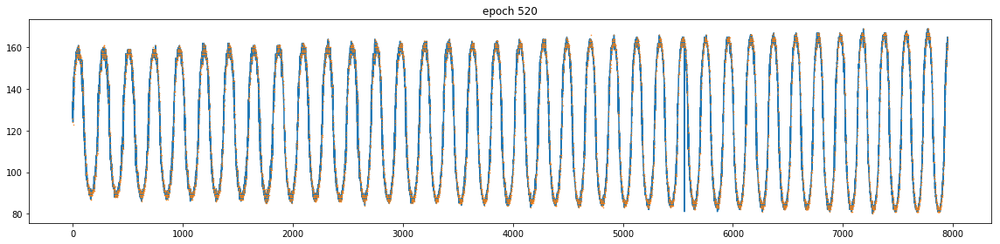

It took 1.24 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 530, loss 0.9622006416320801


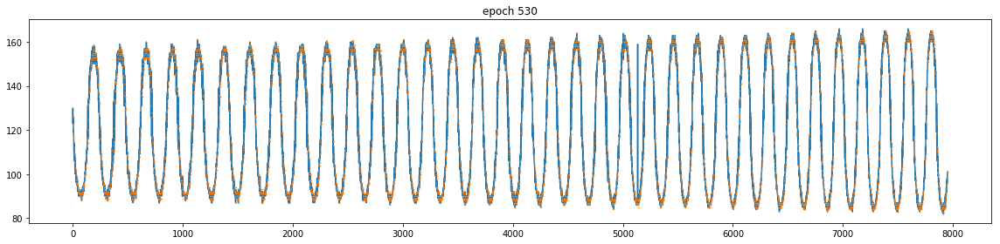

It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 540, loss 1.0221812725067139


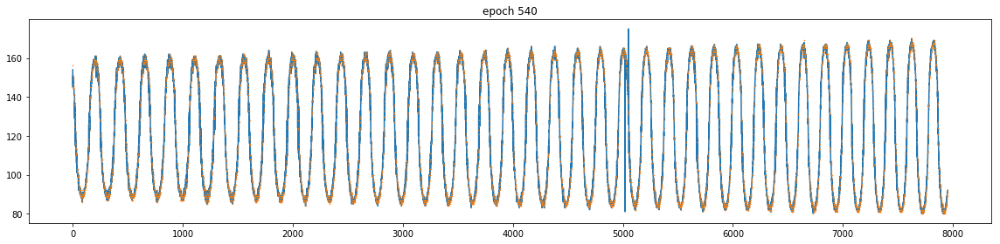

It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 550, loss 1.0077519416809082


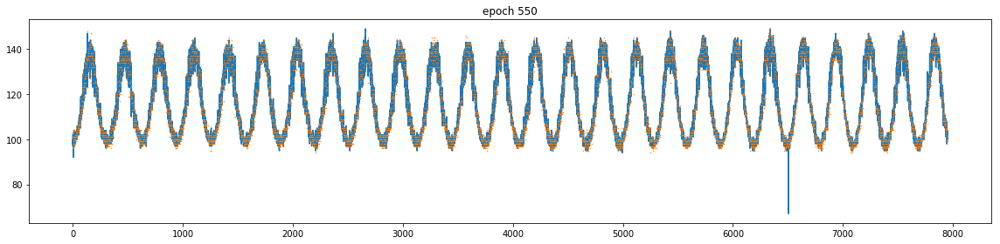

Checkpoint saved: checkpoint_epoch_mbh_batch_550_2018_07_27__10_39.pth
It took 0.05 seconds to save data file
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 560, loss 0.8439081907272339


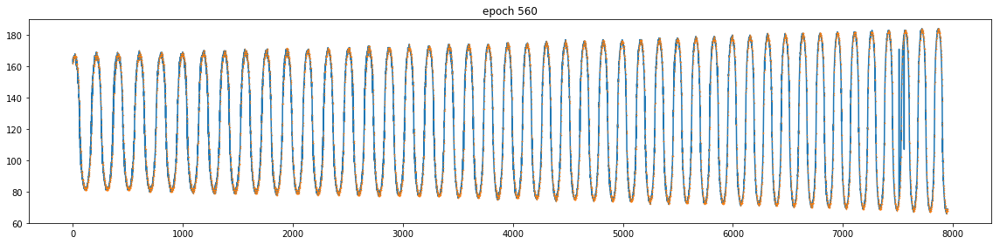

It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 570, loss 0.834987998008728


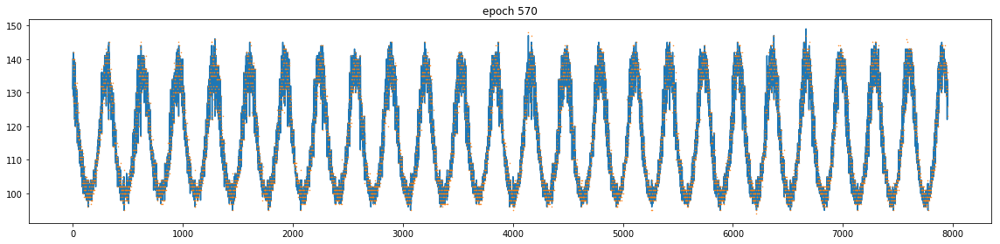

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 580, loss 0.8097135424613953


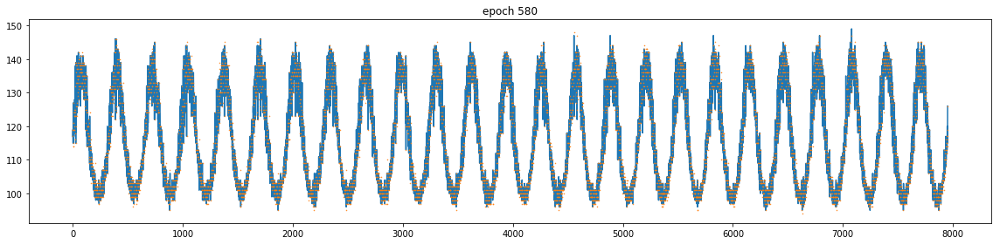

It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 590, loss 0.7756621241569519


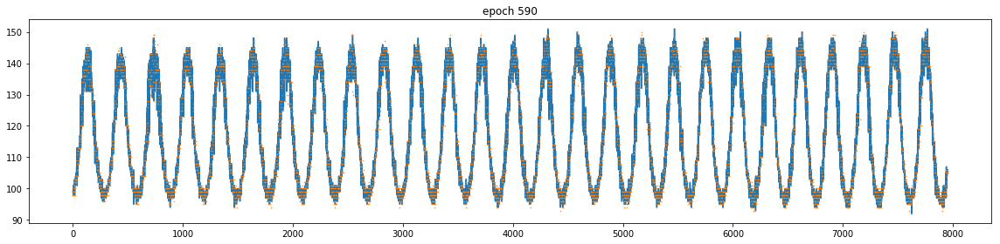

It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 600, loss 0.6575350761413574


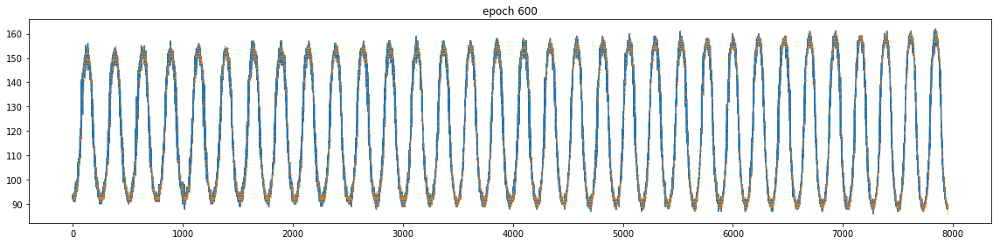

Checkpoint saved: checkpoint_epoch_mbh_batch_600_2018_07_27__10_40.pth
It took 0.05 seconds to save data file
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 610, loss 0.802310049533844


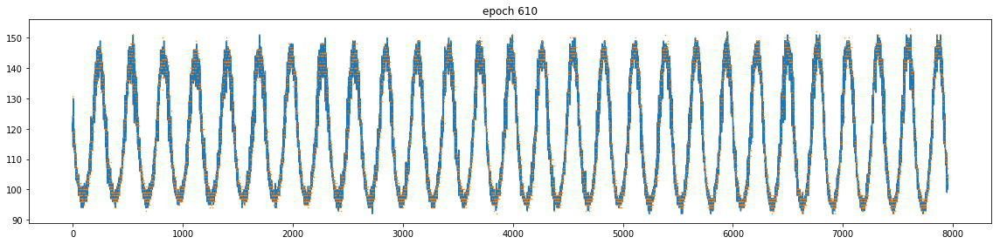

It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 620, loss 0.6968002319335938


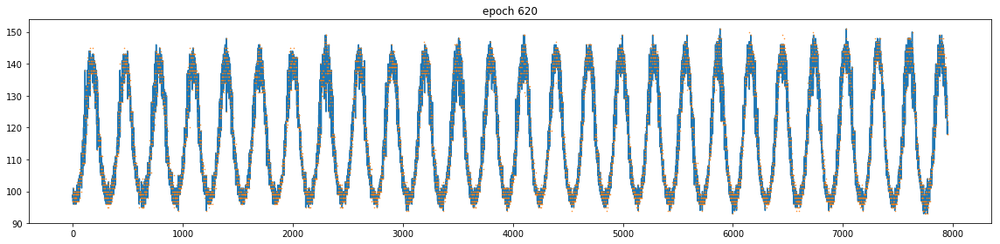

It took 1.26 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 630, loss 0.8070566654205322


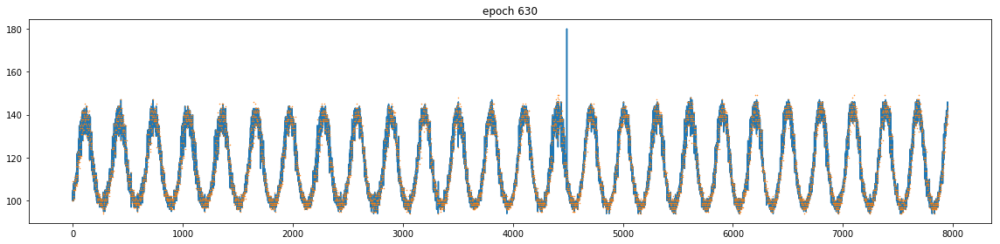

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 640, loss 0.6621057391166687


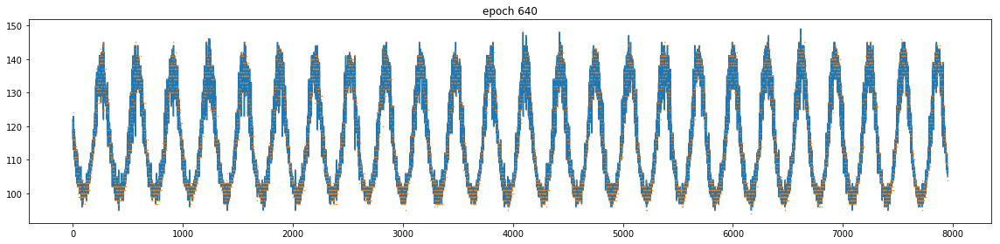

It took 1.29 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 650, loss 0.5035129189491272


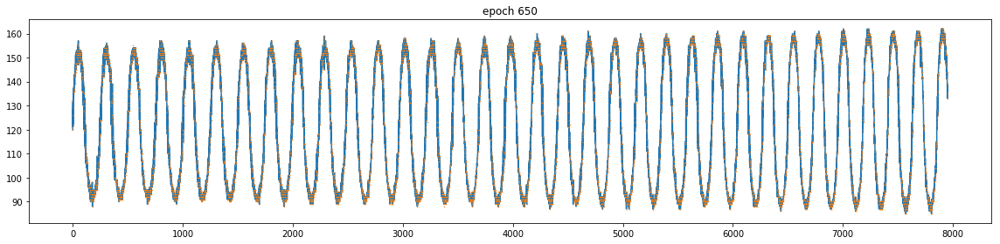

Checkpoint saved: checkpoint_epoch_mbh_batch_650_2018_07_27__10_41.pth
It took 0.05 seconds to save data file
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 660, loss 0.5574549436569214


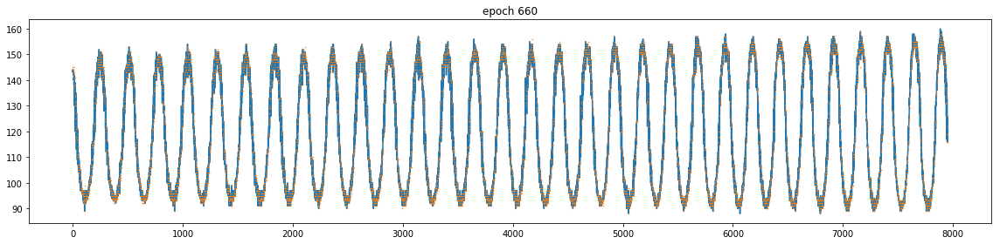

It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 670, loss 0.6017876863479614


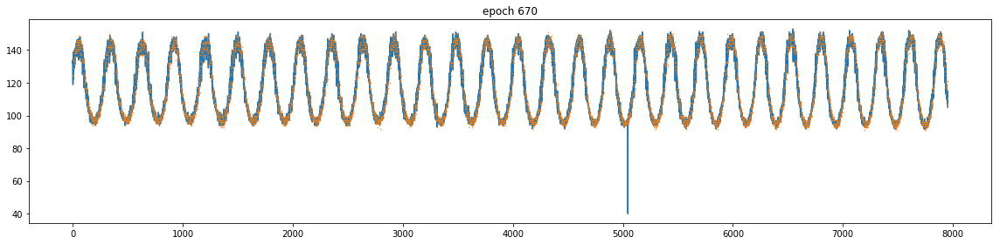

It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 680, loss 0.7849571704864502


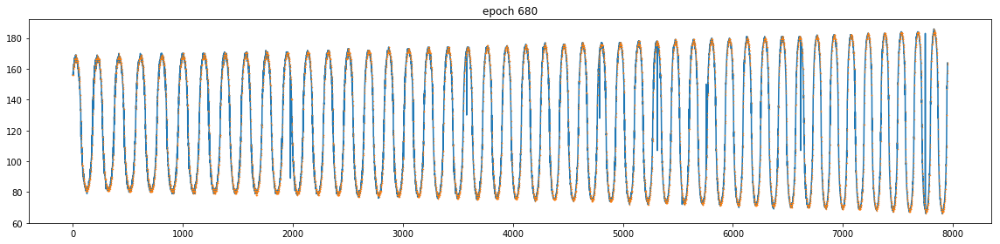

It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 690, loss 0.5046012997627258


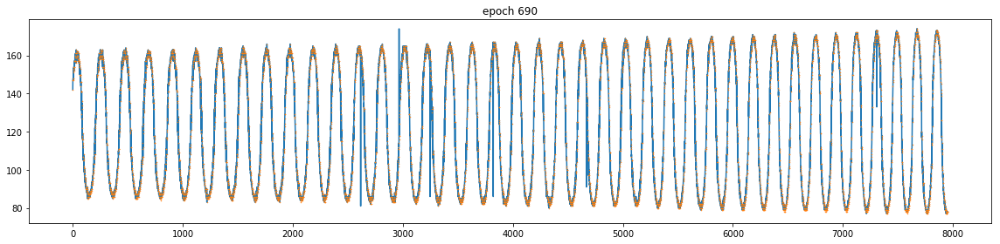

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 700, loss 0.41788965463638306


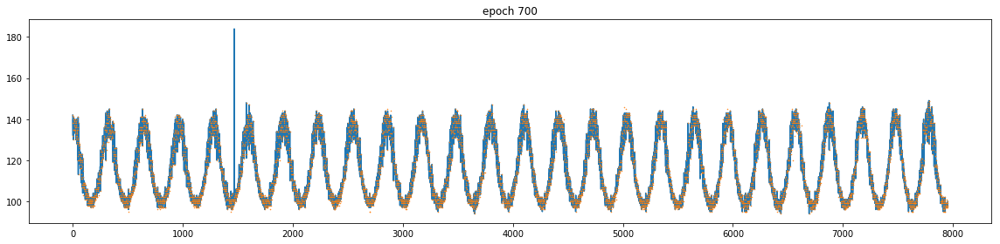

Checkpoint saved: checkpoint_epoch_mbh_batch_700_2018_07_27__10_42.pth
It took 0.07 seconds to save data file
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 710, loss 0.3796035349369049


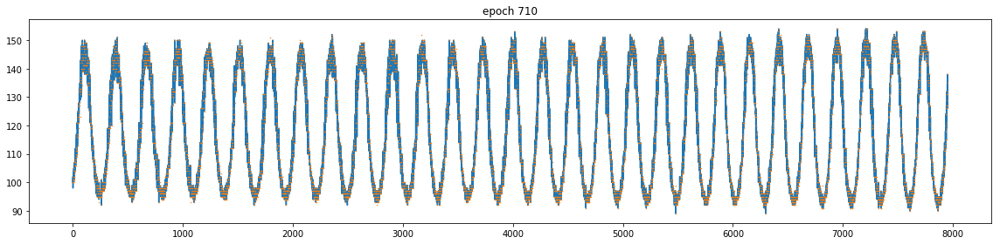

It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 720, loss 0.5853187441825867


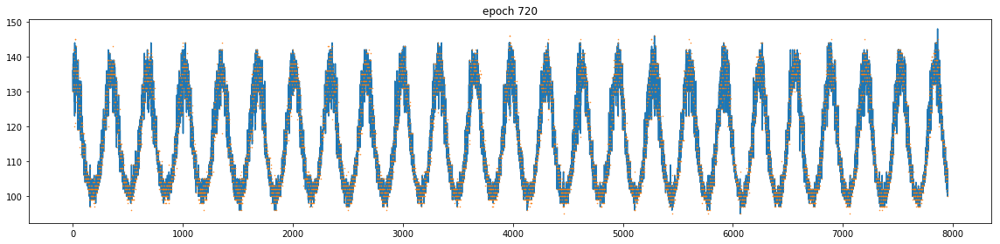

It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 730, loss 0.5823376774787903


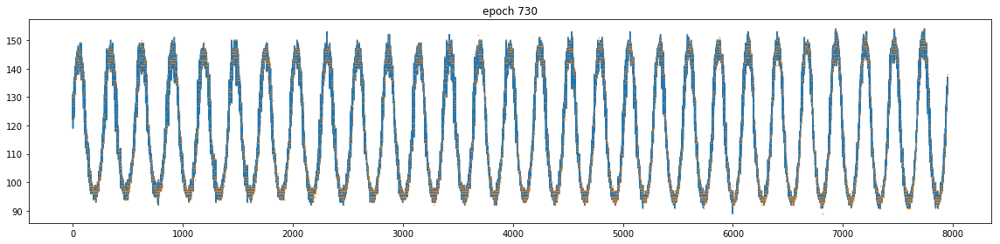

It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 740, loss 0.30470144748687744


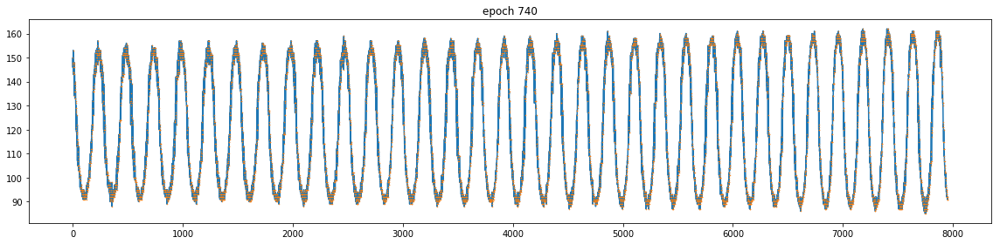

It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 750, loss 0.2667454183101654


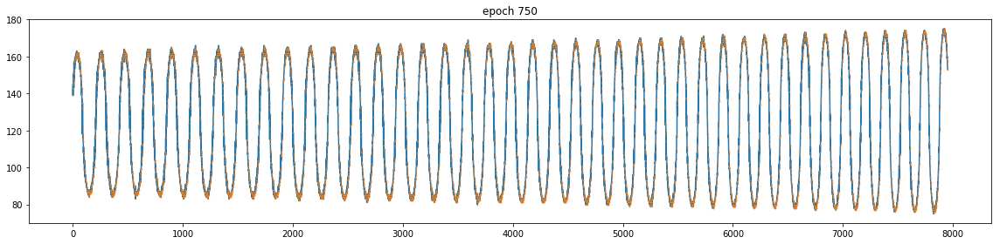

Checkpoint saved: checkpoint_epoch_mbh_batch_750_2018_07_27__10_43.pth
It took 0.06 seconds to save data file
It took 1.26 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 760, loss 0.2007492631673813


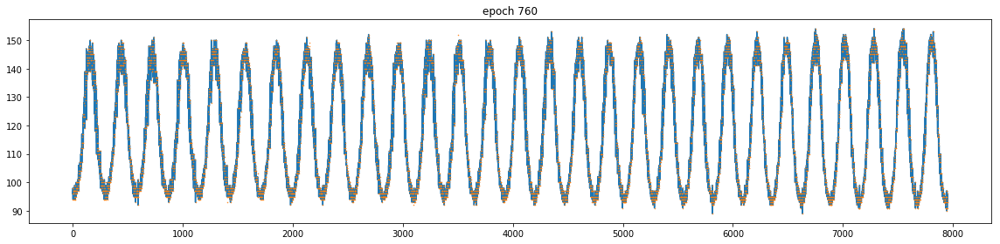

It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 770, loss 0.8488524556159973


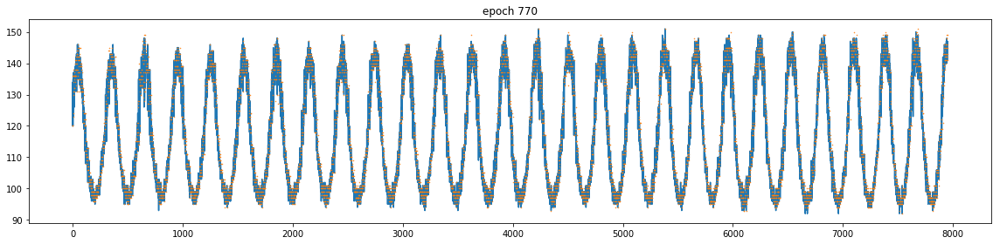

It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 780, loss 0.6932761073112488


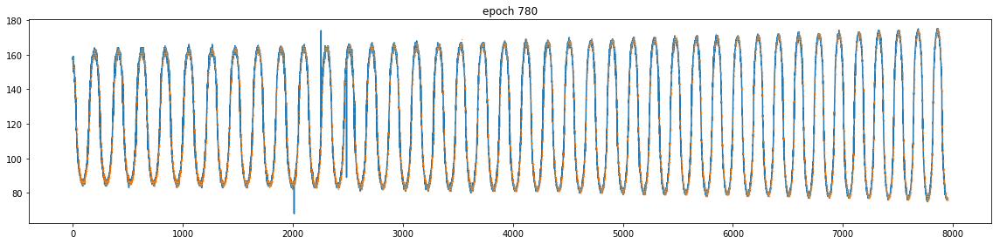

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 790, loss 0.3438183665275574


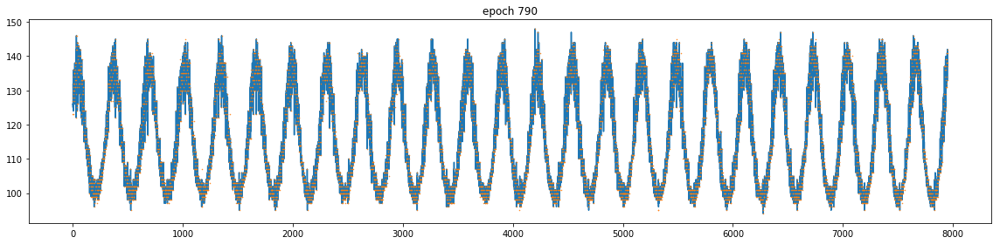

It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 800, loss 0.20153473317623138


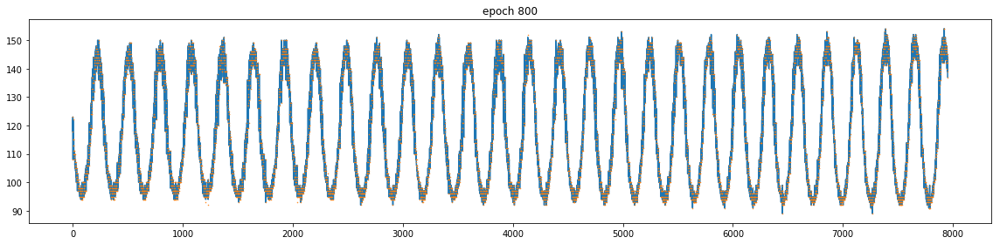

Checkpoint saved: checkpoint_epoch_mbh_batch_800_2018_07_27__10_44.pth
It took 0.11 seconds to save data file
It took 1.33 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
epoch 810, loss 0.19663159549236298


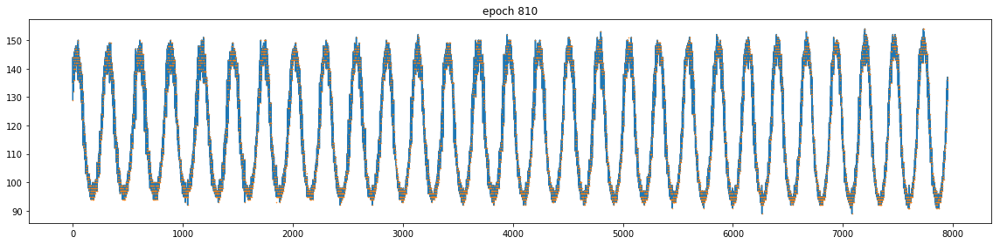

It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.34 seconds to finish an epoch
epoch 820, loss 0.14168444275856018


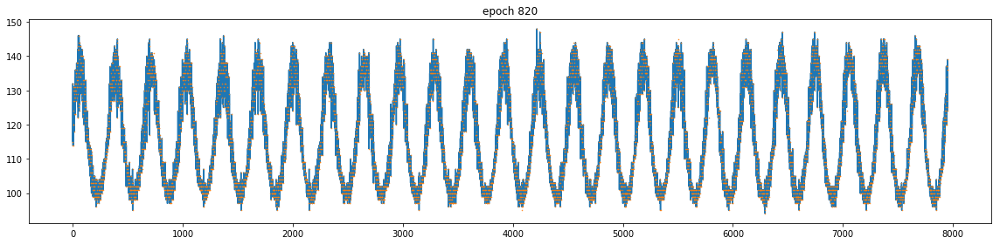

It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
epoch 830, loss 0.12508122622966766


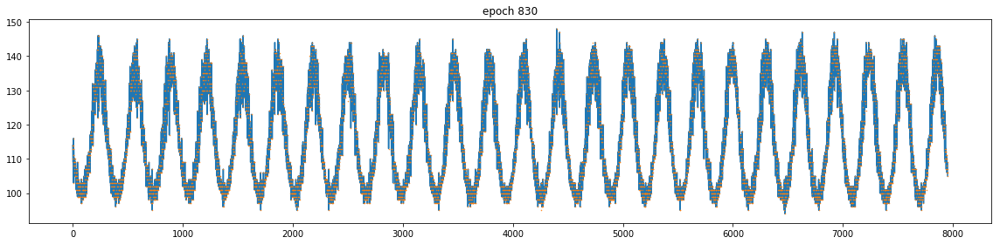

It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 840, loss 0.0815105214715004


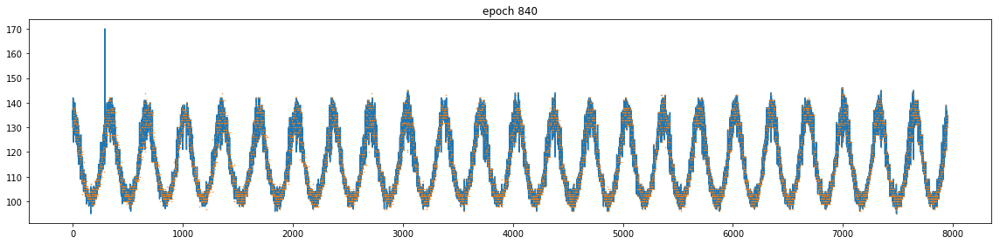

It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 850, loss 0.09795696288347244


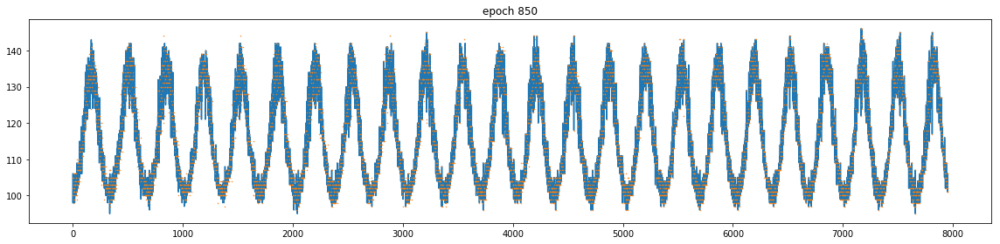

Checkpoint saved: checkpoint_epoch_mbh_batch_850_2018_07_27__10_45.pth
It took 0.06 seconds to save data file
It took 1.32 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
epoch 860, loss 3.174464225769043


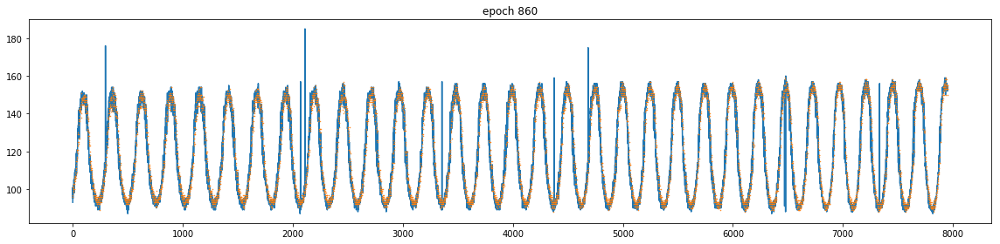

It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
epoch 870, loss 1.6666827201843262


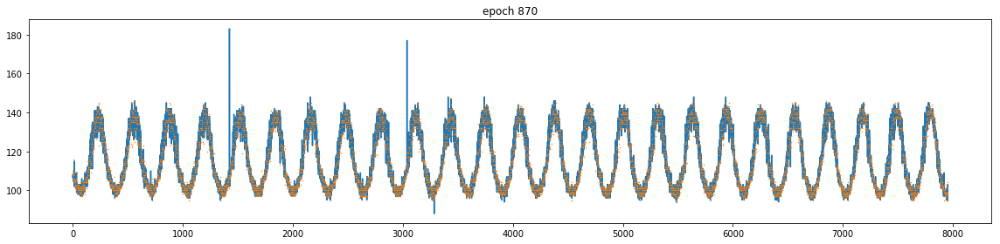

It took 1.31 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 880, loss 1.05021333694458


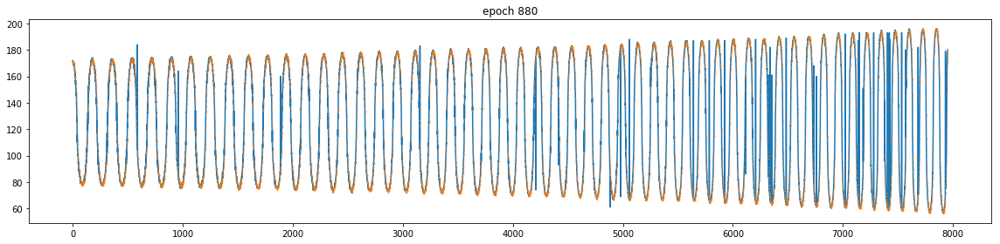

It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
epoch 890, loss 0.6235470771789551


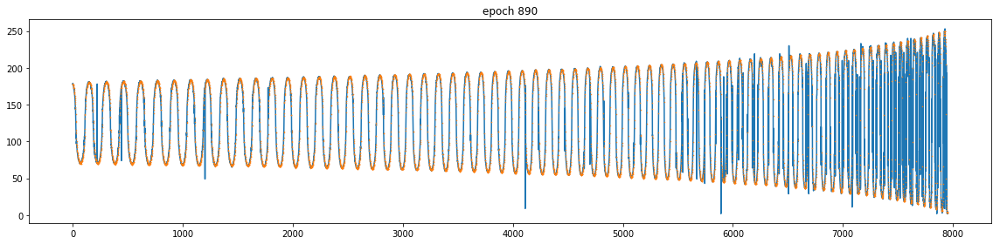

It took 1.31 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 900, loss 0.4139757454395294


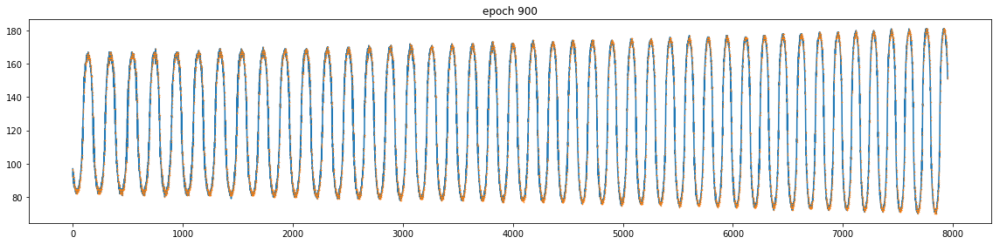

Checkpoint saved: checkpoint_epoch_mbh_batch_900_2018_07_27__10_46.pth
It took 0.06 seconds to save data file
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 910, loss 0.26480916142463684


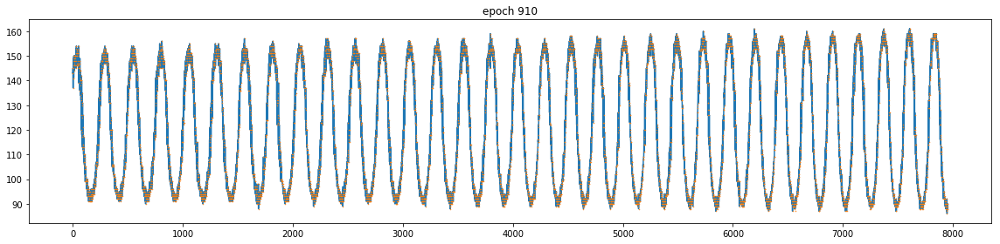

It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 920, loss 0.1999671906232834


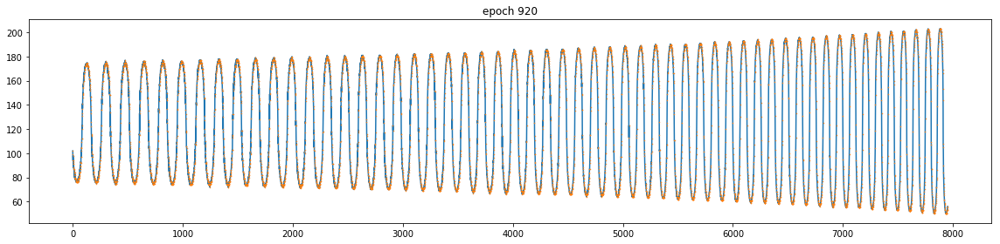

It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 930, loss 0.14930763840675354


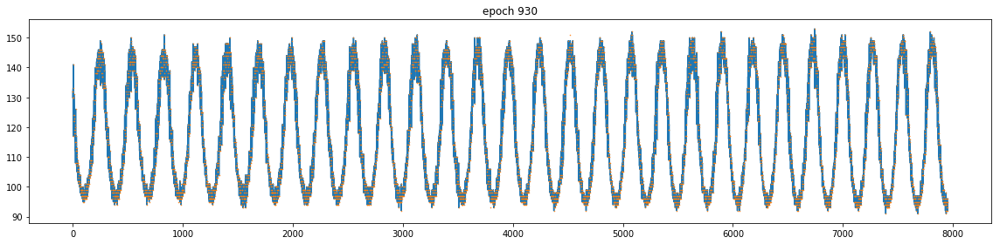

It took 1.34 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 940, loss 0.09594082087278366


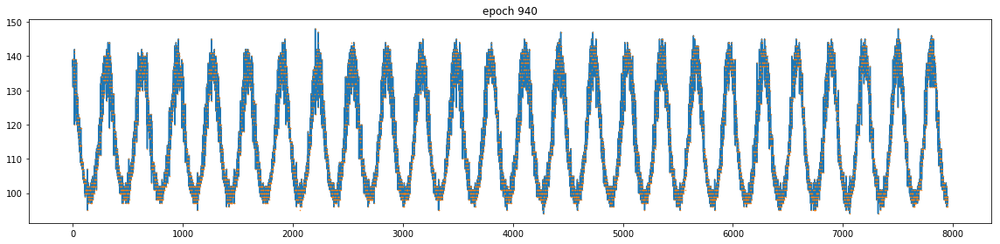

It took 1.34 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 950, loss 0.12288833409547806


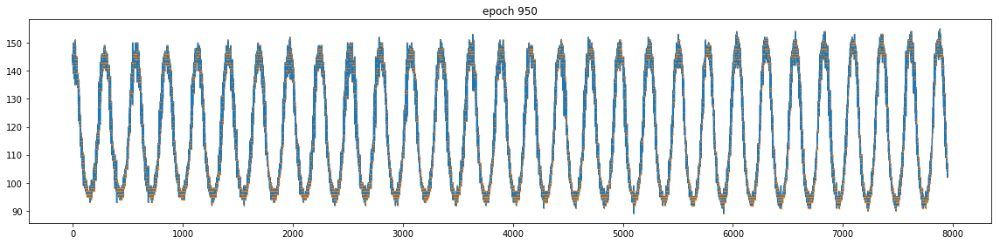

Checkpoint saved: checkpoint_epoch_mbh_batch_950_2018_07_27__10_47.pth
It took 0.06 seconds to save data file
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 960, loss 0.08255619555711746


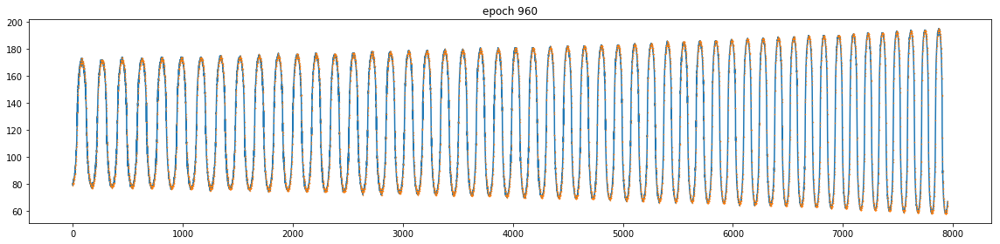

It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 970, loss 0.07241541892290115


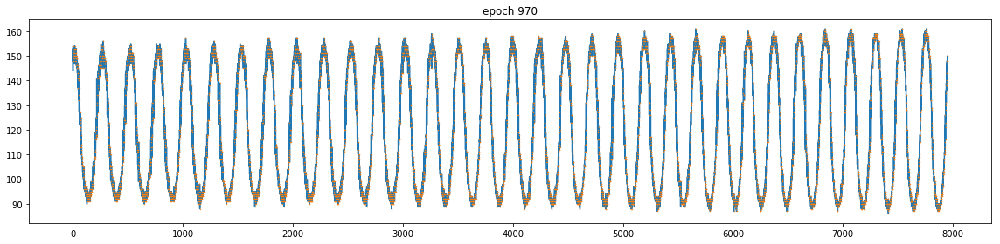

It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 980, loss 0.05594530701637268


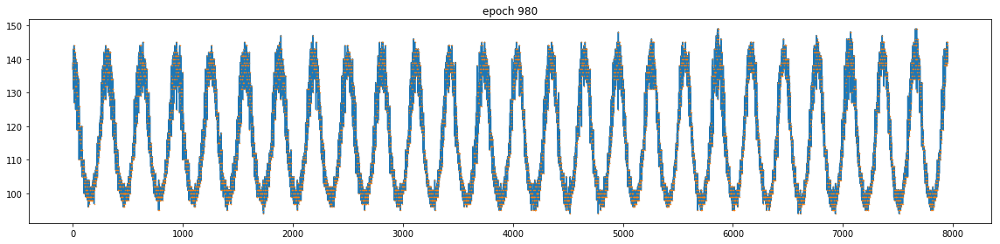

It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.35 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 990, loss 0.05301397293806076


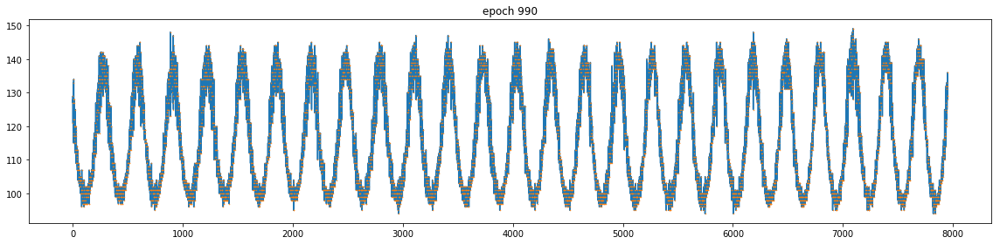

It took 1.32 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.35 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 1000, loss 0.06279260665178299


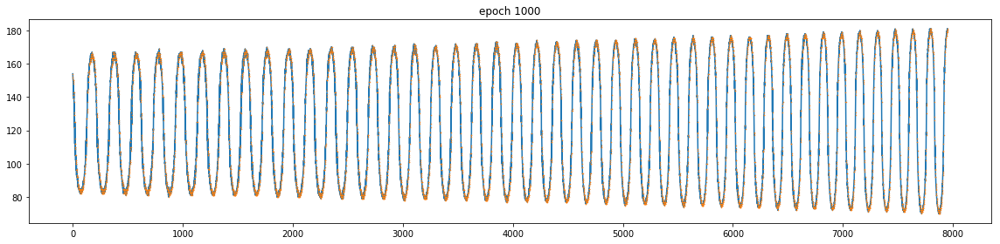

Checkpoint saved: checkpoint_epoch_mbh_batch_1000_2018_07_27__10_48.pth
It took 0.06 seconds to save data file
It took 1.31 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 1010, loss 0.0395282581448555


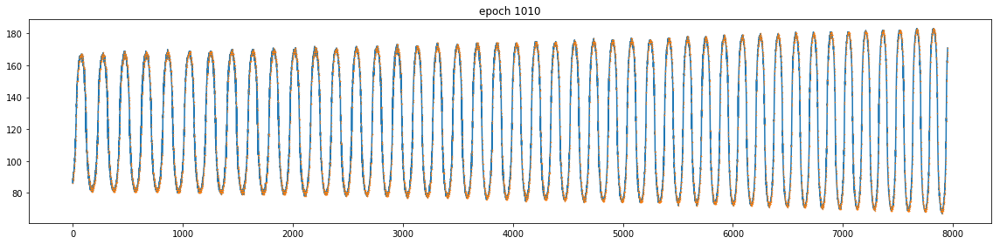

It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1020, loss 0.028861530125141144


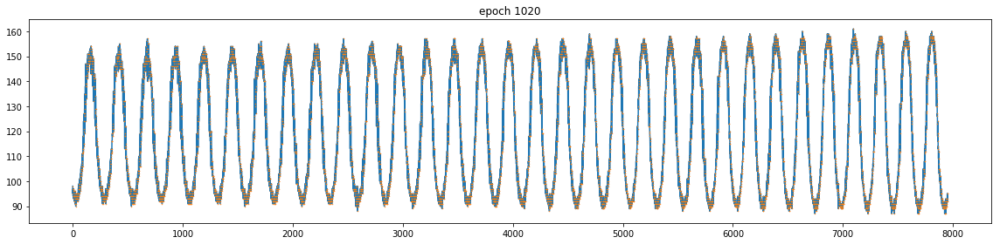

It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 1030, loss 0.043412912636995316


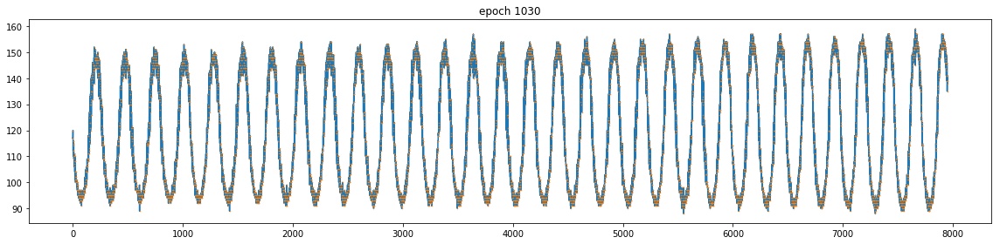

It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1040, loss 0.04506544768810272


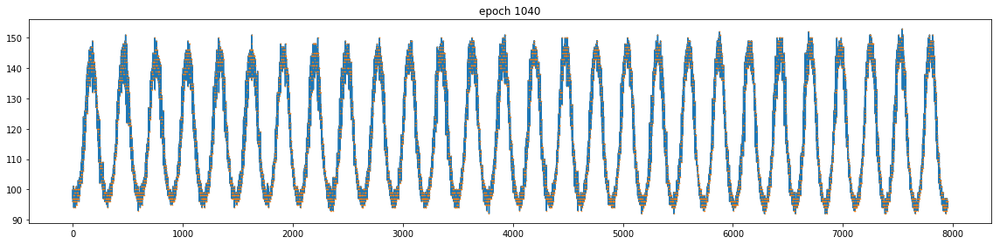

It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 1050, loss 1.9197386503219604


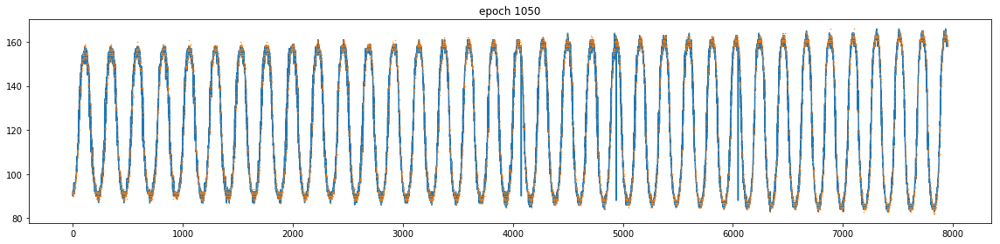

Checkpoint saved: checkpoint_epoch_mbh_batch_1050_2018_07_27__10_49.pth
It took 0.07 seconds to save data file
It took 1.31 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1060, loss 0.8768539428710938


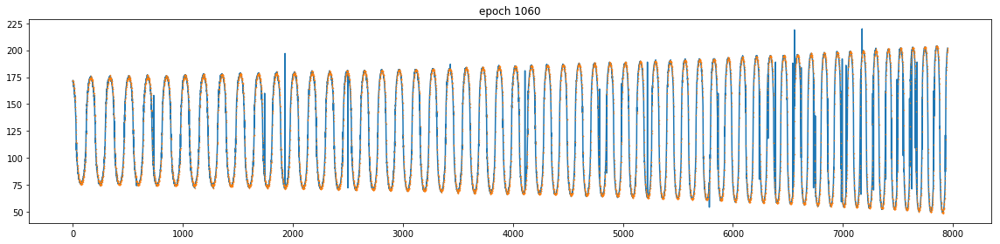

It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
epoch 1070, loss 0.4600136876106262


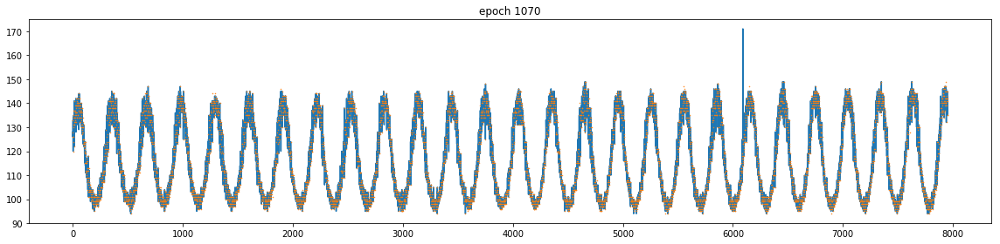

It took 1.30 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
epoch 1080, loss 0.27148503065109253


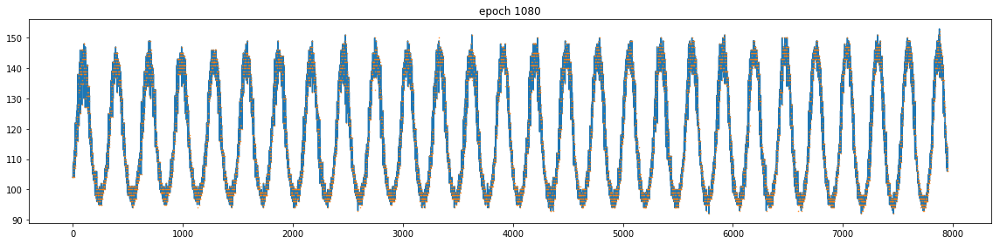

It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1090, loss 0.17343021929264069


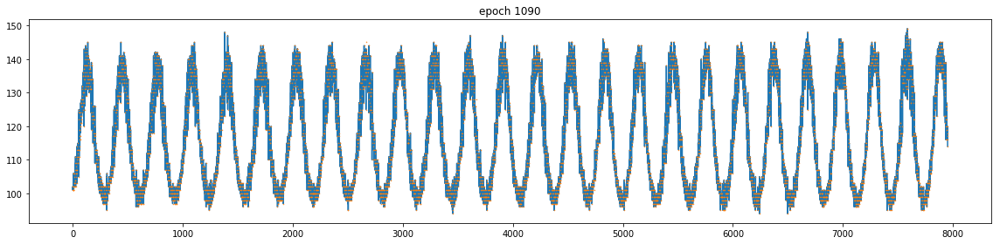

It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
epoch 1100, loss 0.12360953539609909


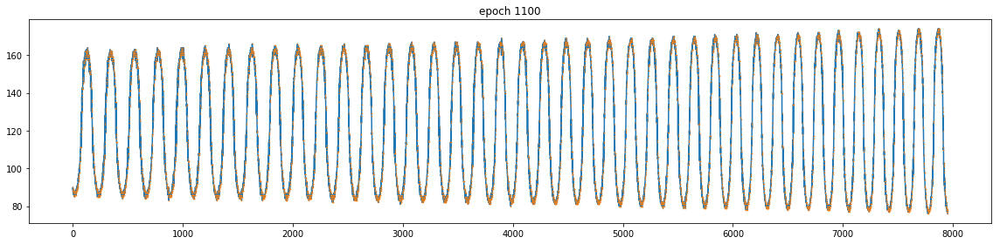

Checkpoint saved: checkpoint_epoch_mbh_batch_1100_2018_07_27__10_50.pth
It took 0.10 seconds to save data file
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
epoch 1110, loss 0.1013692170381546


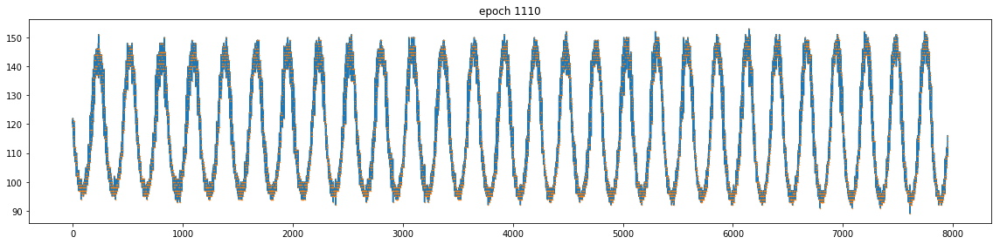

It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1120, loss 0.07325396686792374


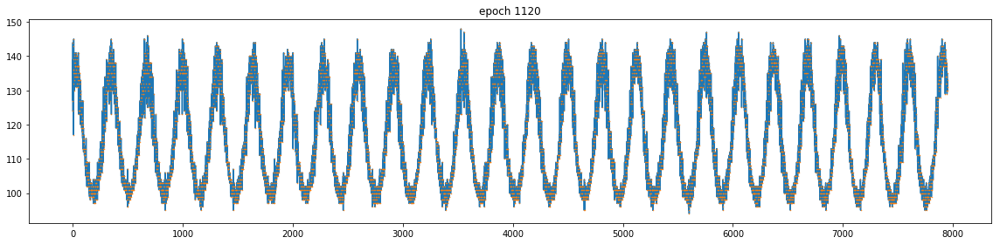

It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1130, loss 0.06383943557739258


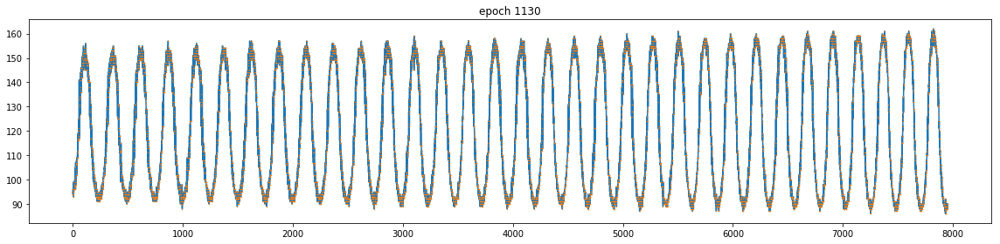

It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
epoch 1140, loss 0.06336909532546997


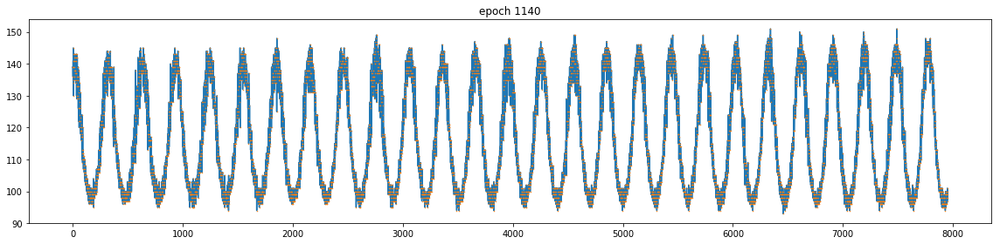

It took 1.30 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
epoch 1150, loss 0.031922634690999985


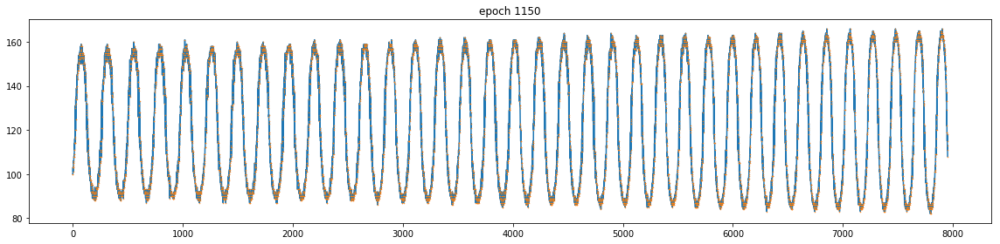

Checkpoint saved: checkpoint_epoch_mbh_batch_1150_2018_07_27__10_52.pth
It took 0.07 seconds to save data file
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1160, loss 0.03567333519458771


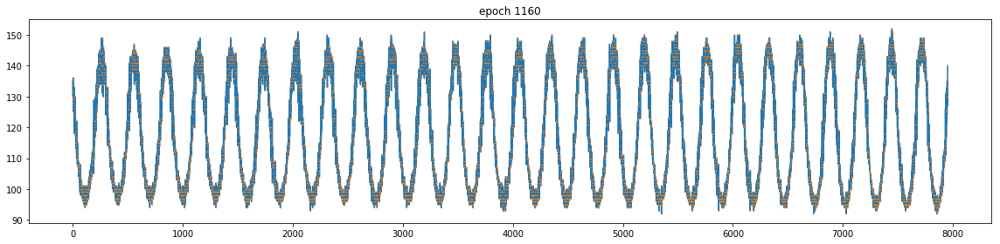

It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1170, loss 0.02158517949283123


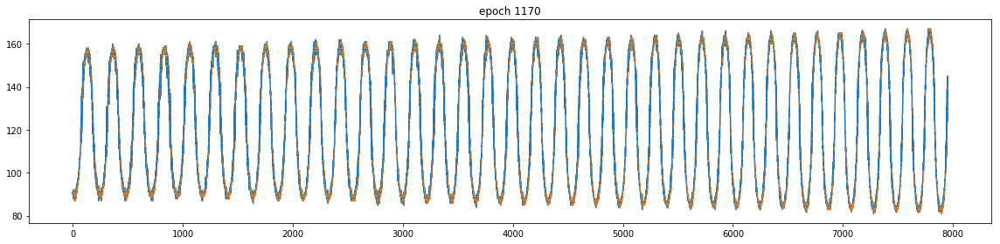

It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1180, loss 0.02595205046236515


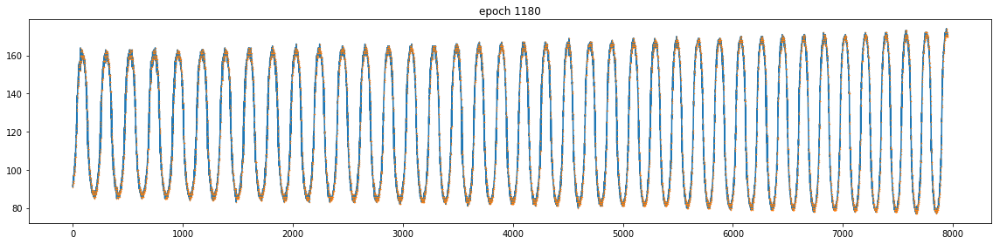

It took 1.30 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 1190, loss 0.04228036850690842


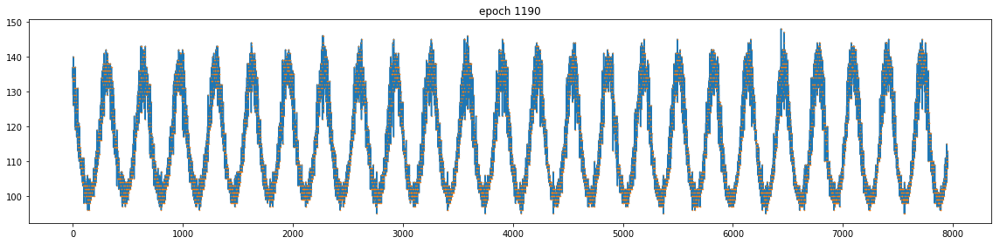

It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1200, loss 0.021364664658904076


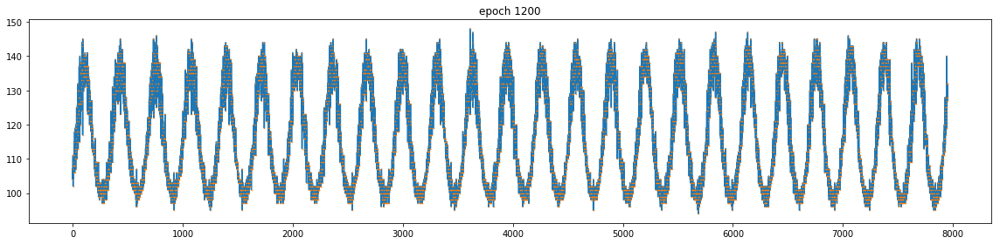

Checkpoint saved: checkpoint_epoch_mbh_batch_1200_2018_07_27__10_53.pth
It took 0.08 seconds to save data file
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1210, loss 0.020595921203494072


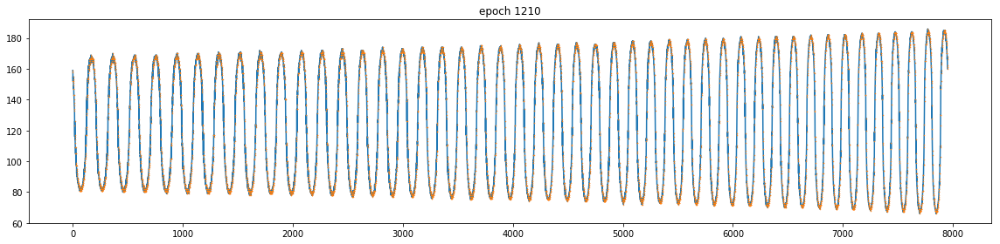

It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1220, loss 0.027663523331284523


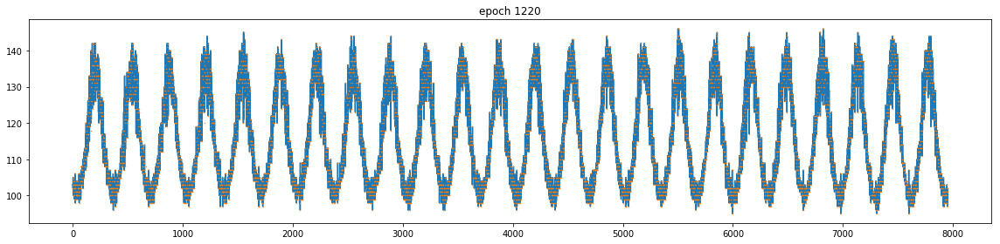

It took 1.30 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
epoch 1230, loss 0.020574958994984627


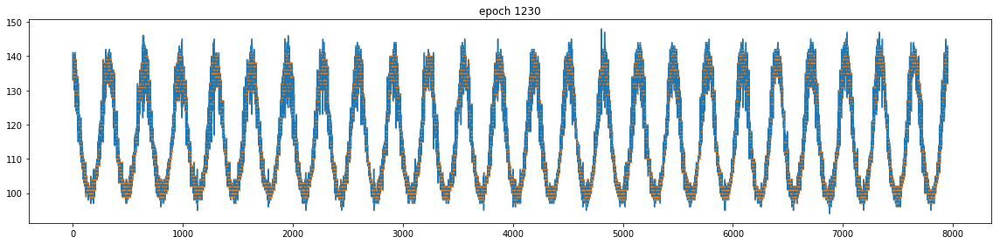

It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1240, loss 0.016381802037358284


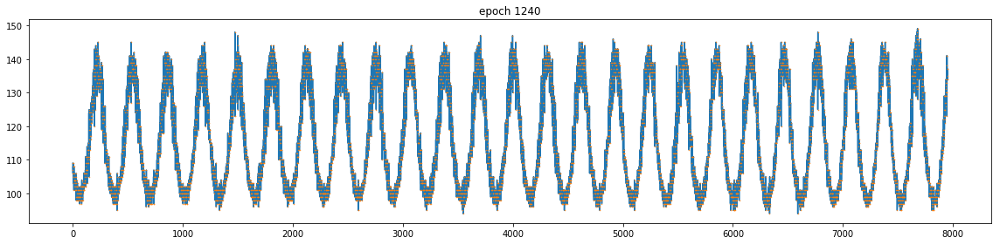

It took 1.32 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.36 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
epoch 1250, loss 0.011009268462657928


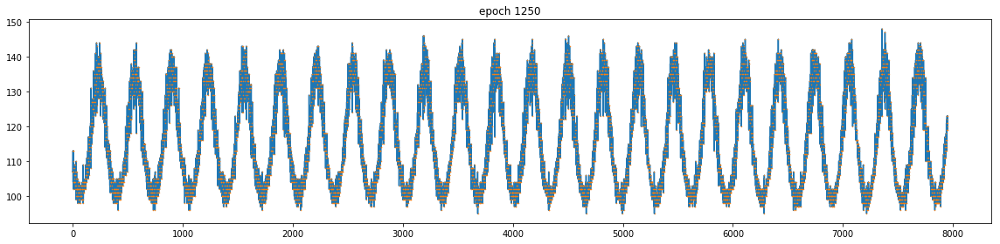

Checkpoint saved: checkpoint_epoch_mbh_batch_1250_2018_07_27__10_54.pth
It took 0.07 seconds to save data file
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1260, loss 0.015577597543597221


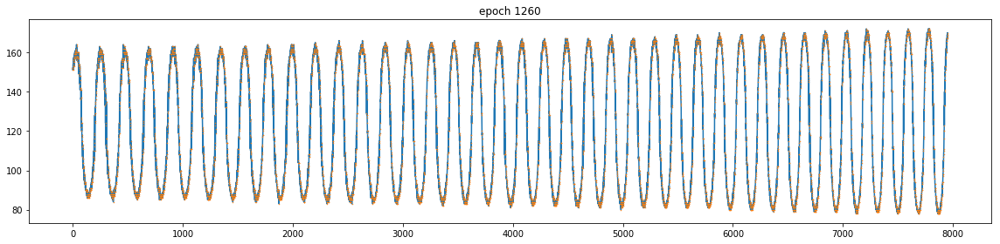

It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1270, loss 0.011146868579089642


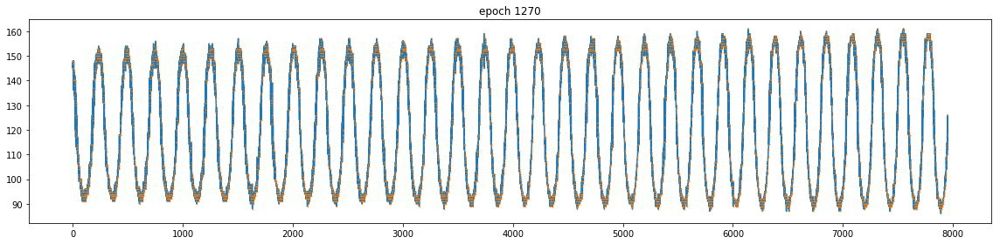

It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 1280, loss 0.014411543495953083


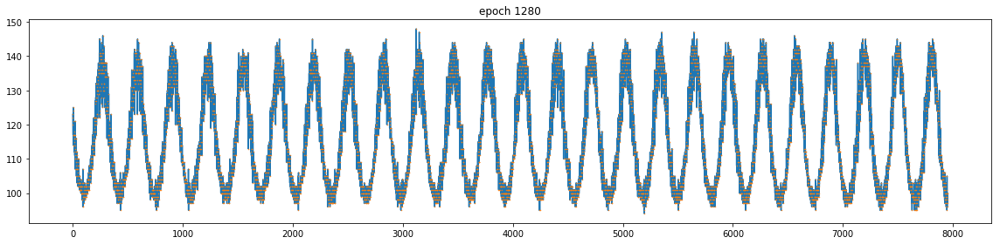

It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
epoch 1290, loss 0.012525822967290878


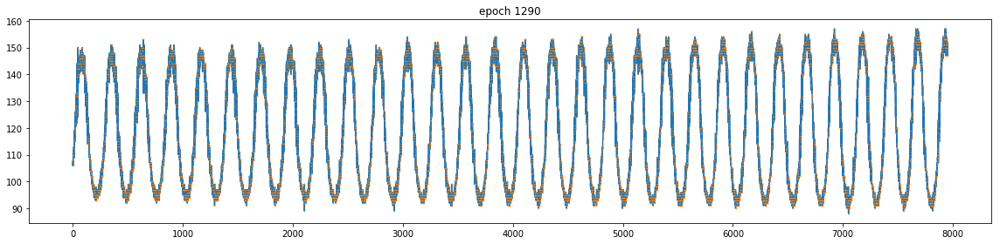

It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
epoch 1300, loss 0.00930743757635355


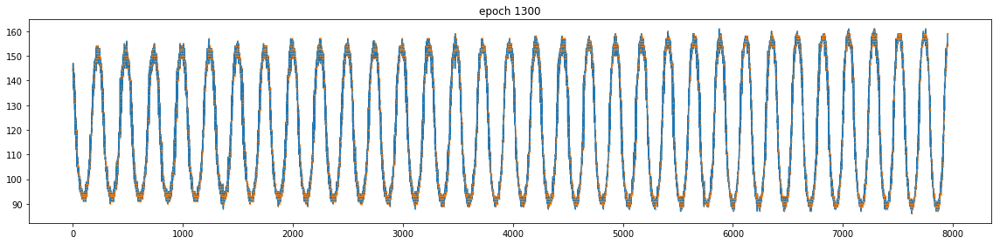

Checkpoint saved: checkpoint_epoch_mbh_batch_1300_2018_07_27__10_55.pth
It took 0.08 seconds to save data file
It took 1.30 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.34 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1310, loss 0.008078308776021004


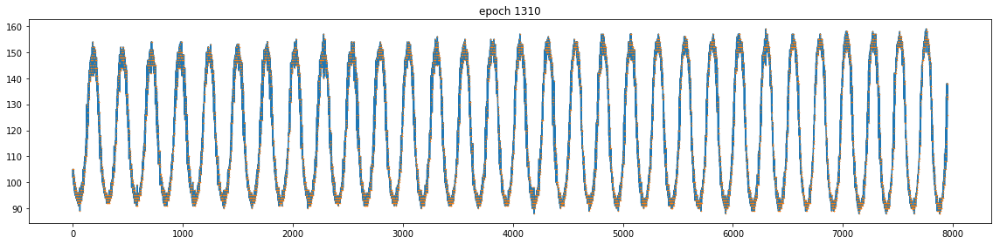

It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 1320, loss 0.008961026556789875


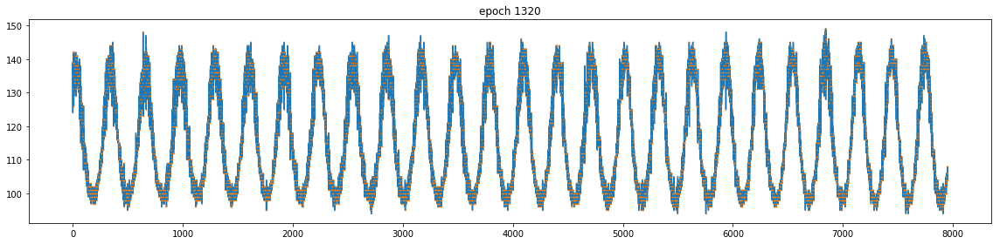

It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1330, loss 0.01254101749509573


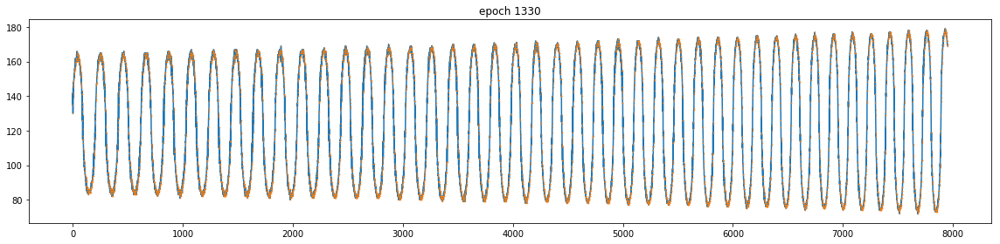

It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1340, loss 0.006738563999533653


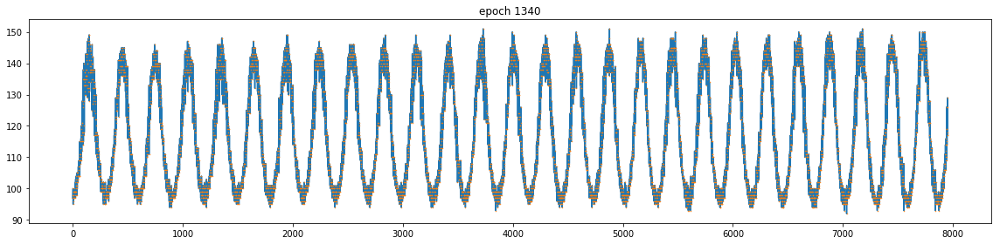

It took 1.32 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 1350, loss 0.00640106713399291


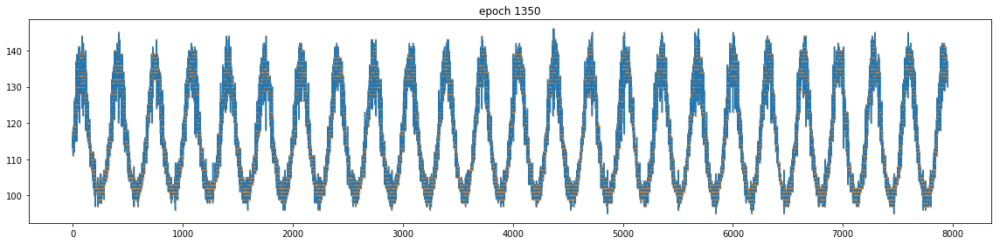

Checkpoint saved: checkpoint_epoch_mbh_batch_1350_2018_07_27__10_56.pth
It took 0.08 seconds to save data file
It took 1.30 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1360, loss 0.006884436123073101


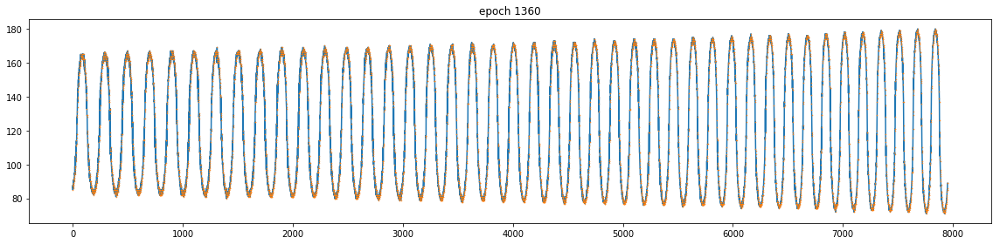

It took 1.27 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 1370, loss 0.007341149728745222


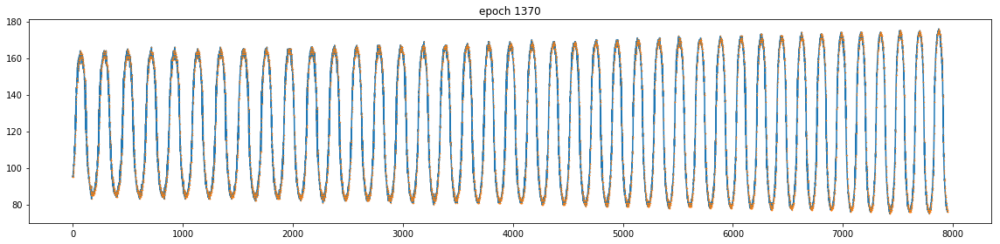

It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.34 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
epoch 1380, loss 0.01128111220896244


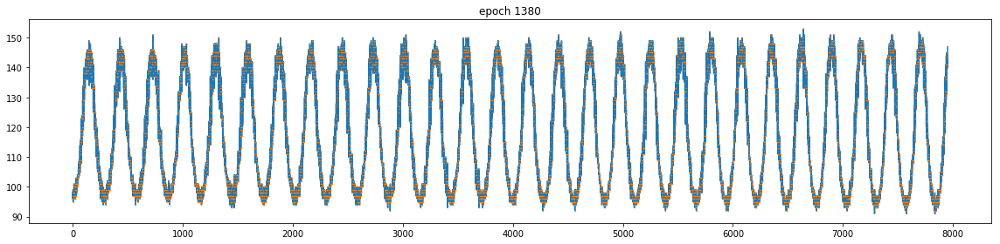

It took 1.31 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 1390, loss 0.007222286891192198


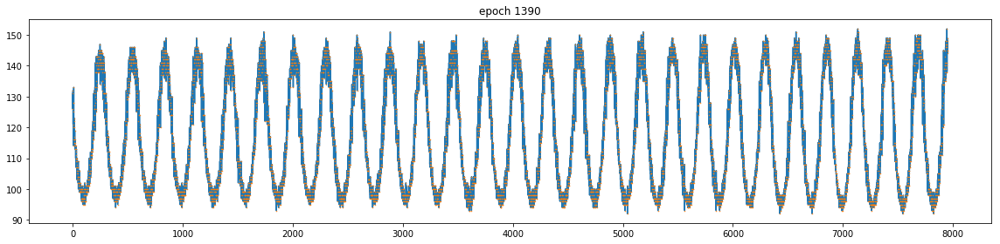

It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1400, loss 0.005371216684579849


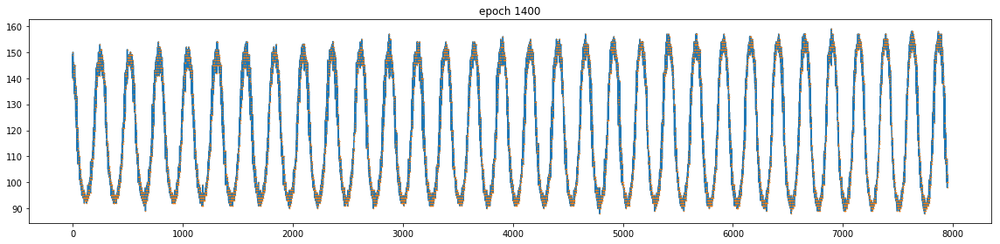

Checkpoint saved: checkpoint_epoch_mbh_batch_1400_2018_07_27__10_57.pth
It took 0.13 seconds to save data file
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1410, loss 0.00512170884758234


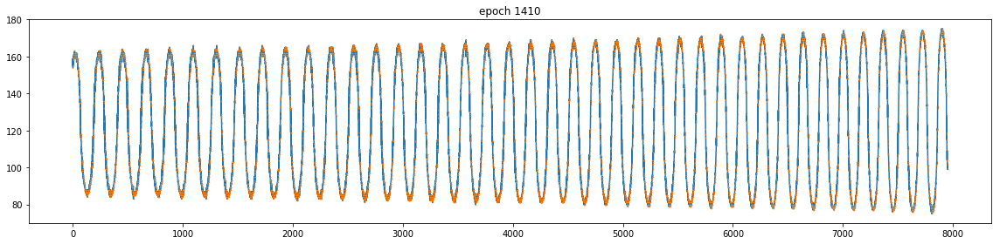

It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1420, loss 0.008036221377551556


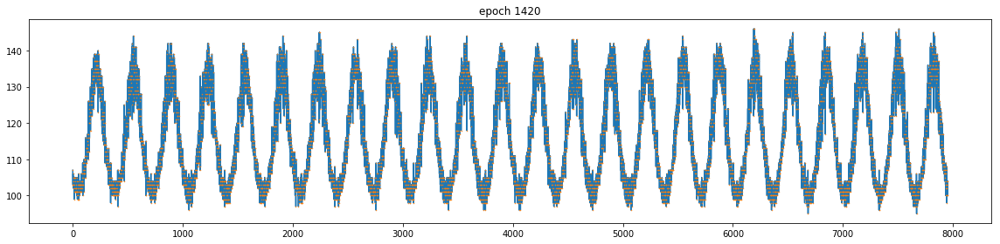

It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 1430, loss 0.005202064756304026


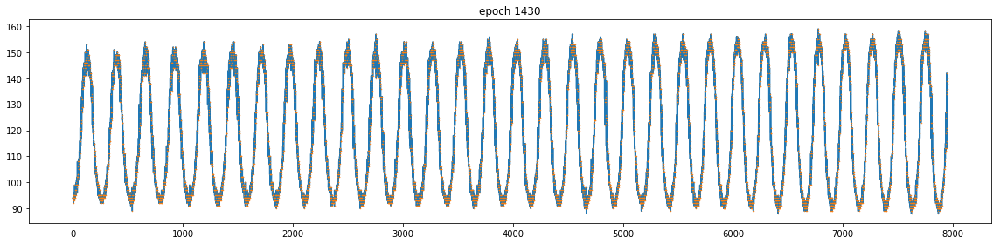

It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 1440, loss 0.009000382386147976


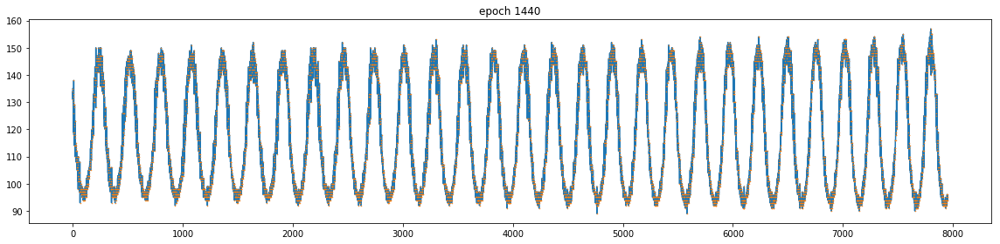

It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 1450, loss 0.004708926193416119


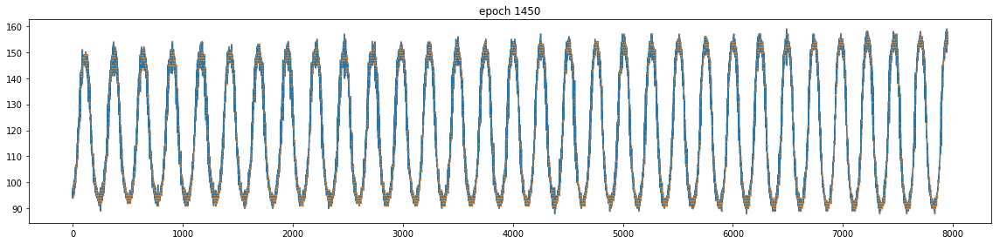

Checkpoint saved: checkpoint_epoch_mbh_batch_1450_2018_07_27__10_58.pth
It took 0.08 seconds to save data file
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 1460, loss 0.004805578850209713


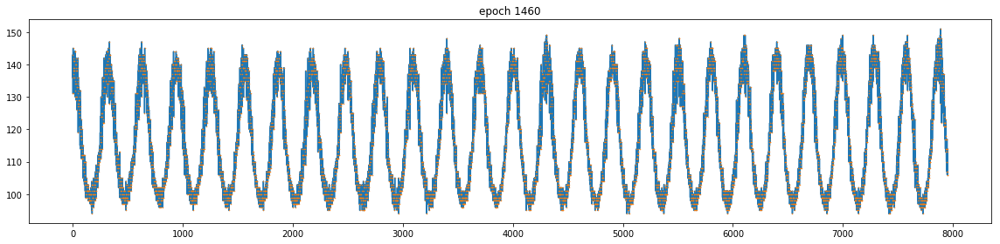

It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 1470, loss 0.004296449013054371


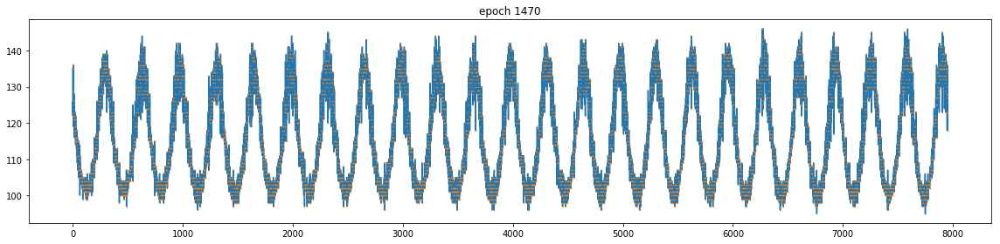

It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1480, loss 0.004167079459875822


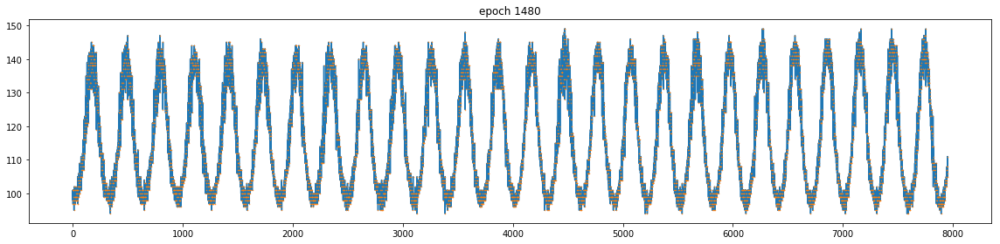

It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 1490, loss 0.008240838535130024


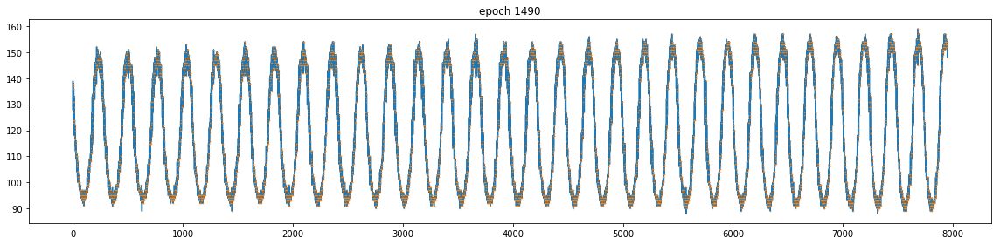

It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1500, loss 0.005234525538980961


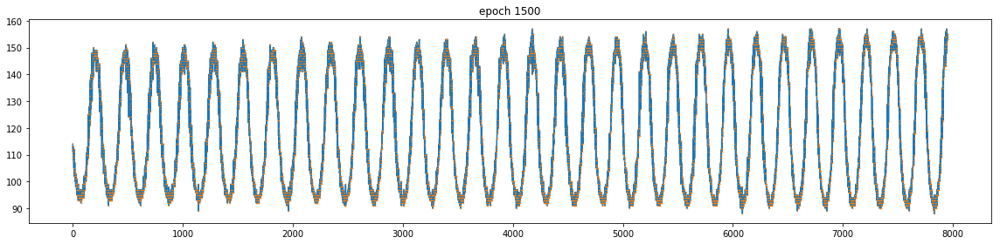

Checkpoint saved: checkpoint_epoch_mbh_batch_1500_2018_07_27__10_59.pth
It took 0.08 seconds to save data file
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1510, loss 0.004378418903797865


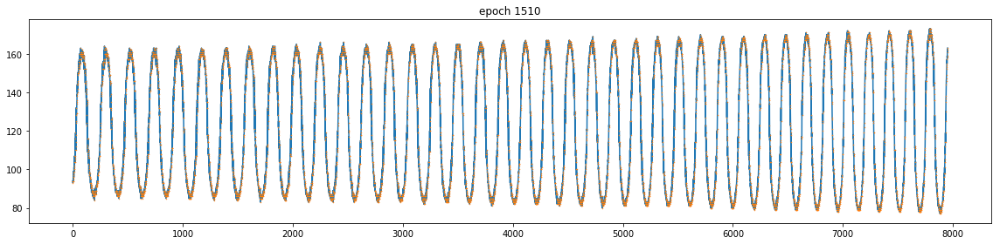

It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 1520, loss 0.004718488547950983


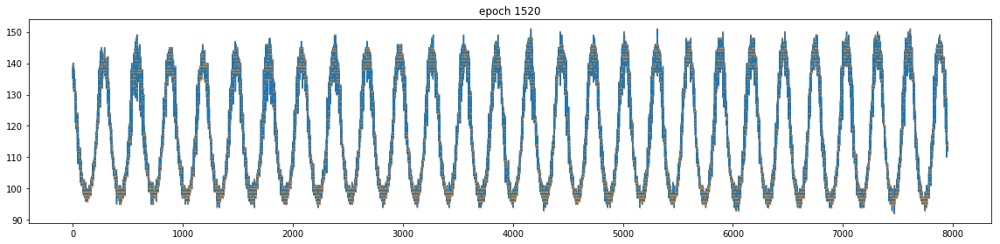

It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 1530, loss 0.005972245242446661


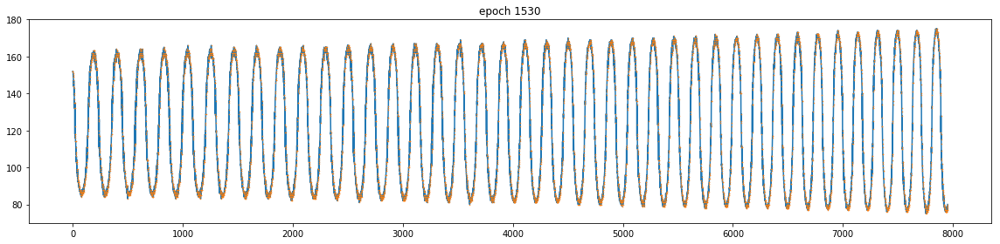

It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 1540, loss 0.004764325451105833


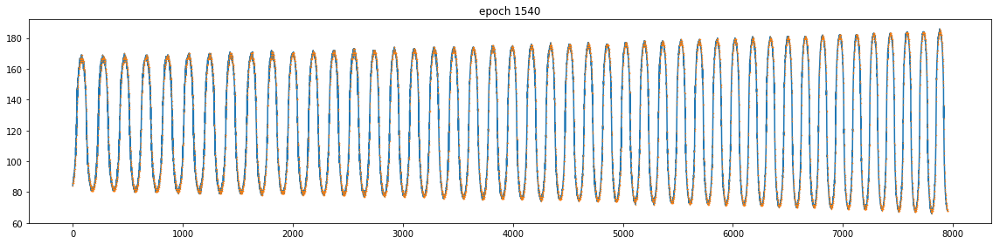

It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 1550, loss 0.004715631250292063


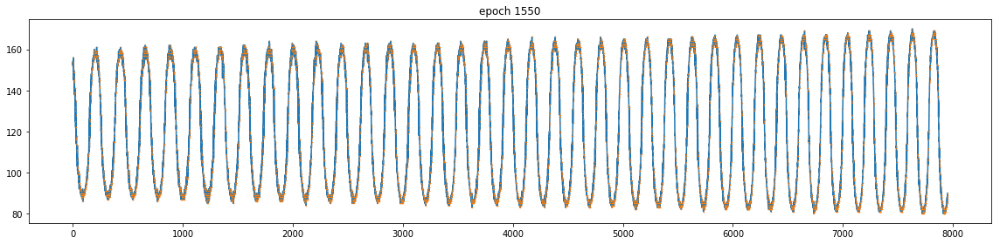

Checkpoint saved: checkpoint_epoch_mbh_batch_1550_2018_07_27__11_00.pth
It took 0.08 seconds to save data file
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 1560, loss 0.00359429232776165


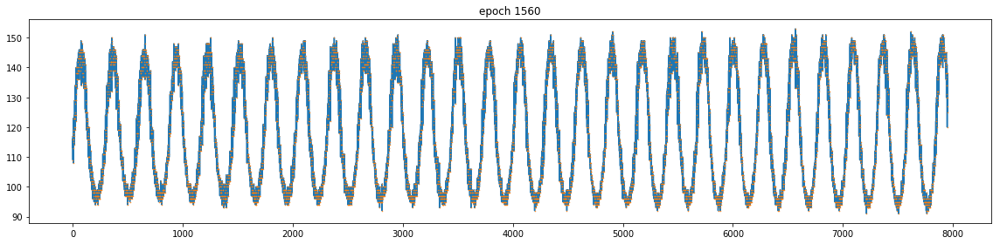

It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1570, loss 0.003300365526229143


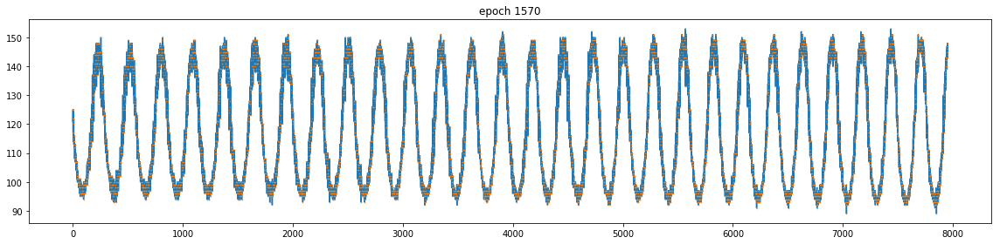

It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1580, loss 0.0027130271773785353


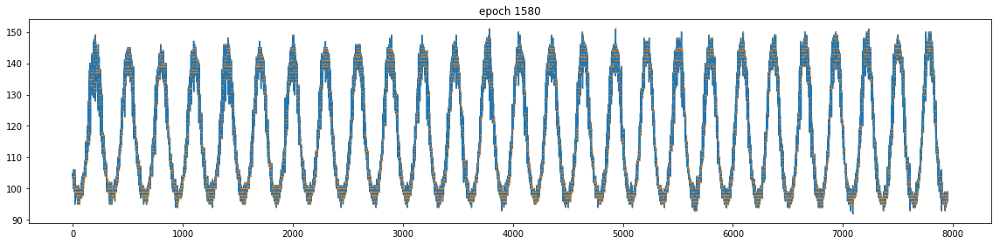

It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 1590, loss 0.0027069104835391045


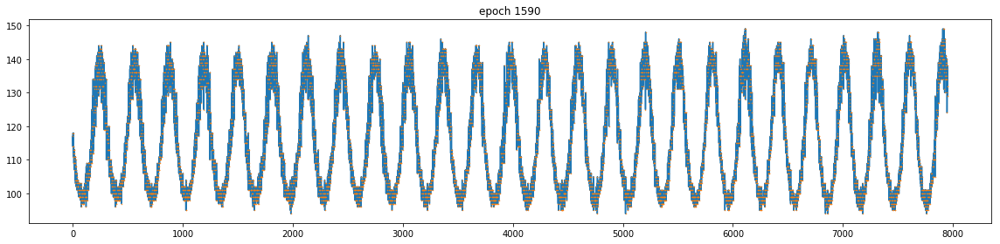

It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1600, loss 0.002860712120309472


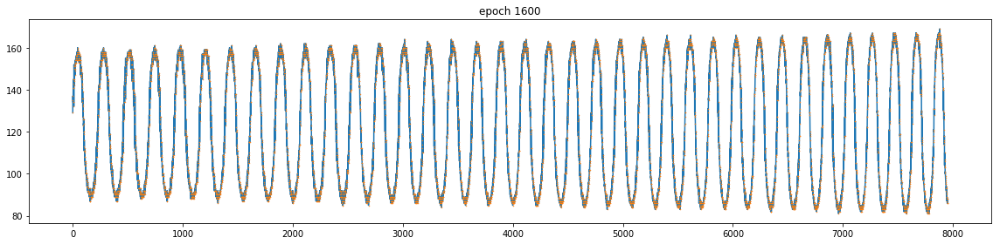

Checkpoint saved: checkpoint_epoch_mbh_batch_1600_2018_07_27__11_01.pth
It took 0.08 seconds to save data file
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1610, loss 0.002661129692569375


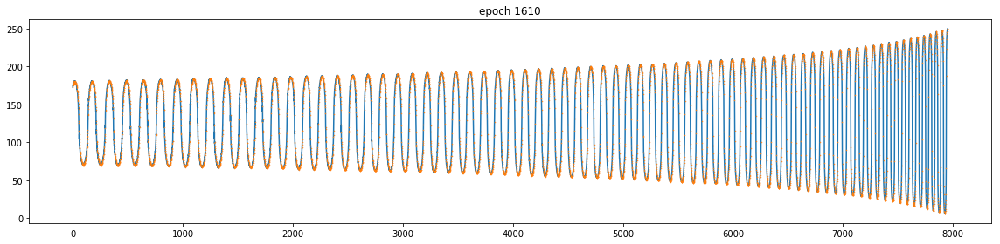

It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 1620, loss 0.004611496813595295


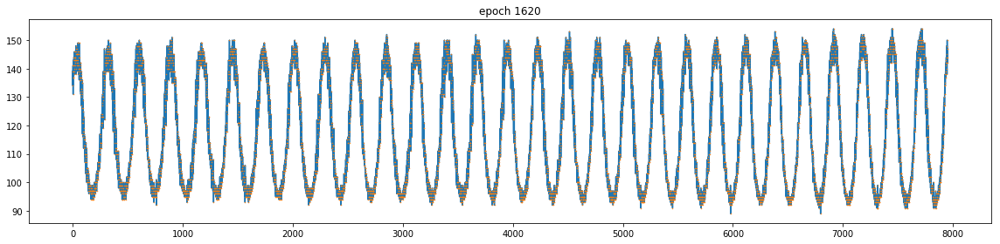

It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 1630, loss 0.004424400627613068


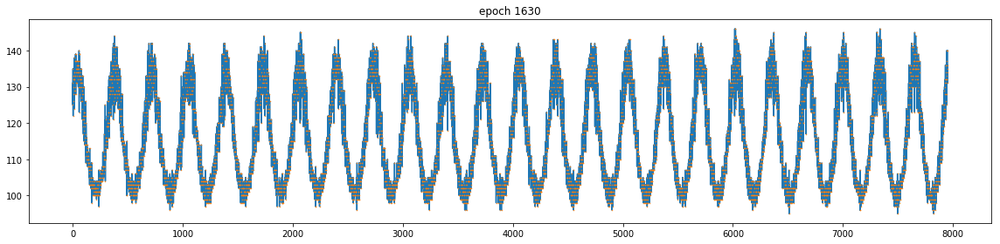

It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
epoch 1640, loss 0.0026151768397539854


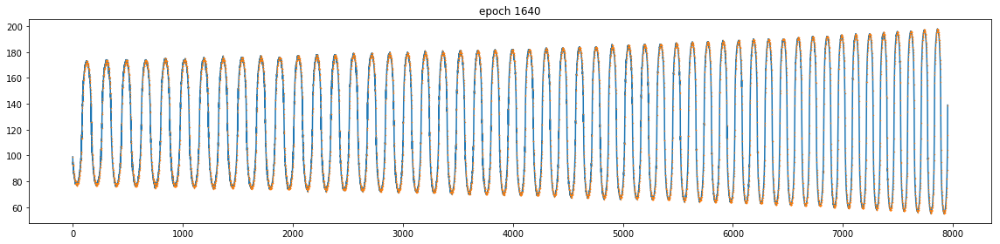

It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1650, loss 0.009030865505337715


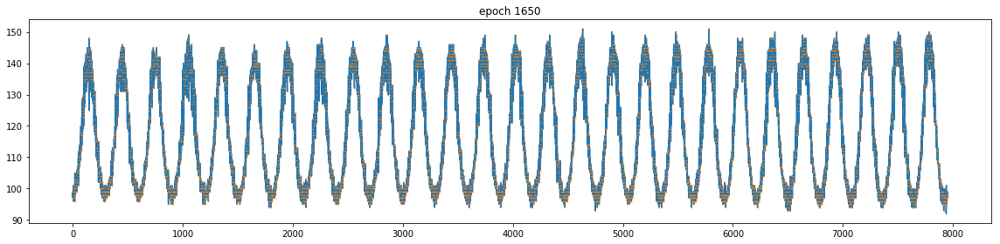

Checkpoint saved: checkpoint_epoch_mbh_batch_1650_2018_07_27__11_02.pth
It took 0.09 seconds to save data file
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 1660, loss 0.004694546572864056


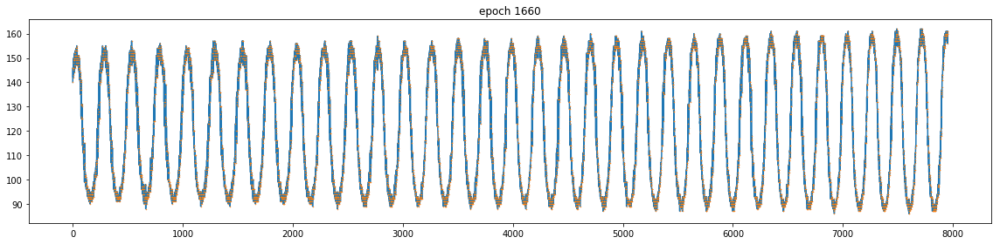

It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 1670, loss 0.0022787656635046005


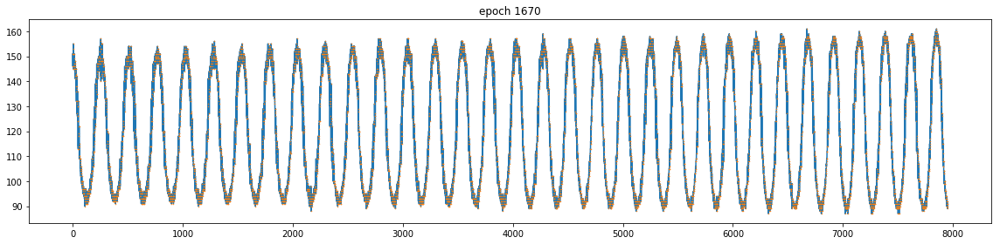

It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1680, loss 0.003664460964500904


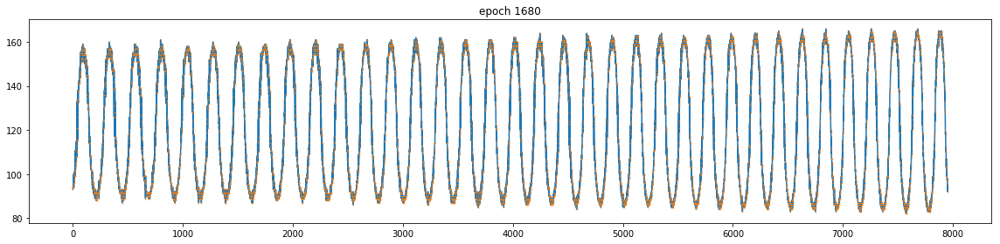

It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 1690, loss 0.0022651462350040674


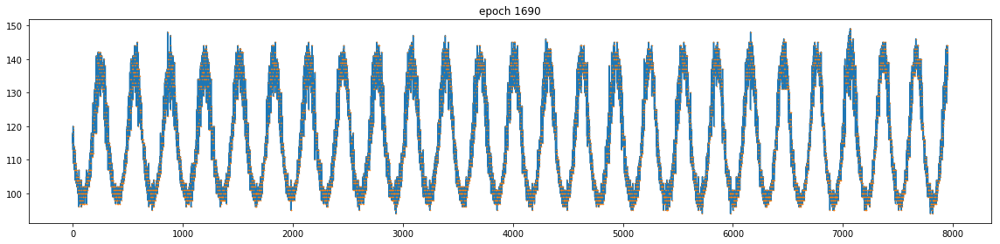

It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
epoch 1700, loss 0.0029777854215353727


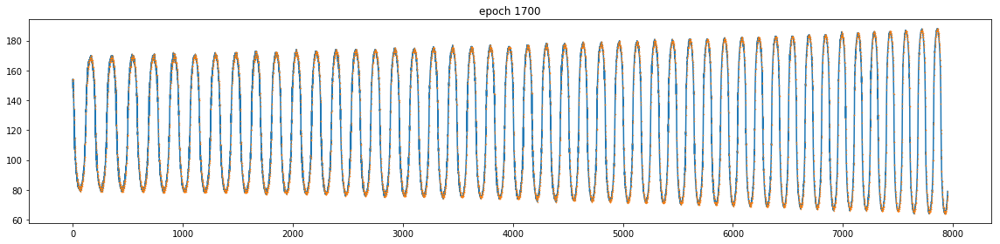

Checkpoint saved: checkpoint_epoch_mbh_batch_1700_2018_07_27__11_04.pth
It took 0.09 seconds to save data file
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 1710, loss 0.002171705476939678


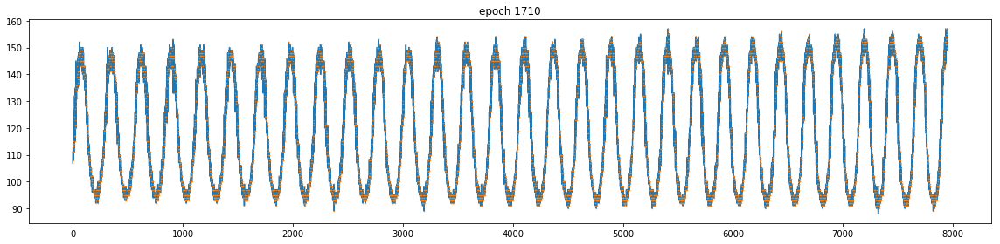

It took 1.27 seconds to finish an epoch
It took 1.35 seconds to finish an epoch
It took 1.39 seconds to finish an epoch
It took 1.37 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.33 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1720, loss 0.002706374041736126


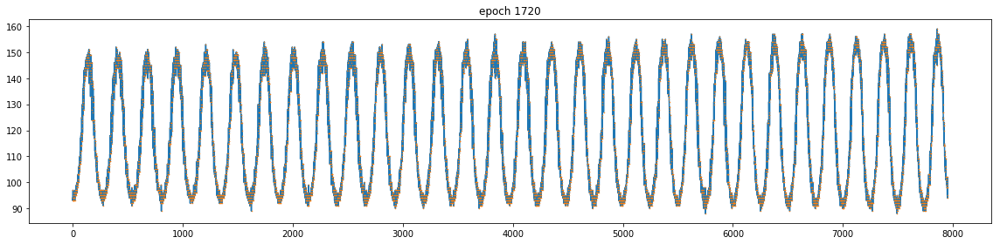

It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1730, loss 0.0022439511958509684


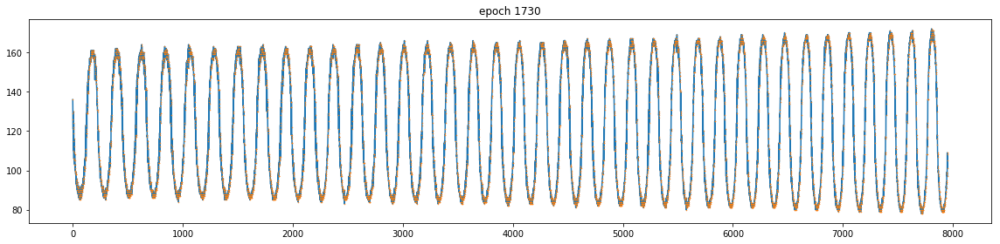

It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
epoch 1740, loss 0.0019328523194417357


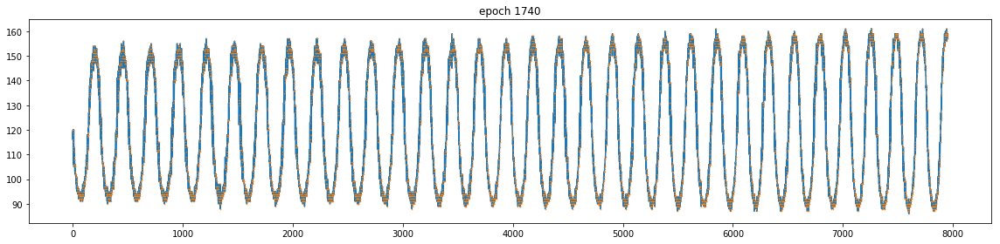

It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
epoch 1750, loss 0.003239754820242524


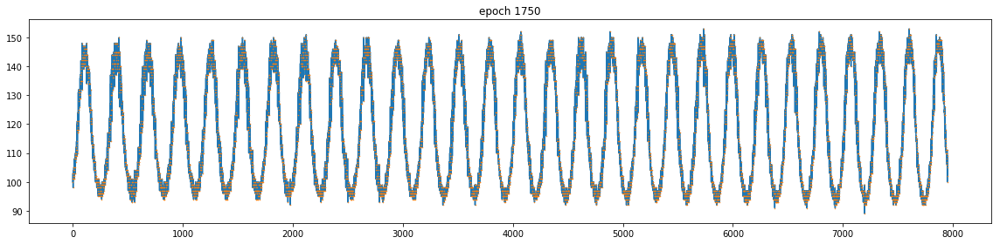

Checkpoint saved: checkpoint_epoch_mbh_batch_1750_2018_07_27__11_05.pth
It took 0.09 seconds to save data file
It took 1.30 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.34 seconds to finish an epoch
It took 1.31 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 1760, loss 0.001998481573536992


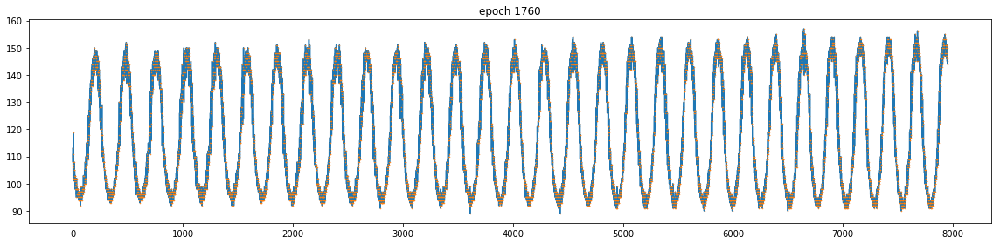

It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
epoch 1770, loss 0.00197381479665637


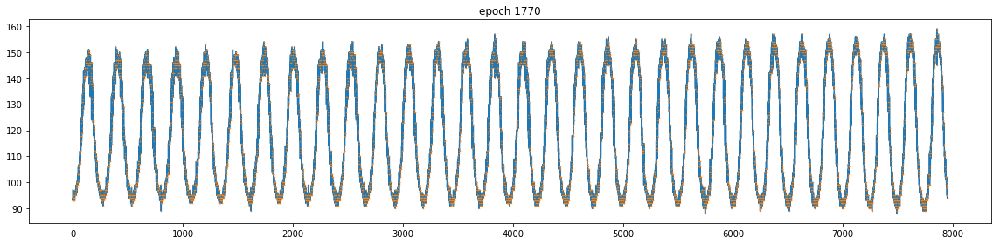

It took 1.26 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.32 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
epoch 1780, loss 0.0022079143673181534


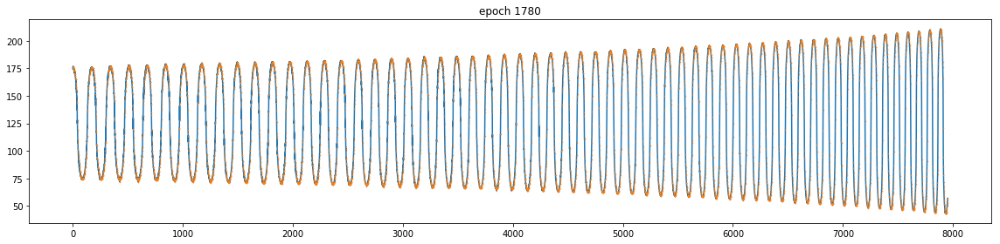

It took 1.25 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 1790, loss 0.0026999132242053747


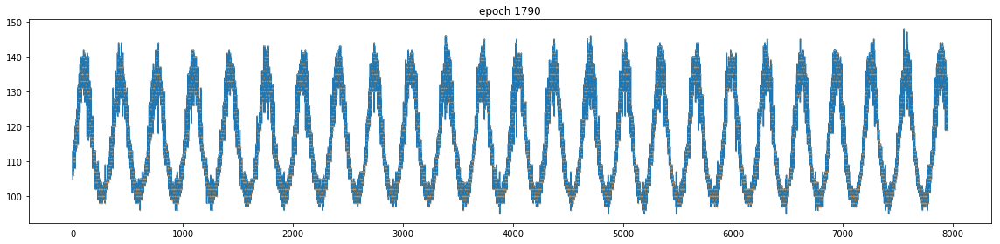

It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 1800, loss 0.002968382788822055


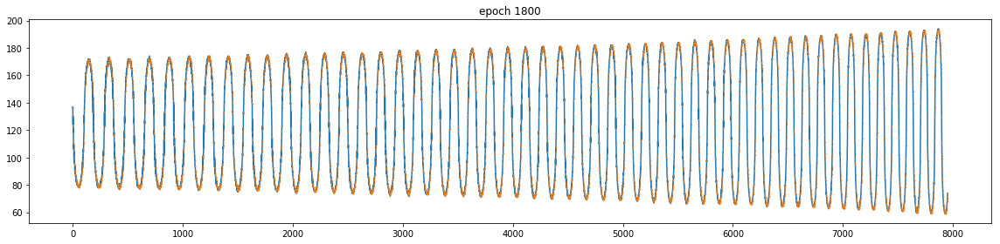

Checkpoint saved: checkpoint_epoch_mbh_batch_1800_2018_07_27__11_06.pth
It took 0.08 seconds to save data file
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
epoch 1810, loss 0.001993786543607712


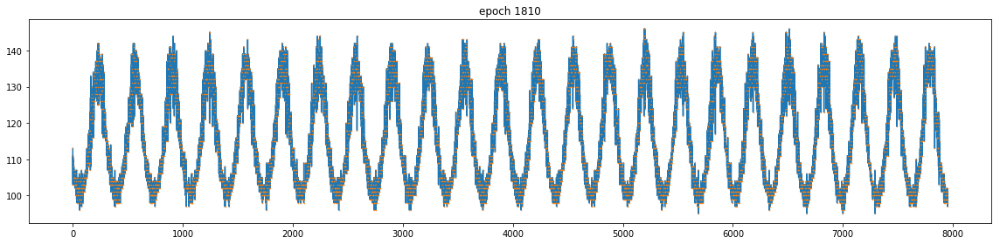

It took 1.25 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 1820, loss 0.0018909951904788613


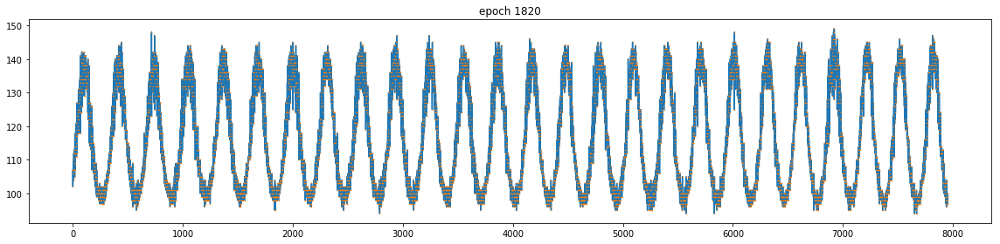

It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
epoch 1830, loss 0.0019257739186286926


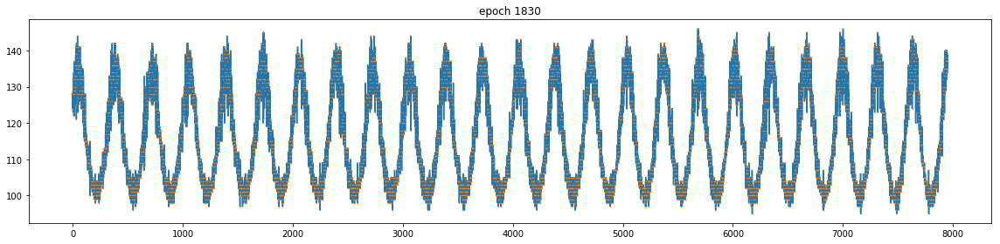

It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 1840, loss 0.0014211061643436551


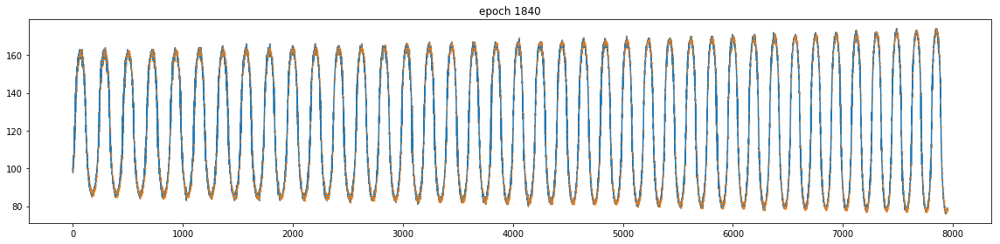

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 1850, loss 0.0015144937206059694


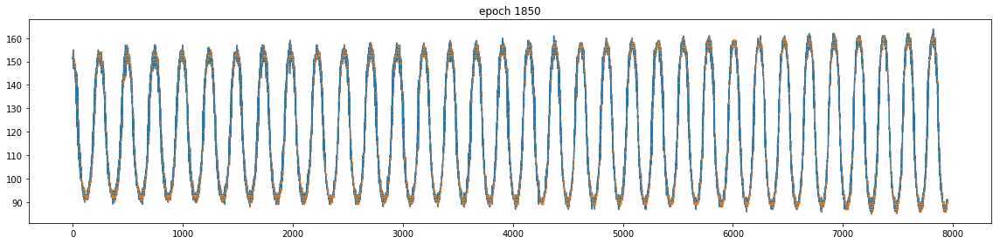

Checkpoint saved: checkpoint_epoch_mbh_batch_1850_2018_07_27__11_07.pth
It took 0.08 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 1860, loss 0.001545027713291347


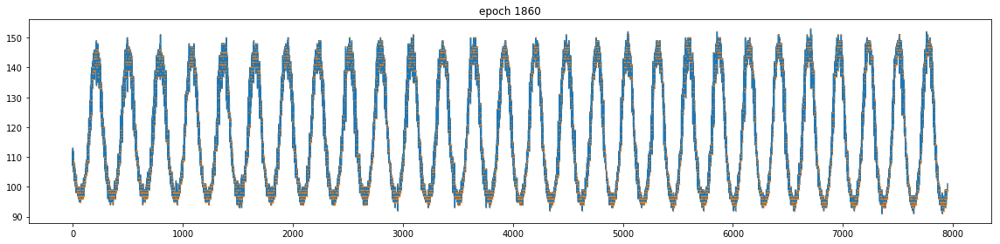

It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 1870, loss 0.002814400475472212


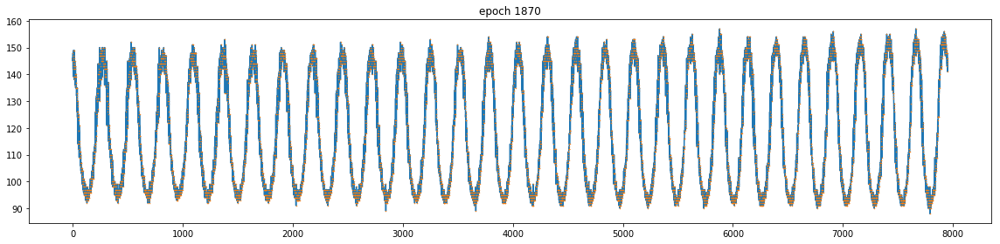

It took 1.25 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 1880, loss 0.0025449853856116533


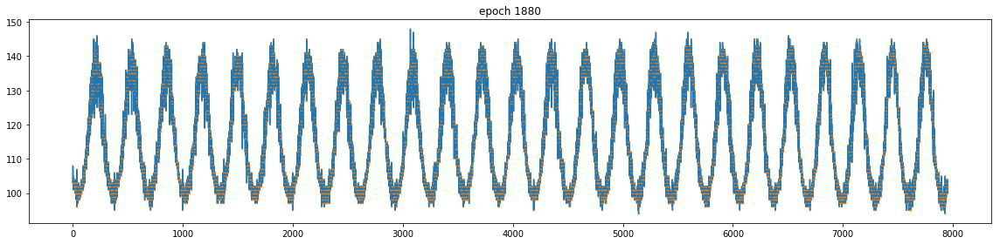

It took 1.22 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 1890, loss 0.0018236098112538457


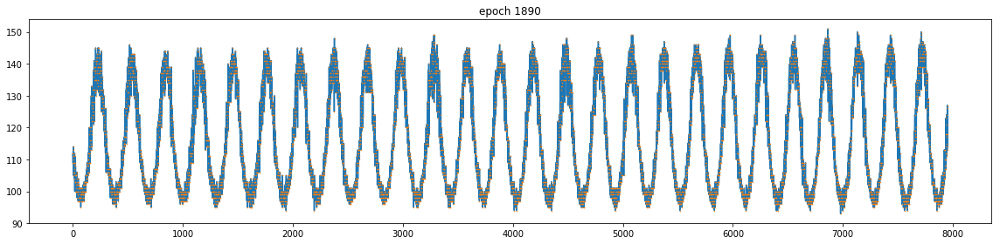

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 1900, loss 0.0014262939803302288


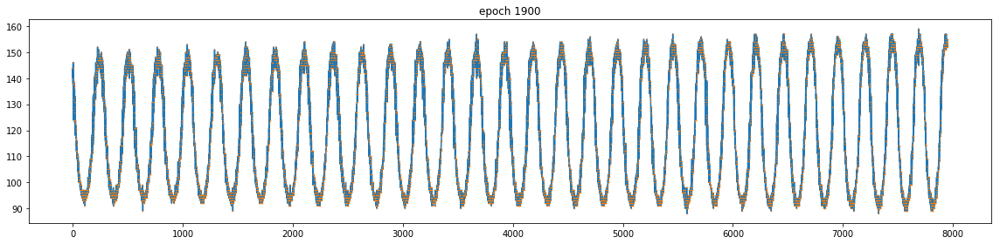

Checkpoint saved: checkpoint_epoch_mbh_batch_1900_2018_07_27__11_08.pth
It took 0.08 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 1910, loss 0.0014353834558278322


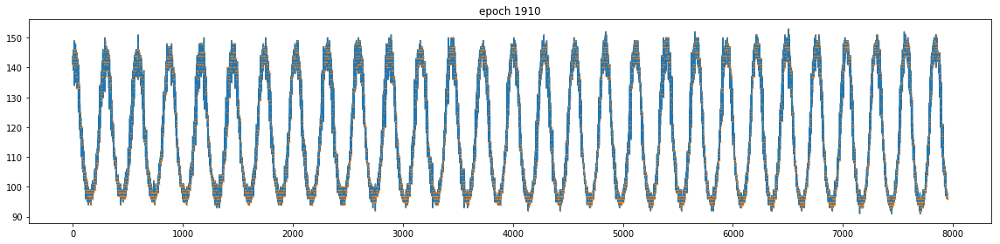

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 1920, loss 0.001706813694909215


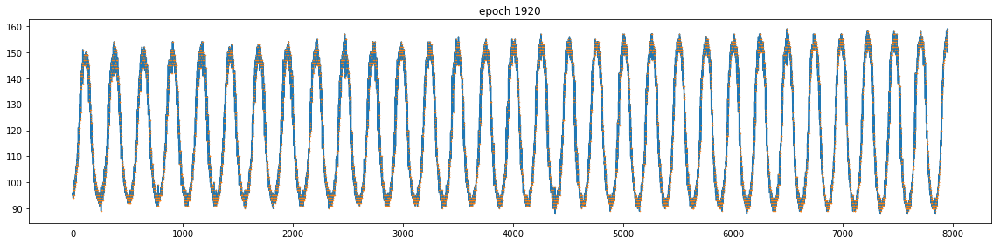

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 1930, loss 0.0016336615663021803


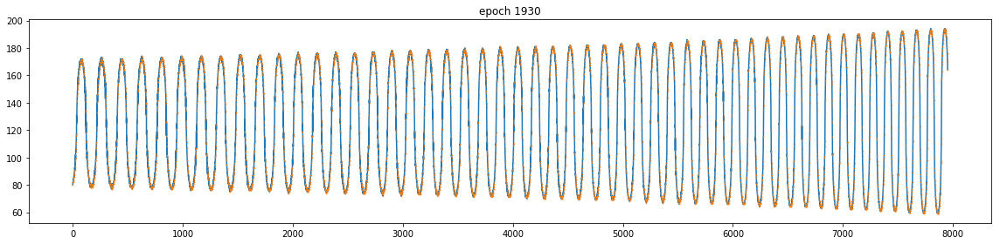

It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 1940, loss 0.0018693143501877785


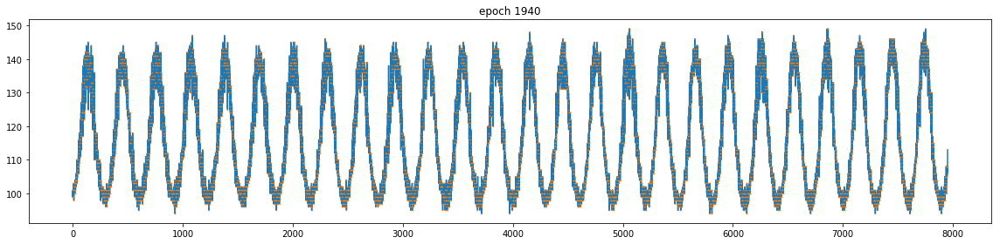

It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 1950, loss 0.0022343092132359743


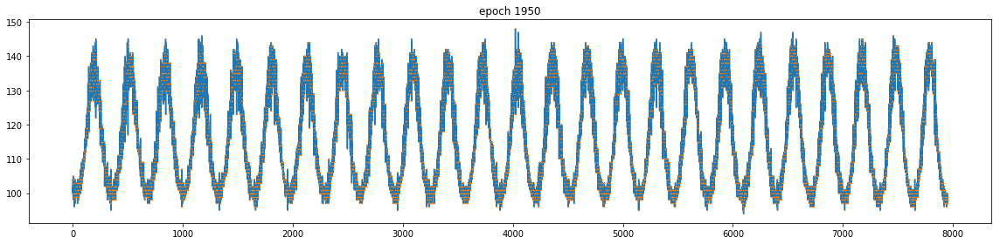

Checkpoint saved: checkpoint_epoch_mbh_batch_1950_2018_07_27__11_09.pth
It took 0.09 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.35 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
epoch 1960, loss 0.002528863027691841


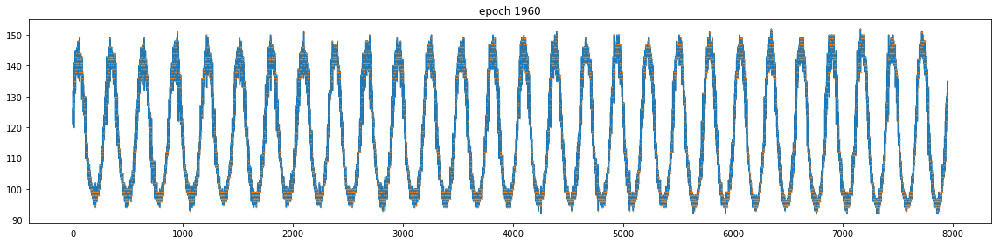

It took 1.24 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 1970, loss 0.002215096727013588


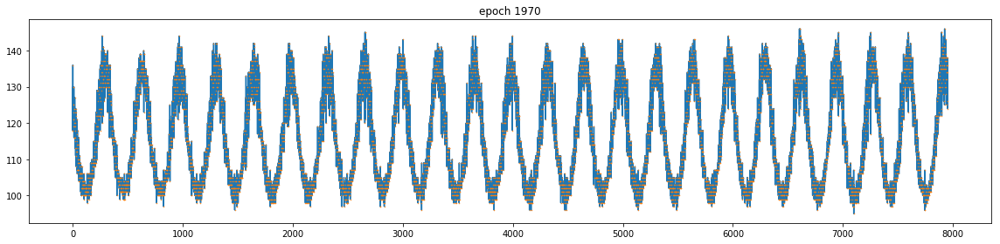

It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 1980, loss 0.001943966024555266


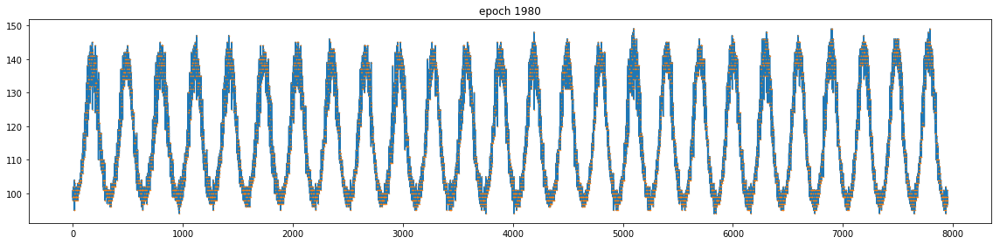

It took 1.24 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 1990, loss 0.00141725514549762


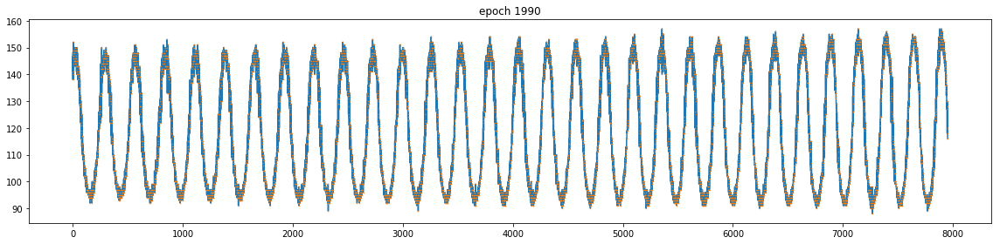

It took 1.26 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2000, loss 0.0012599765323102474


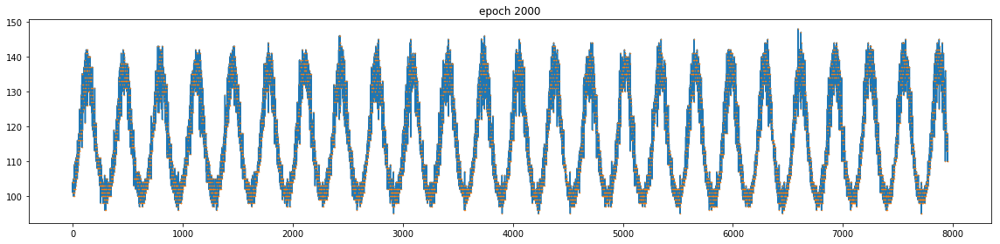

Checkpoint saved: checkpoint_epoch_mbh_batch_2000_2018_07_27__11_10.pth
It took 0.09 seconds to save data file
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2010, loss 0.001490447553806007


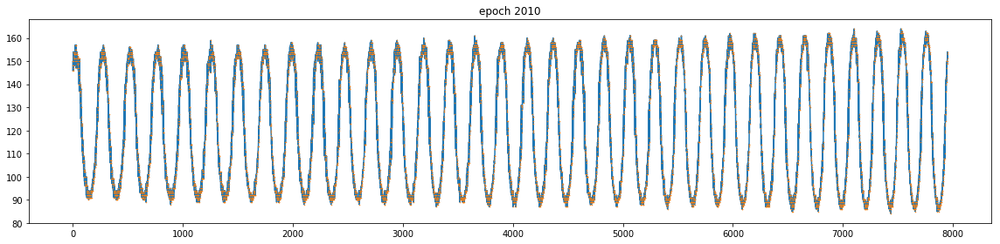

It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2020, loss 0.0027344233822077513


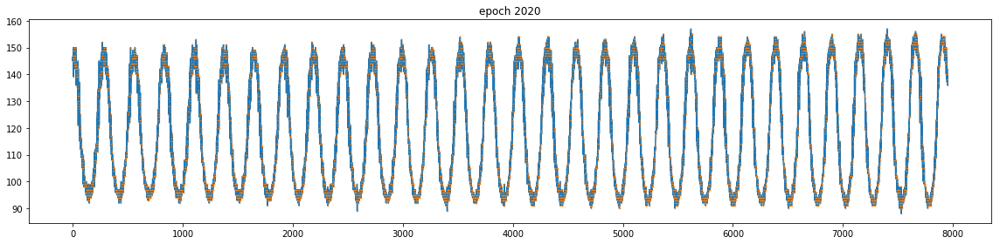

It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2030, loss 0.0013212517369538546


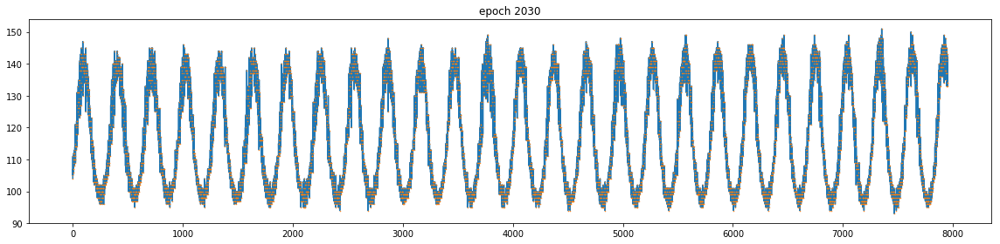

It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2040, loss 0.0011337895411998034


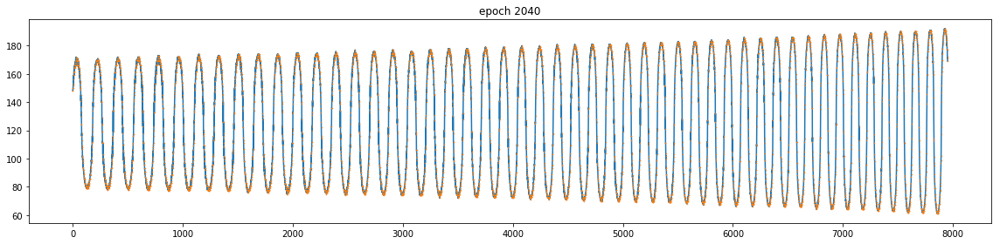

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2050, loss 0.001202562008984387


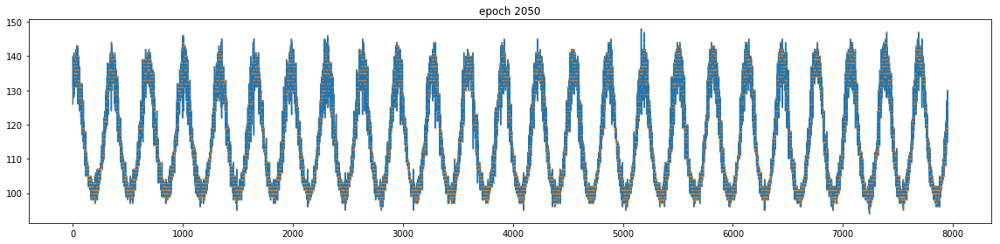

Checkpoint saved: checkpoint_epoch_mbh_batch_2050_2018_07_27__11_11.pth
It took 0.09 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2060, loss 0.0013239183463156223


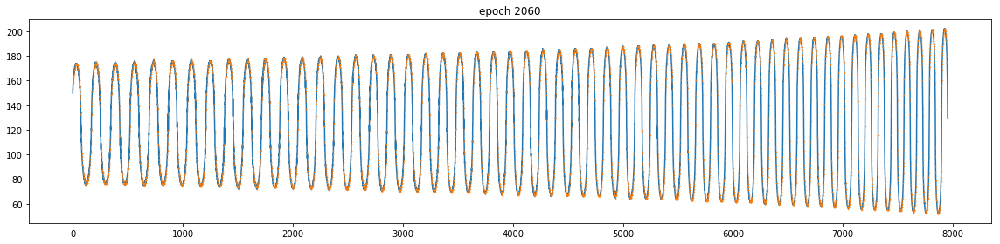

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
epoch 2070, loss 0.0010596594074741006


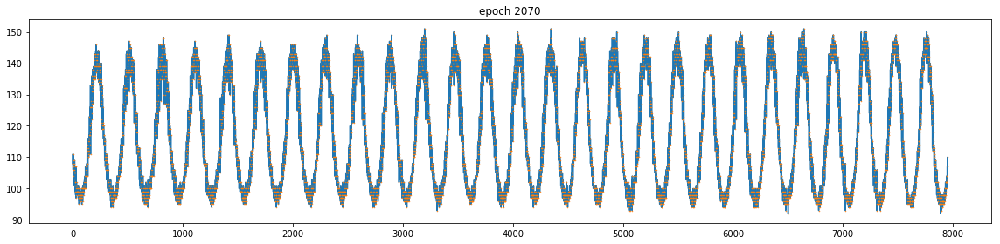

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 2080, loss 0.0012272557942196727


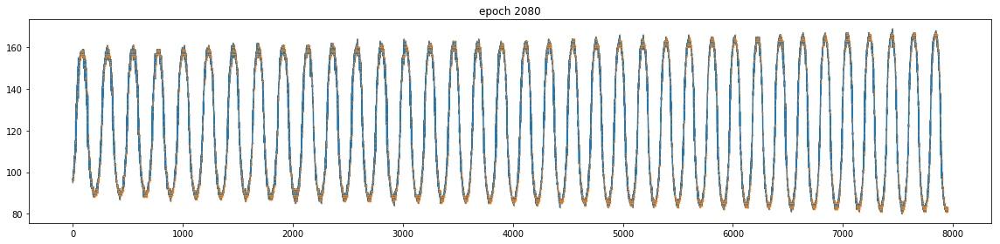

It took 1.23 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2090, loss 0.0008885980932973325


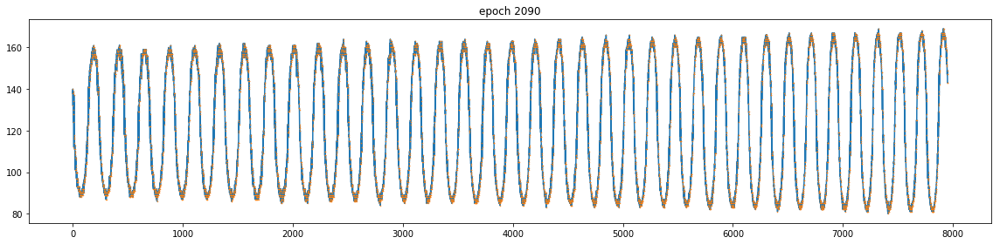

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2100, loss 0.0009480086737312376


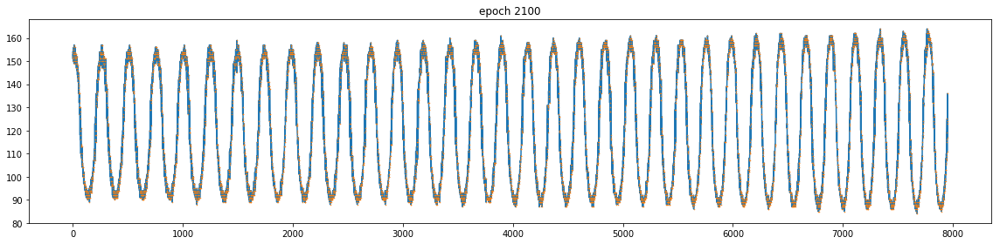

Checkpoint saved: checkpoint_epoch_mbh_batch_2100_2018_07_27__11_12.pth
It took 0.08 seconds to save data file
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2110, loss 0.0022142662201076746


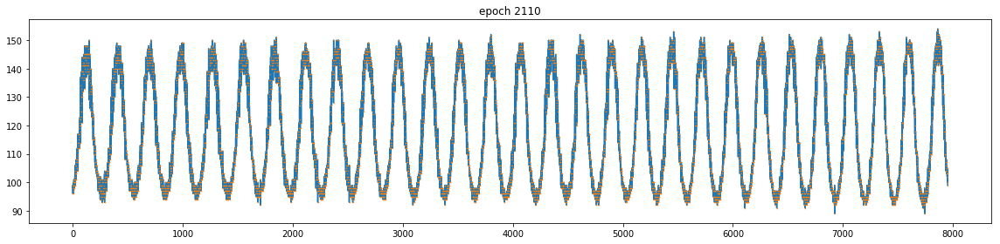

It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2120, loss 0.0013758715940639377


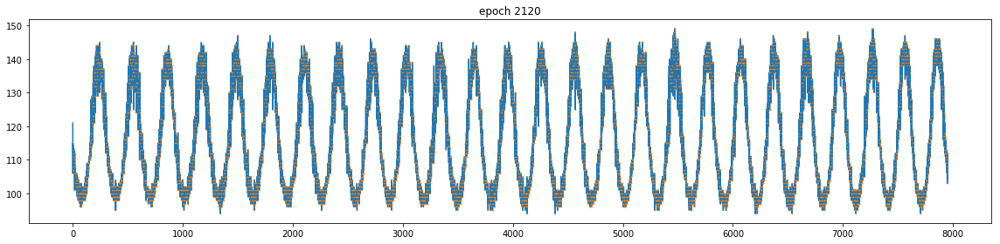

It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2130, loss 0.0008571920334361494


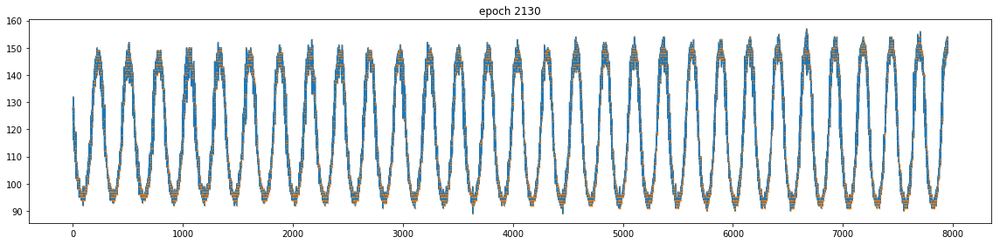

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2140, loss 0.0009945412166416645


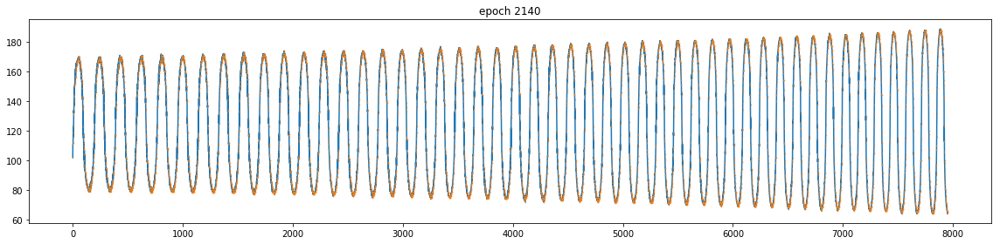

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 2150, loss 0.0023528174497187138


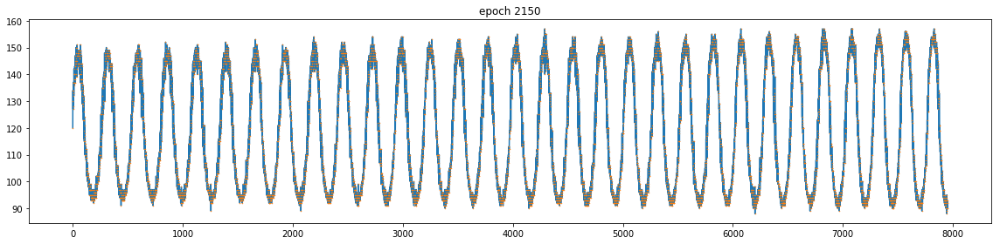

Checkpoint saved: checkpoint_epoch_mbh_batch_2150_2018_07_27__11_13.pth
It took 0.09 seconds to save data file
It took 1.27 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
epoch 2160, loss 0.0024471154902130365


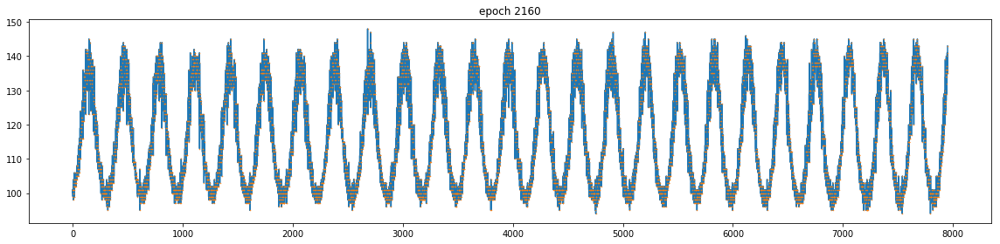

It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 2170, loss 0.0010757812997326255


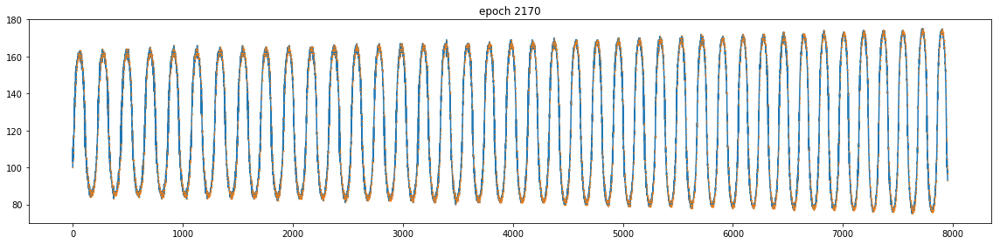

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2180, loss 0.0010405050124973059


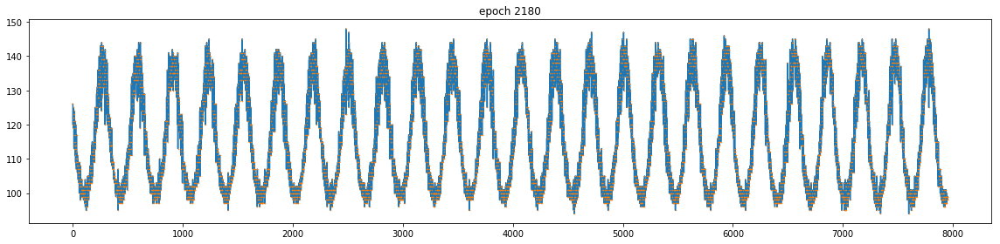

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.30 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2190, loss 0.0007873554714024067


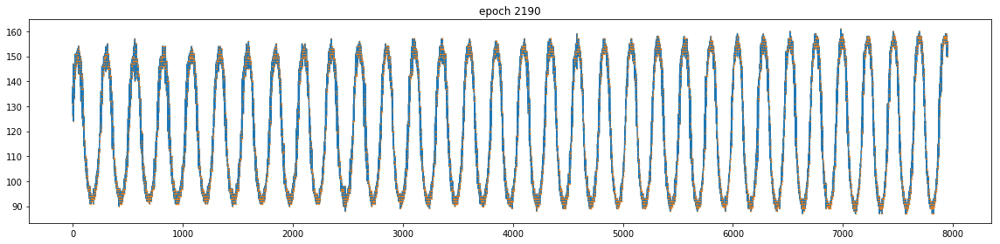

It took 1.29 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 2200, loss 0.000864936679136008


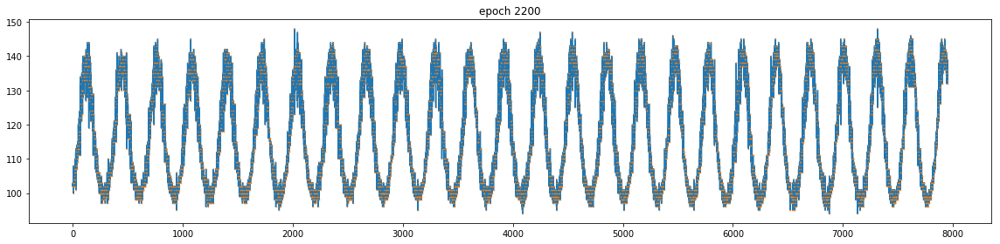

Checkpoint saved: checkpoint_epoch_mbh_batch_2200_2018_07_27__11_14.pth
It took 0.09 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2210, loss 0.0008108338806778193


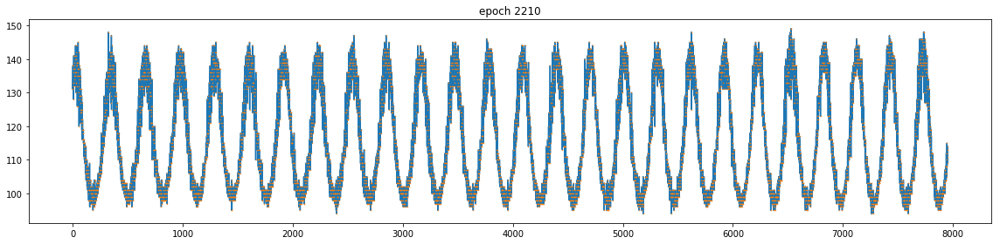

It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2220, loss 0.0010785568738356233


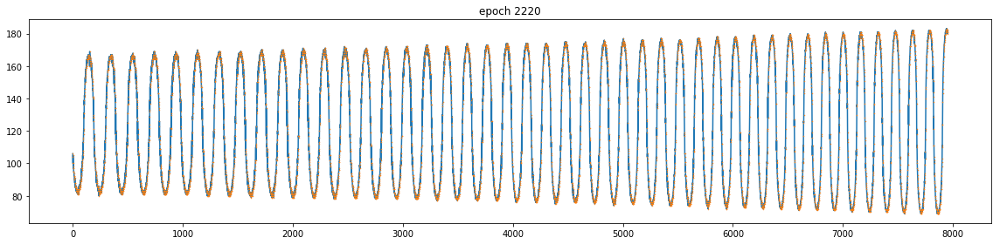

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2230, loss 0.0008541339193470776


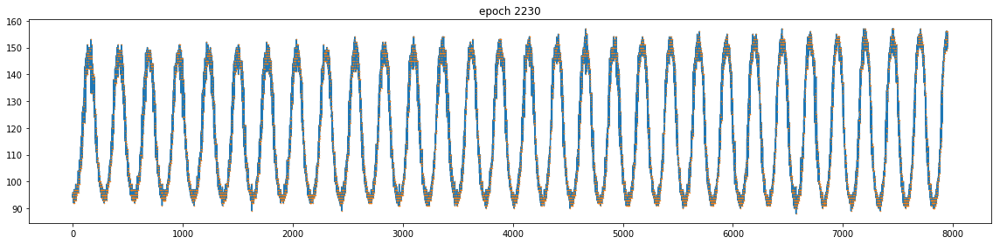

It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 2240, loss 0.0007095840992406011


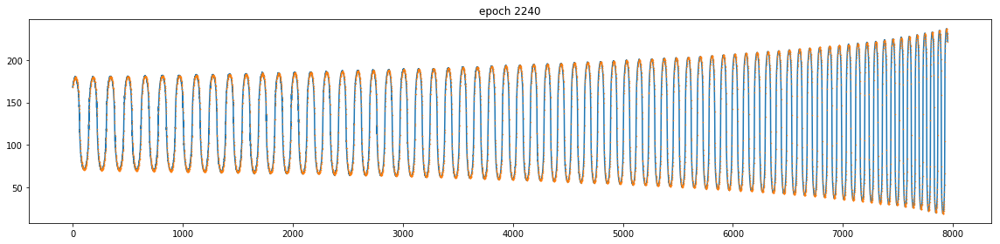

It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2250, loss 0.0008134569507092237


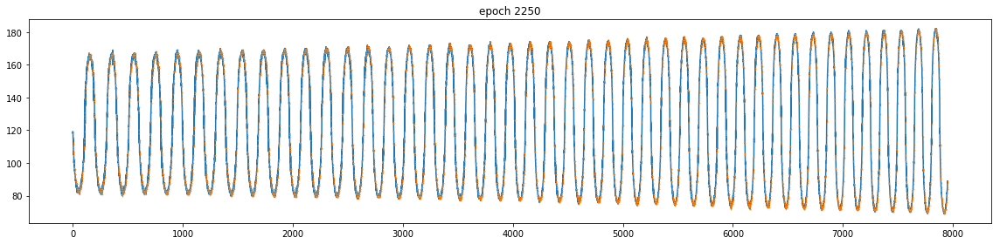

Checkpoint saved: checkpoint_epoch_mbh_batch_2250_2018_07_27__11_15.pth
It took 0.14 seconds to save data file
It took 1.24 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 2260, loss 0.0009022821905091405


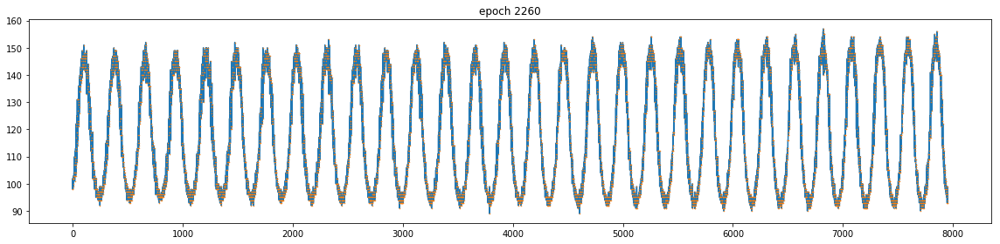

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2270, loss 0.0015359563985839486


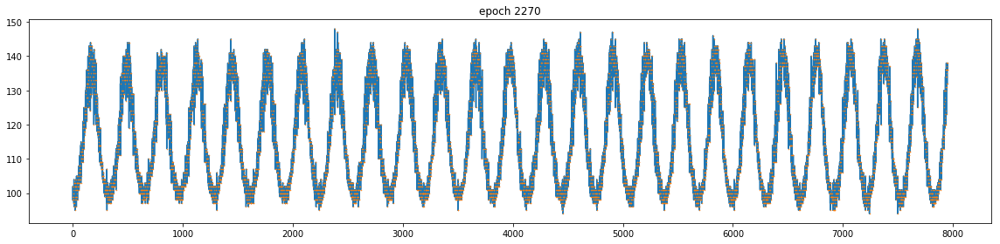

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2280, loss 0.0010170413879677653


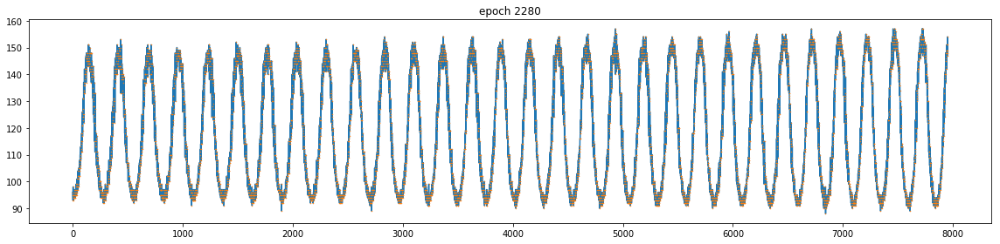

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2290, loss 0.0008350473362952471


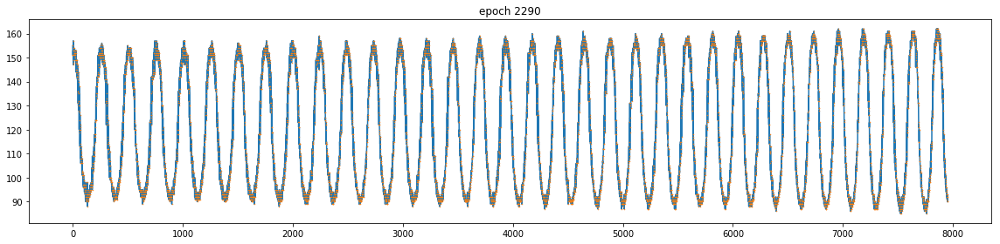

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2300, loss 0.0007772576063871384


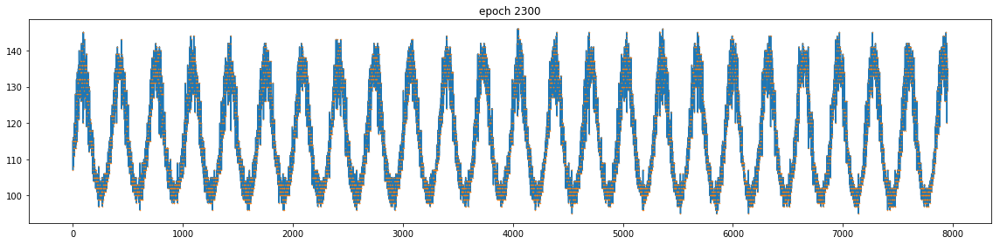

Checkpoint saved: checkpoint_epoch_mbh_batch_2300_2018_07_27__11_16.pth
It took 0.09 seconds to save data file
It took 1.24 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 2310, loss 0.0007764859474264085


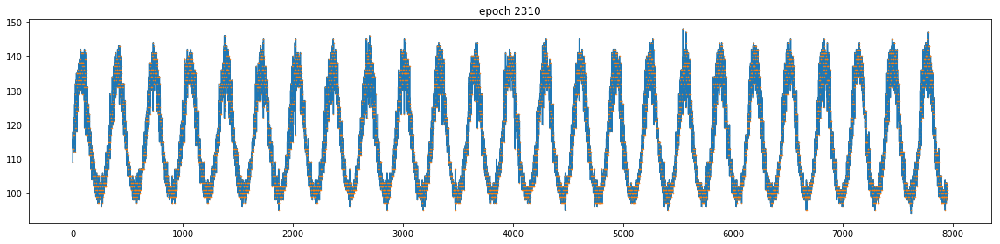

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2320, loss 0.0009932382963597775


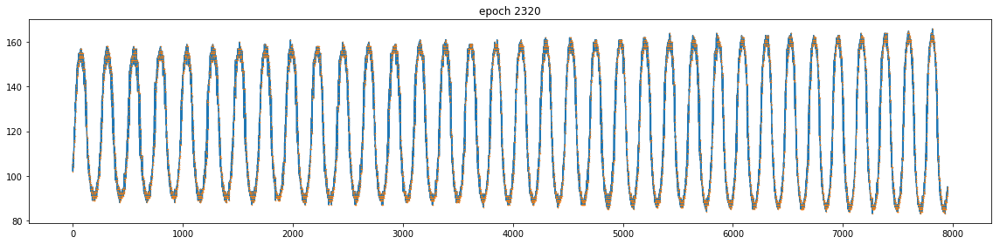

It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2330, loss 0.0006754484493285418


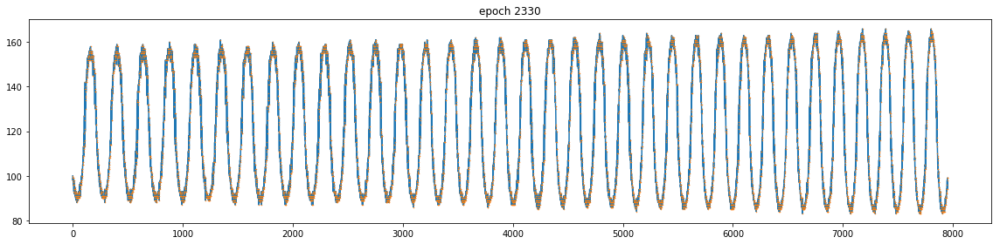

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2340, loss 0.0005503079737536609


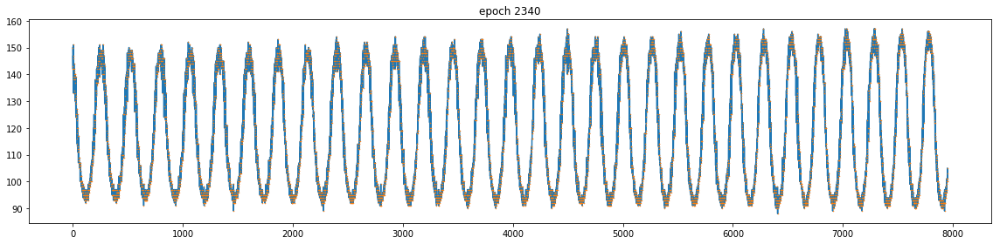

It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2350, loss 0.0007619839161634445


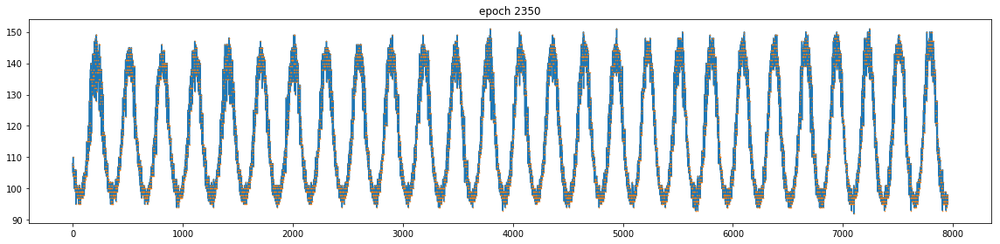

Checkpoint saved: checkpoint_epoch_mbh_batch_2350_2018_07_27__11_17.pth
It took 0.09 seconds to save data file
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2360, loss 0.0005777977057732642


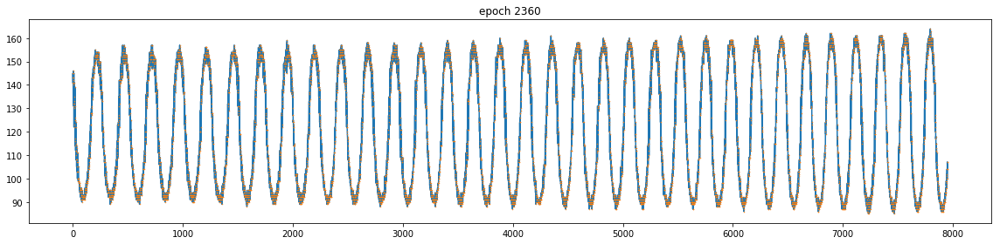

It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2370, loss 0.0006173747242428362


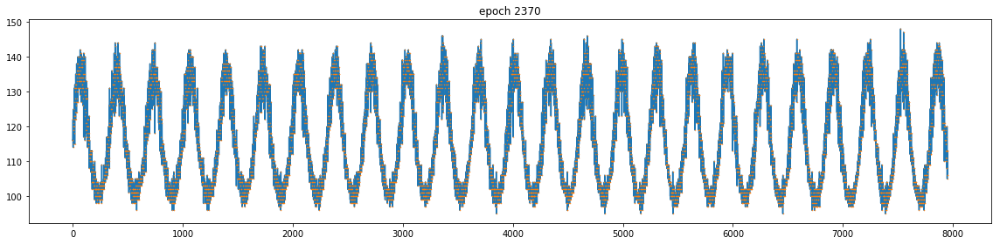

It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2380, loss 0.0007367053185589612


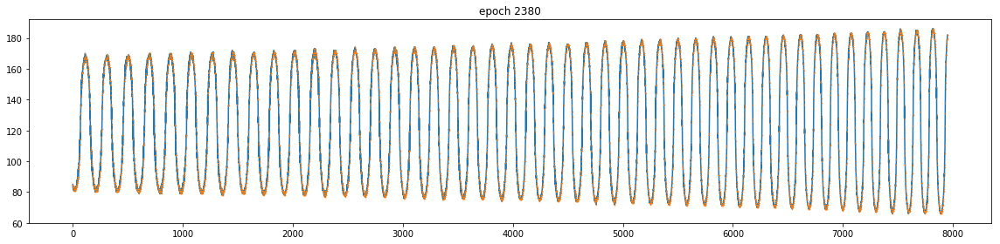

It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2390, loss 0.0014030358288437128


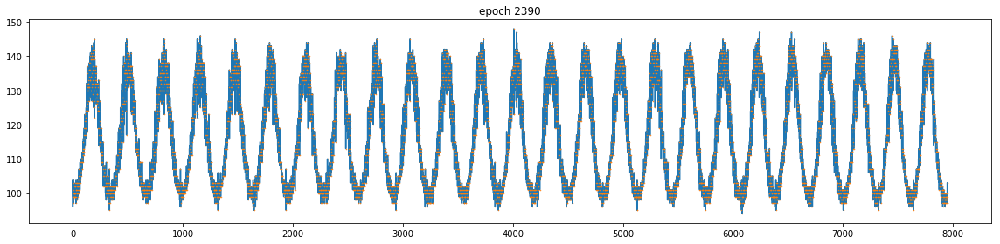

It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2400, loss 0.0006687530549243093


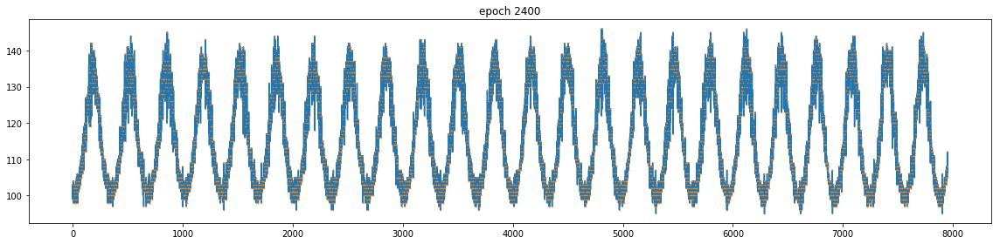

Checkpoint saved: checkpoint_epoch_mbh_batch_2400_2018_07_27__11_18.pth
It took 0.09 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2410, loss 0.0009503231849521399


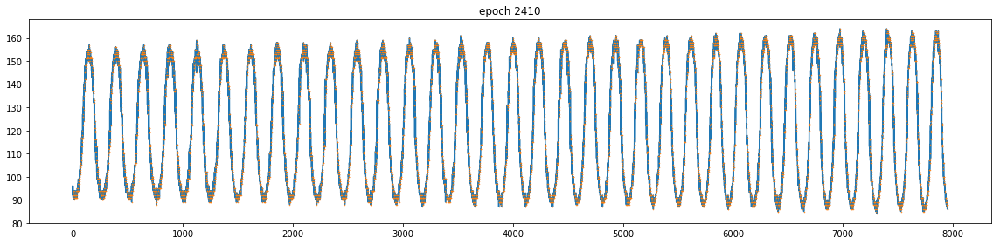

It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2420, loss 0.0005509168840944767


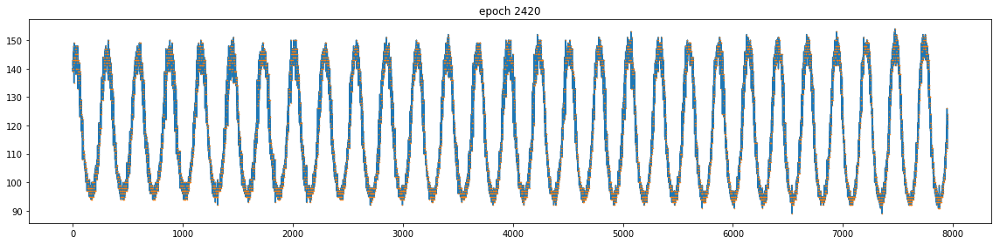

It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2430, loss 0.0005304875085130334


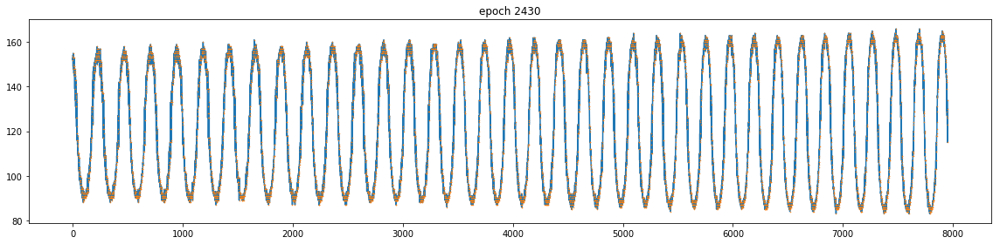

It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 2440, loss 0.000962546793743968


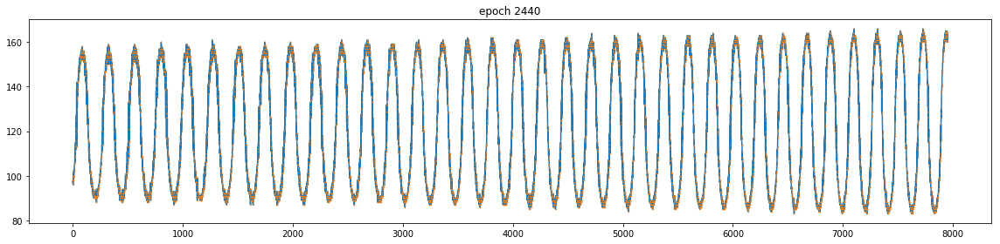

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2450, loss 0.0006549790850840509


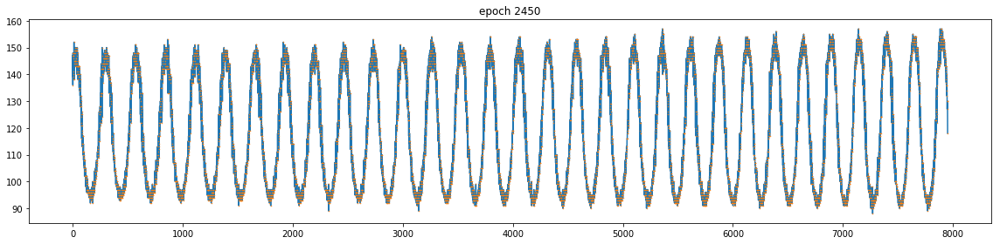

Checkpoint saved: checkpoint_epoch_mbh_batch_2450_2018_07_27__11_19.pth
It took 0.09 seconds to save data file
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 2460, loss 0.0006587934913113713


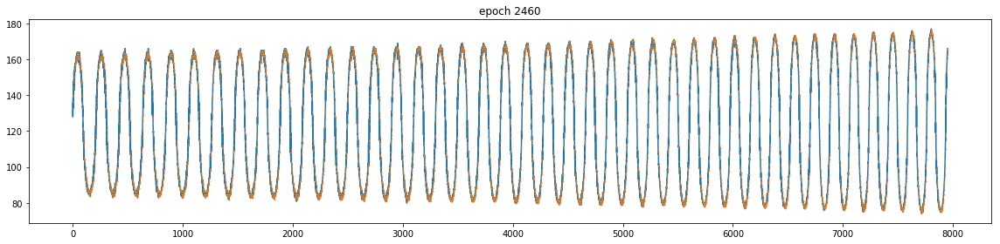

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2470, loss 0.0005266435910016298


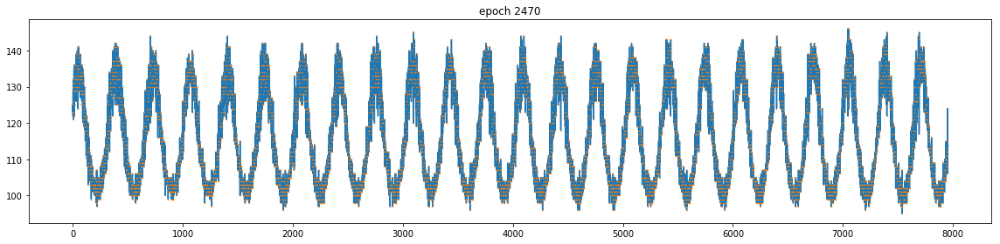

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2480, loss 0.0005589044885709882


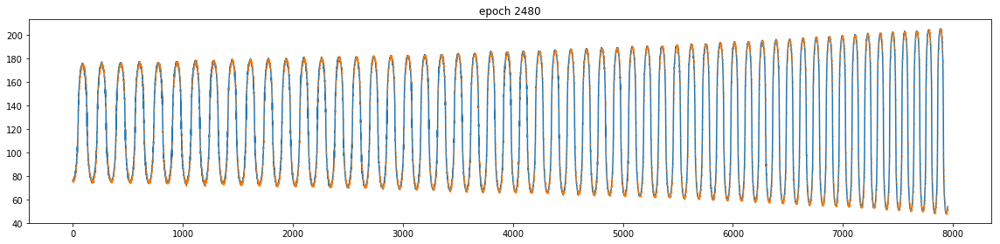

It took 1.23 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2490, loss 0.0005325968377292156


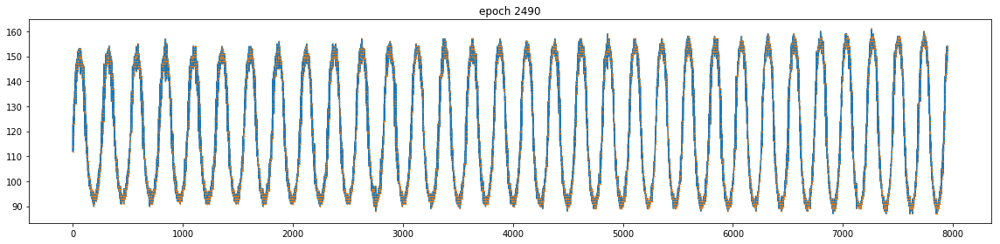

It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2500, loss 0.00047960595111362636


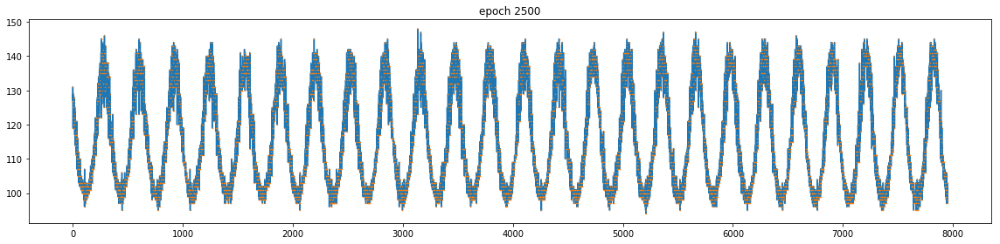

Checkpoint saved: checkpoint_epoch_mbh_batch_2500_2018_07_27__11_20.pth
It took 0.10 seconds to save data file
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2510, loss 0.0005058481474407017


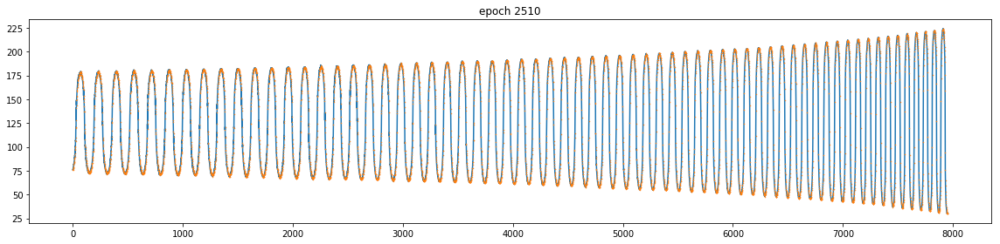

It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2520, loss 0.00046473616384901106


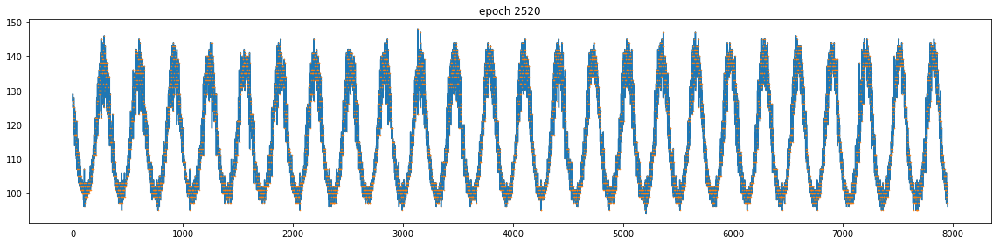

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2530, loss 0.0006193213630467653


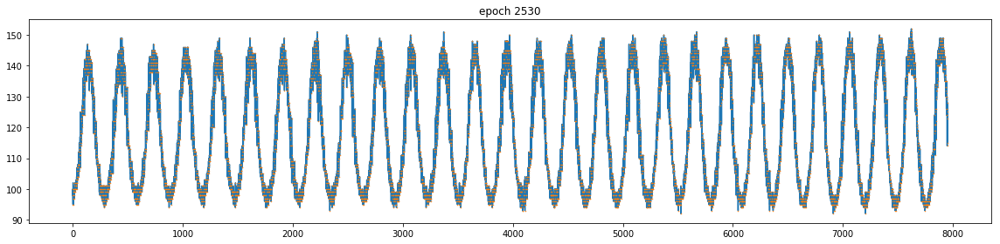

It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2540, loss 0.000778740446548909


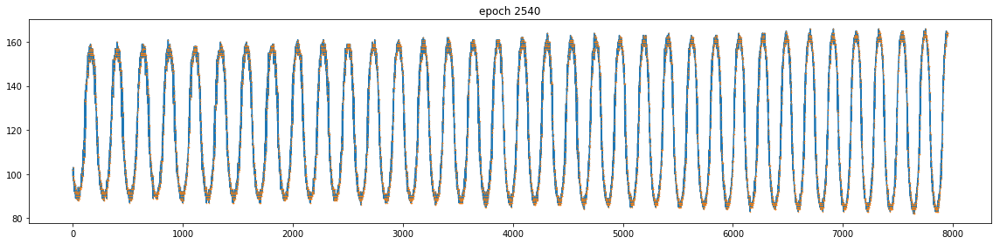

It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2550, loss 0.0006539326859638095


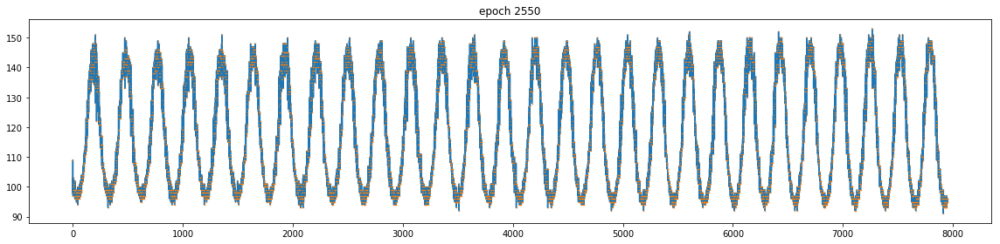

Checkpoint saved: checkpoint_epoch_mbh_batch_2550_2018_07_27__11_21.pth
It took 0.12 seconds to save data file
It took 1.26 seconds to finish an epoch
It took 1.25 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2560, loss 0.00048238408635370433


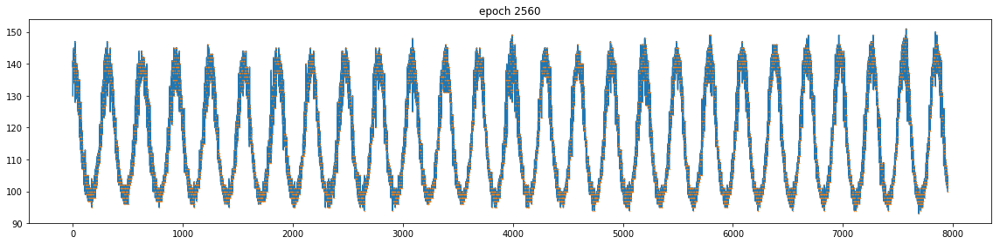

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2570, loss 0.0006391787901520729


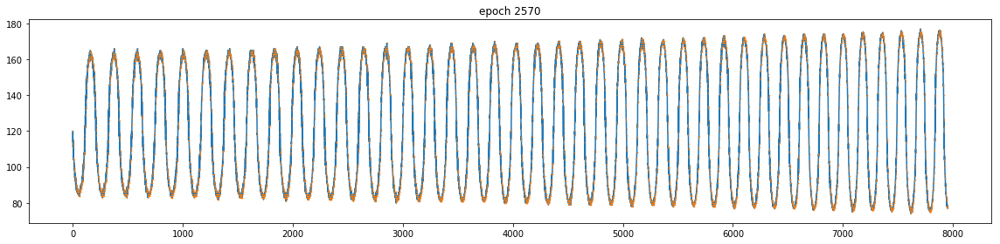

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2580, loss 0.0009750658646225929


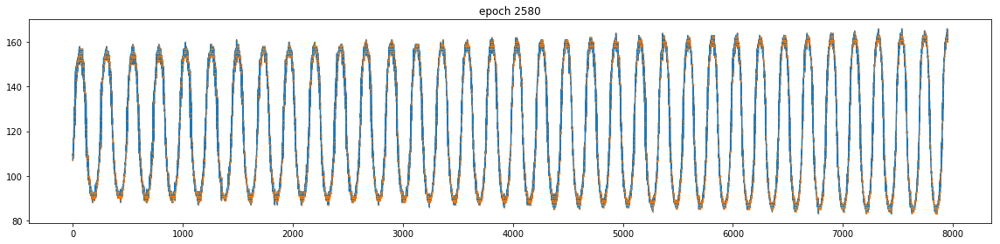

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2590, loss 0.0007960614748299122


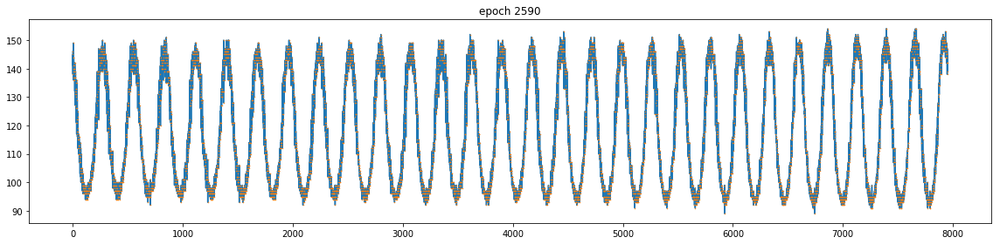

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
epoch 2600, loss 0.0005889999447390437


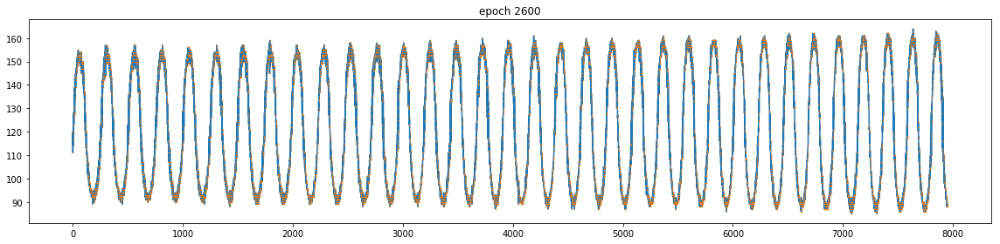

Checkpoint saved: checkpoint_epoch_mbh_batch_2600_2018_07_27__11_22.pth
It took 0.10 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.26 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2610, loss 0.0005014491034671664


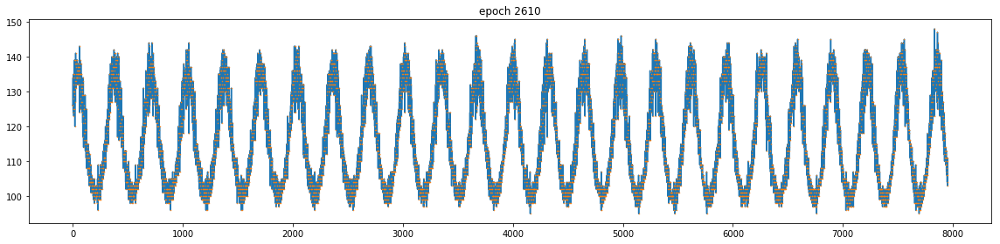

It took 1.25 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2620, loss 0.000795361353084445


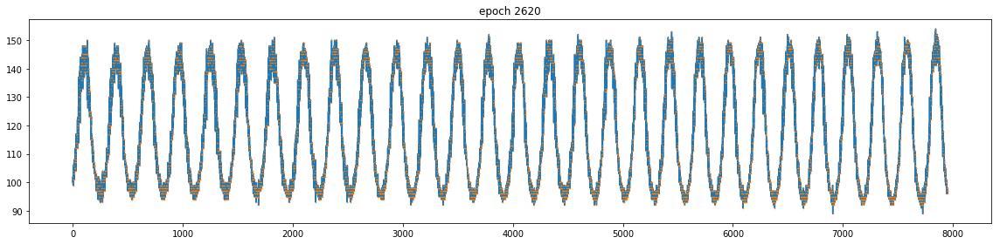

It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2630, loss 0.0004899080959148705


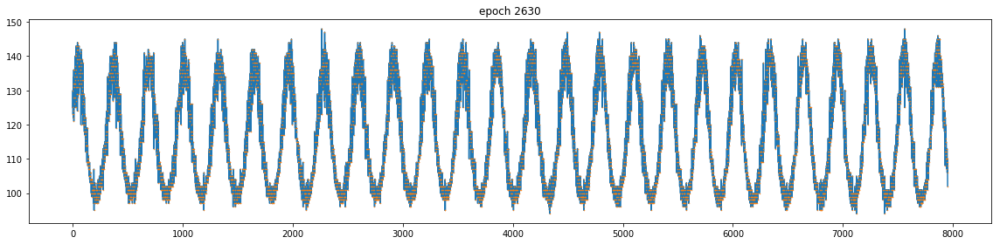

It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2640, loss 0.0005300015327520669


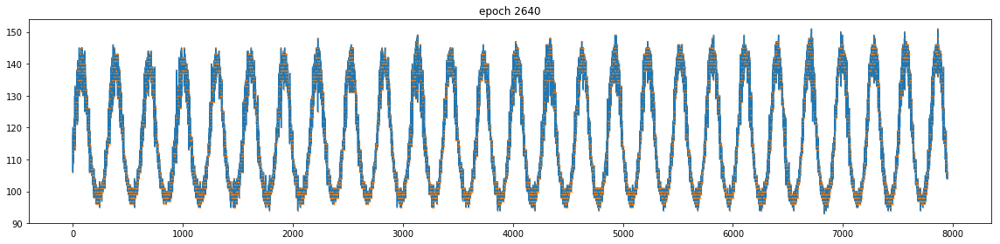

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
epoch 2650, loss 0.0005929542239755392


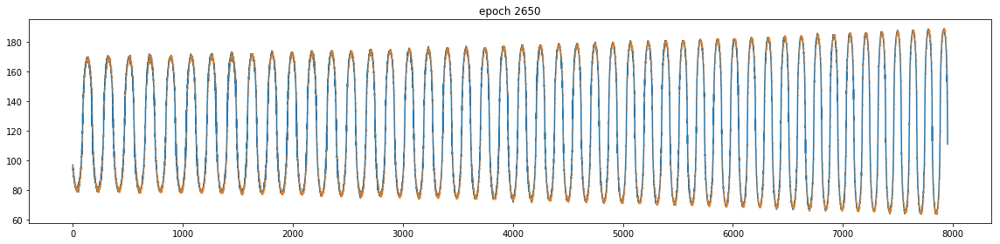

Checkpoint saved: checkpoint_epoch_mbh_batch_2650_2018_07_27__11_23.pth
It took 0.10 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2660, loss 0.0007497764308936894


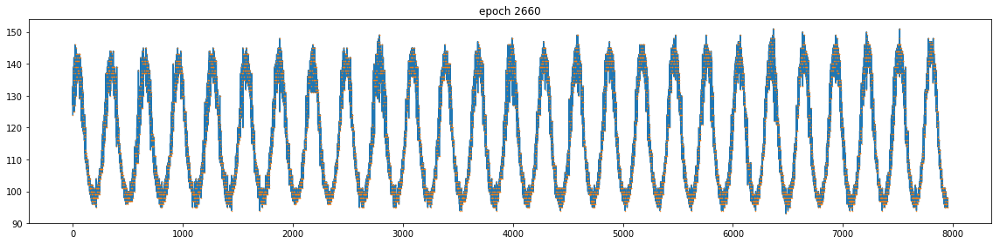

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2670, loss 0.00045422581024467945


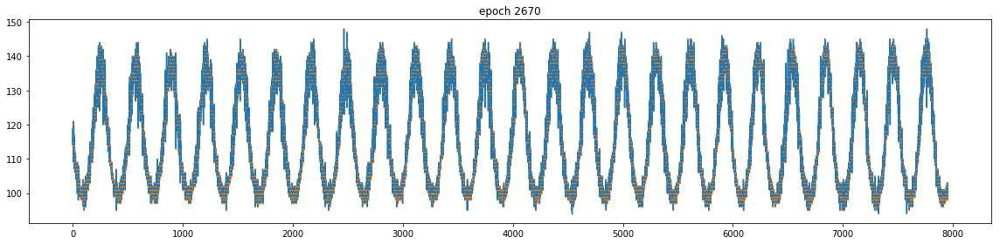

It took 1.25 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.28 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2680, loss 0.0005786488181911409


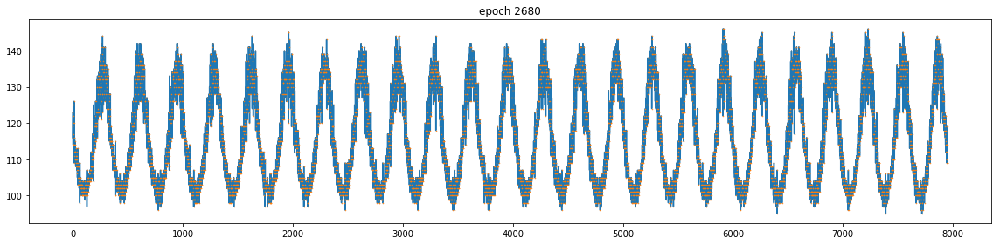

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 2690, loss 0.0004344351764302701


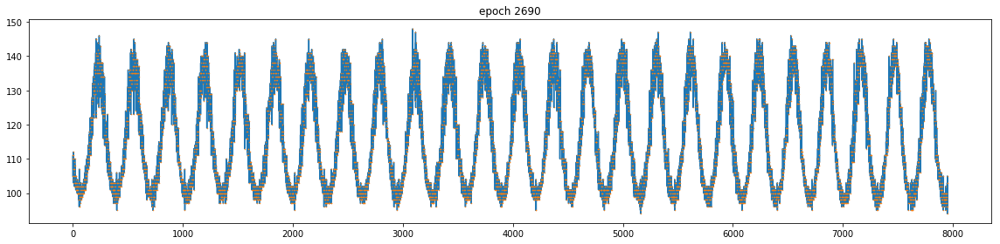

It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2700, loss 0.0004470309359021485


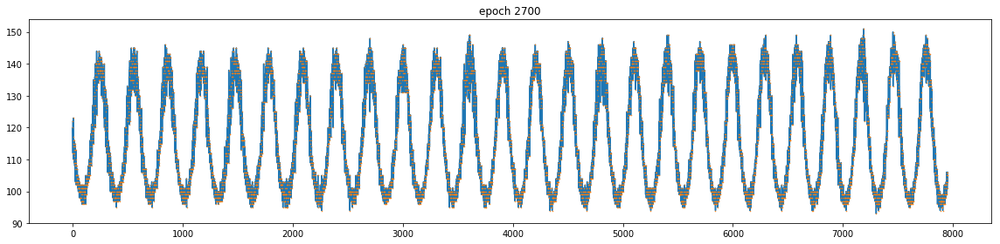

Checkpoint saved: checkpoint_epoch_mbh_batch_2700_2018_07_27__11_24.pth
It took 0.10 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2710, loss 0.0004516684275586158


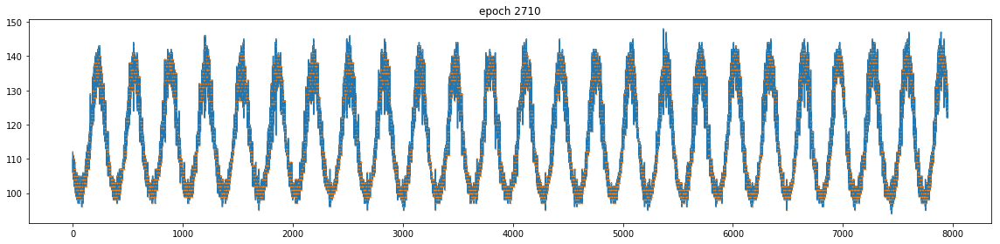

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2720, loss 0.0007811503019183874


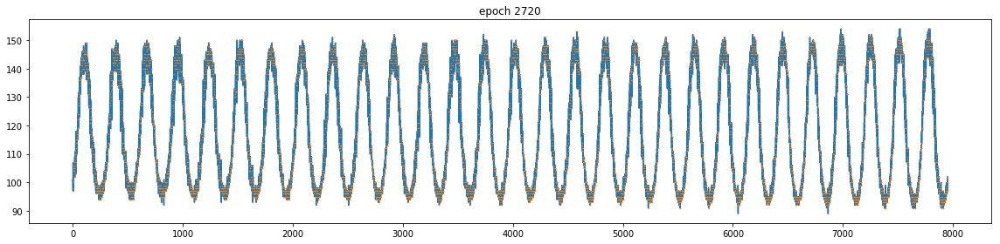

It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.29 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2730, loss 0.000382833561161533


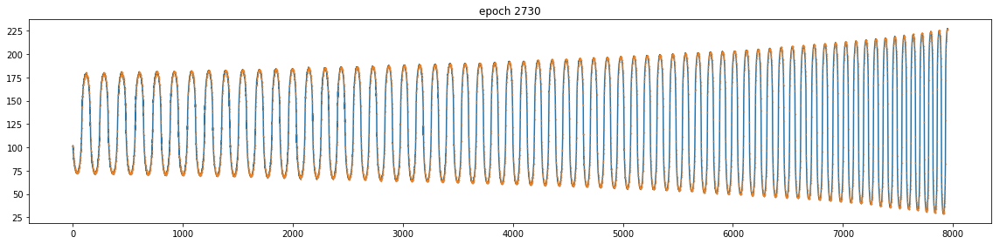

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.27 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2740, loss 0.00041249216883443296


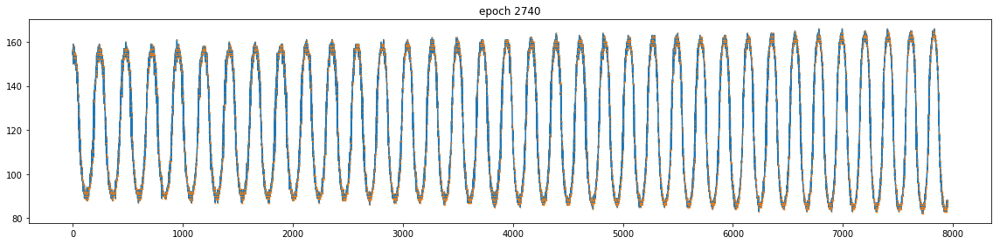

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2750, loss 0.0004440508200787008


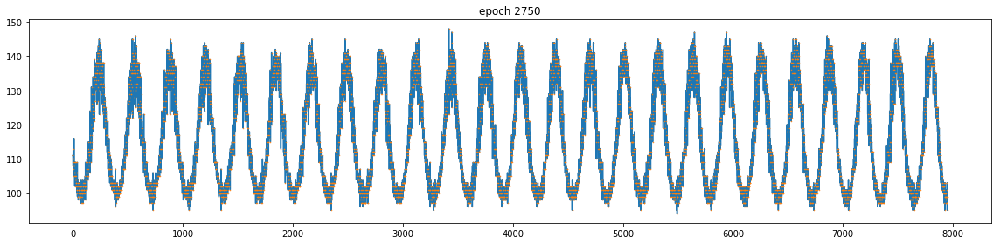

Checkpoint saved: checkpoint_epoch_mbh_batch_2750_2018_07_27__11_25.pth
It took 0.15 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2760, loss 0.0004461289499886334


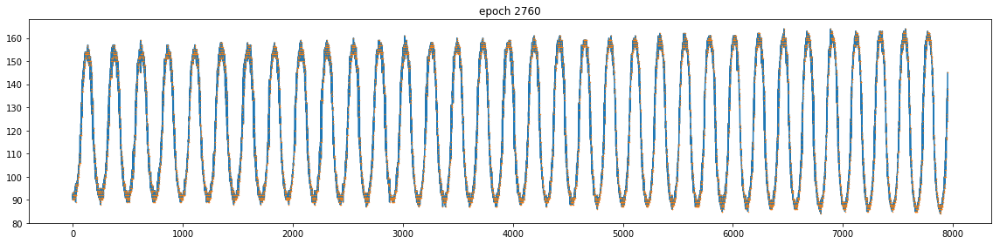

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2770, loss 0.000555606500711292


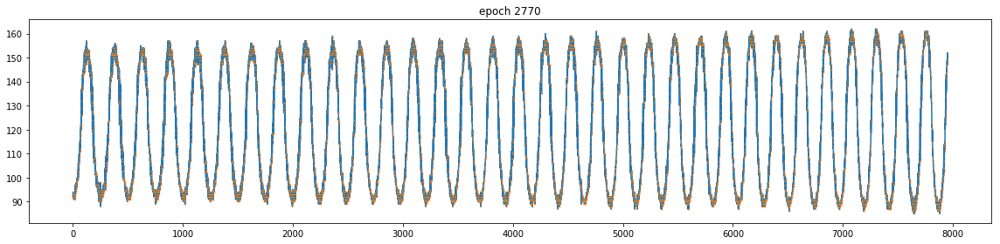

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2780, loss 0.0003525508218444884


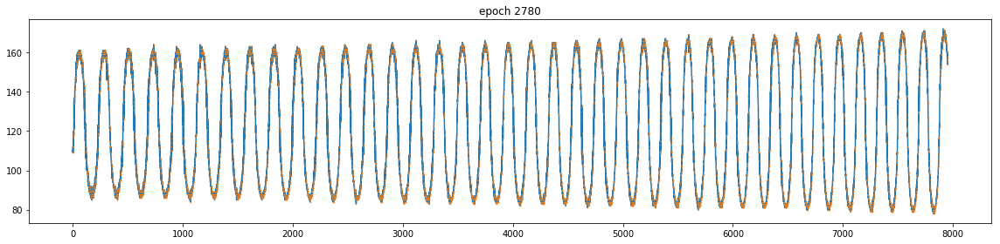

It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2790, loss 0.0011986372992396355


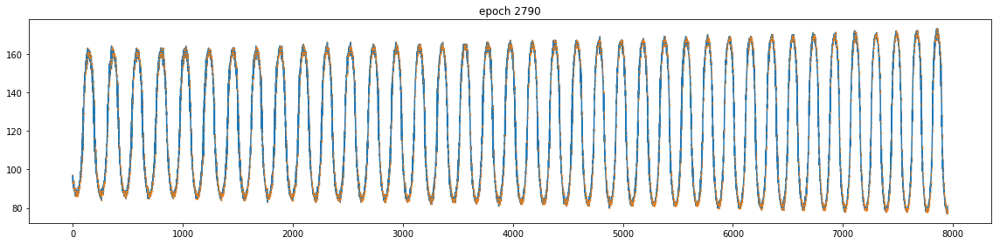

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 2800, loss 0.00038059623329900205


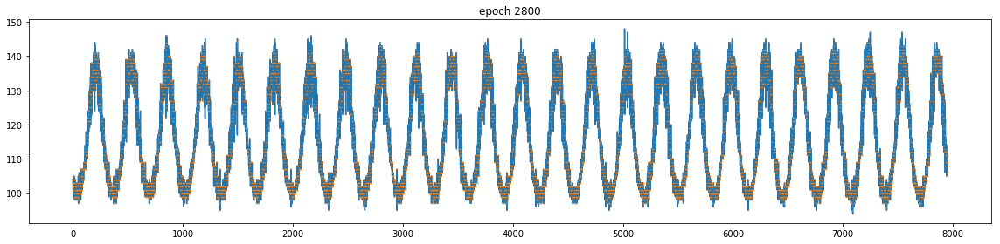

Checkpoint saved: checkpoint_epoch_mbh_batch_2800_2018_07_27__11_26.pth
It took 0.10 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2810, loss 0.00041868924745358527


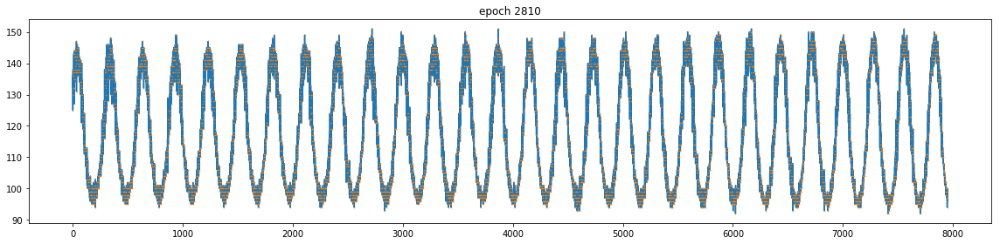

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2820, loss 0.00035564869176596403


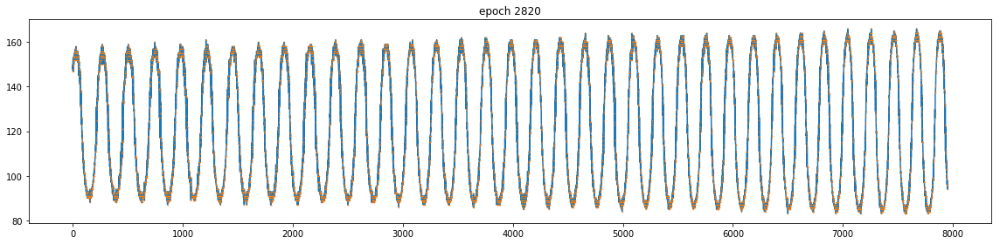

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
epoch 2830, loss 0.00044359423918649554


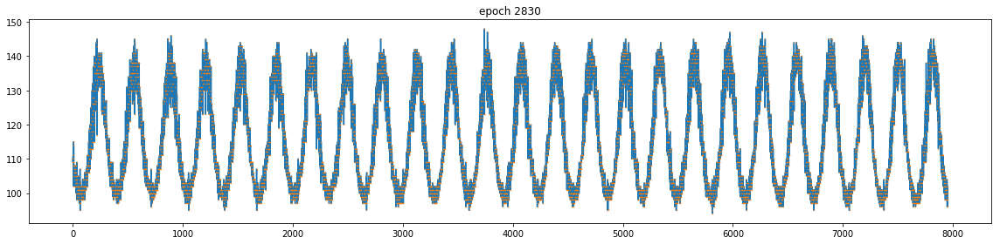

It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2840, loss 0.00037225690903142095


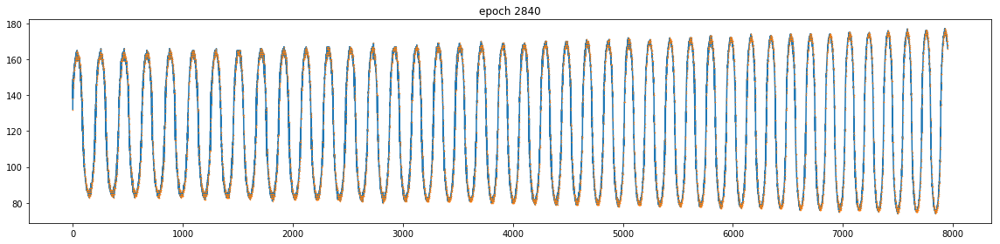

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.24 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
epoch 2850, loss 0.00032668584026396275


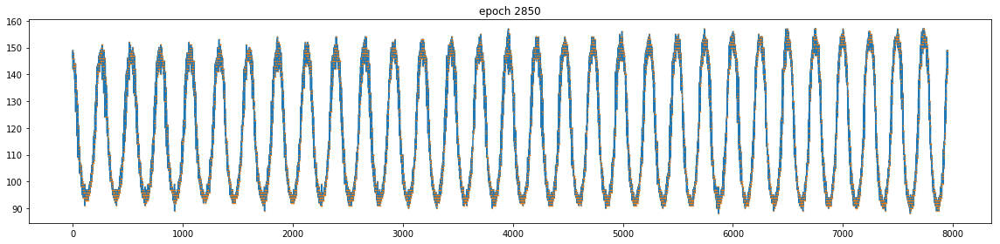

Checkpoint saved: checkpoint_epoch_mbh_batch_2850_2018_07_27__11_27.pth
It took 0.11 seconds to save data file
It took 1.24 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2860, loss 0.0003256748605053872


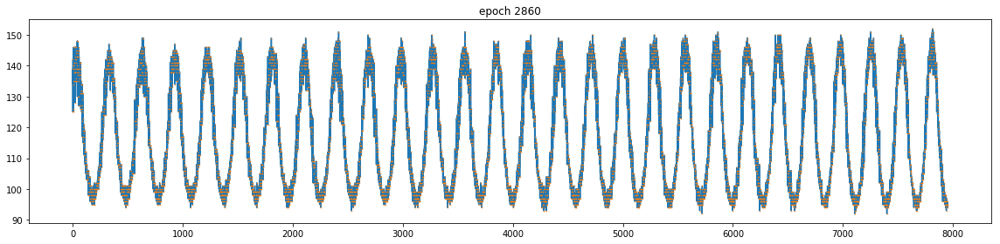

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2870, loss 0.0003970623656641692


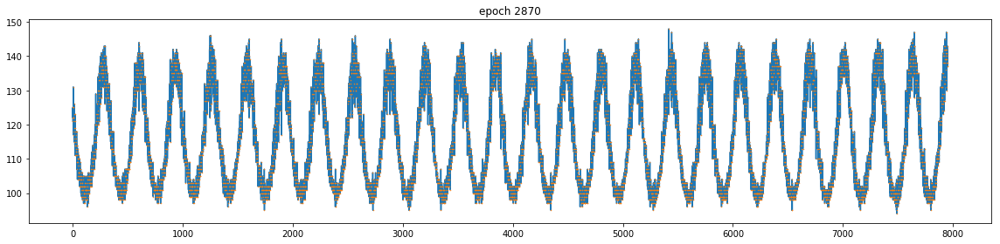

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2880, loss 0.00039290275890380144


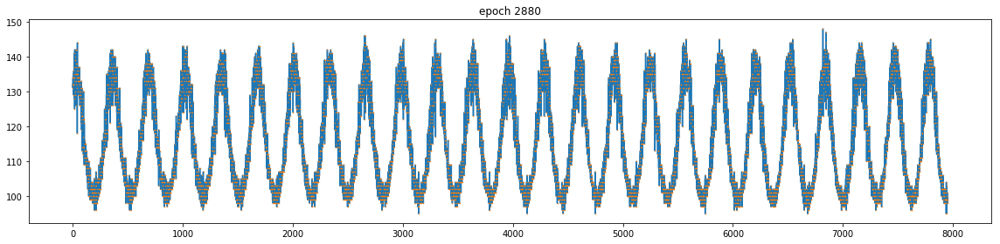

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2890, loss 0.0006261453381739557


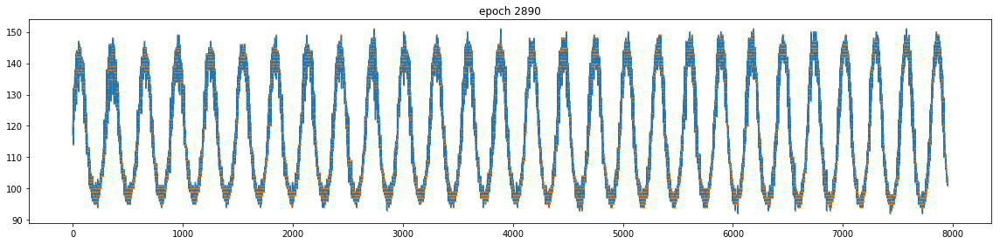

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2900, loss 0.00037633959436789155


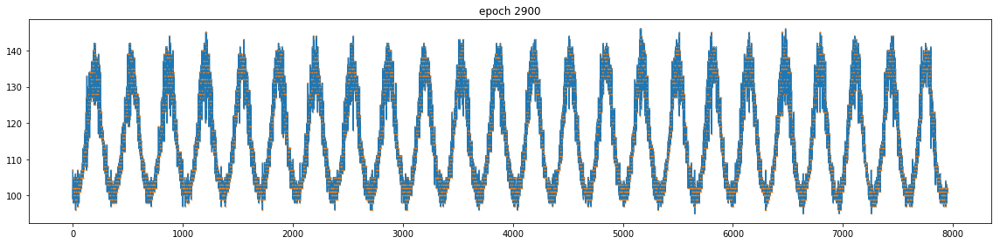

Checkpoint saved: checkpoint_epoch_mbh_batch_2900_2018_07_27__11_28.pth
It took 0.11 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2910, loss 0.0003823814040515572


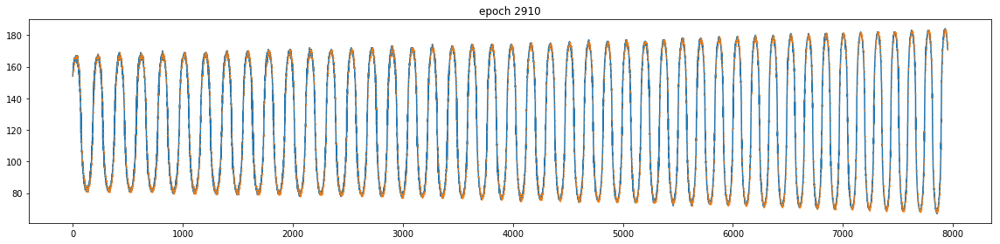

It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2920, loss 0.00038132042391225696


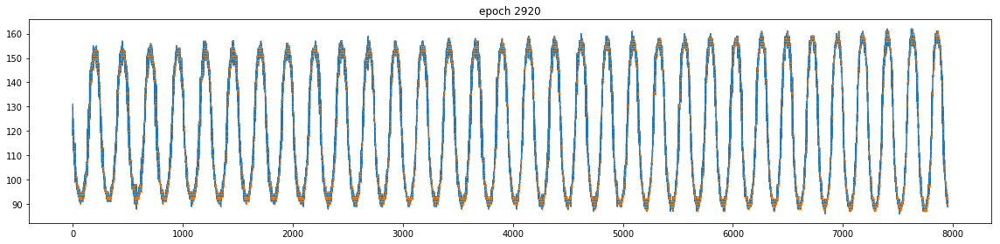

It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2930, loss 0.0003626787511166185


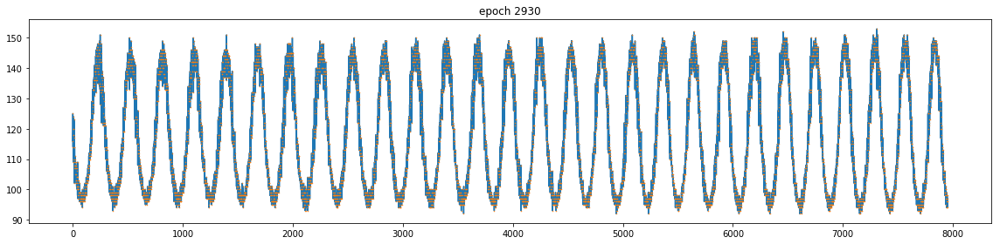

It took 1.22 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
epoch 2940, loss 0.0007381086470559239


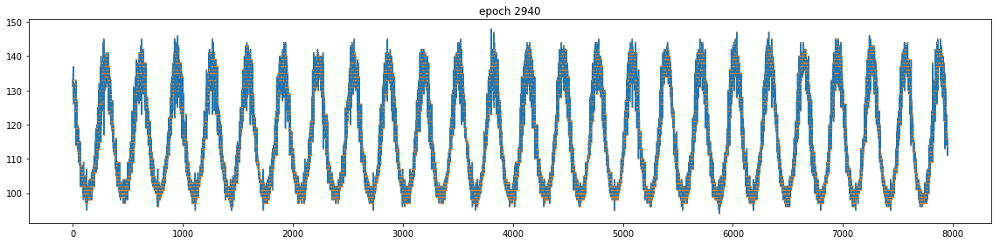

It took 1.24 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
epoch 2950, loss 0.0003878564457409084


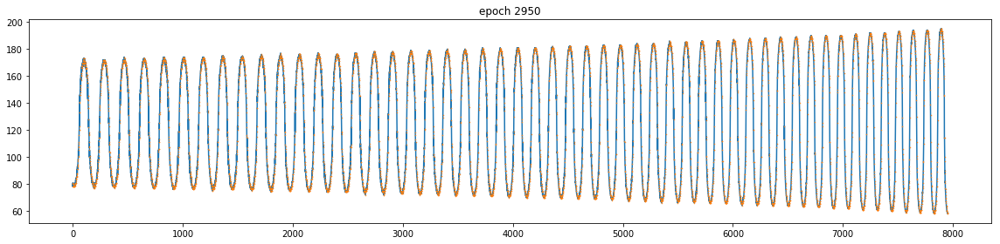

Checkpoint saved: checkpoint_epoch_mbh_batch_2950_2018_07_27__11_29.pth
It took 0.11 seconds to save data file
It took 1.23 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2960, loss 0.0009865586180239916


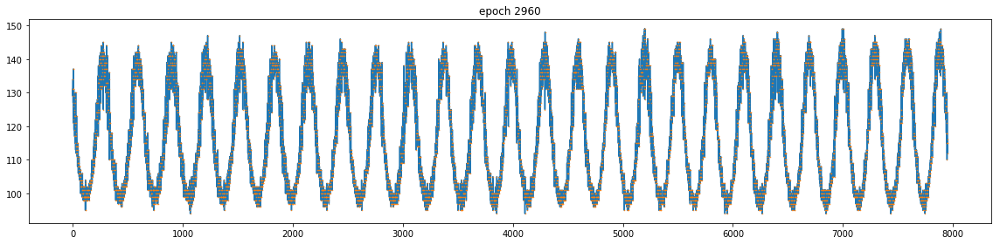

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2970, loss 0.0005397366476245224


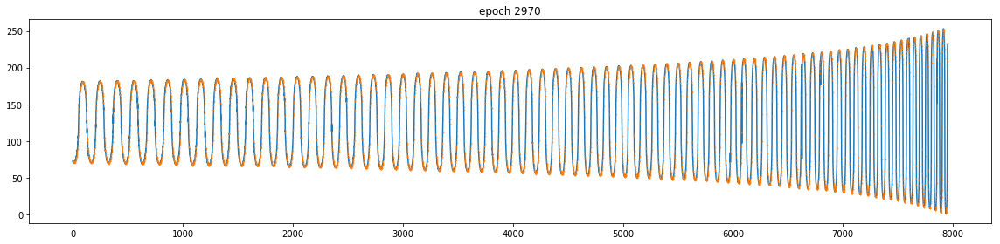

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2980, loss 0.0007359168375842273


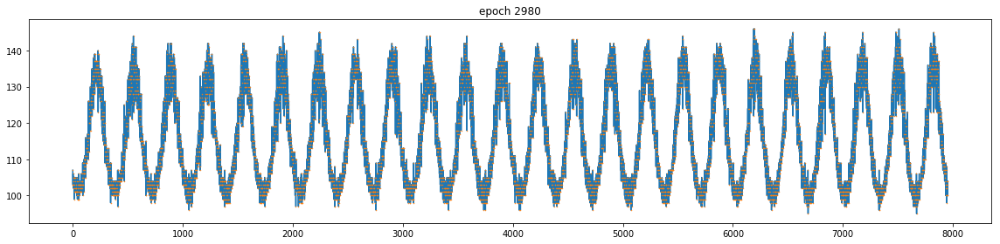

It took 1.22 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 2990, loss 0.0009243698441423476


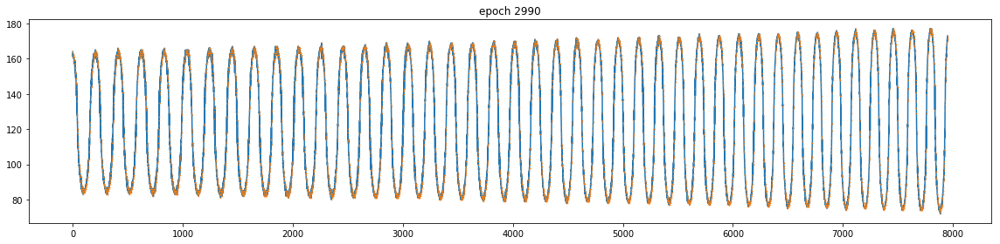

It took 1.22 seconds to finish an epoch
It took 1.20 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.23 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
It took 1.21 seconds to finish an epoch
epoch 3000, loss 0.00042978927376680076


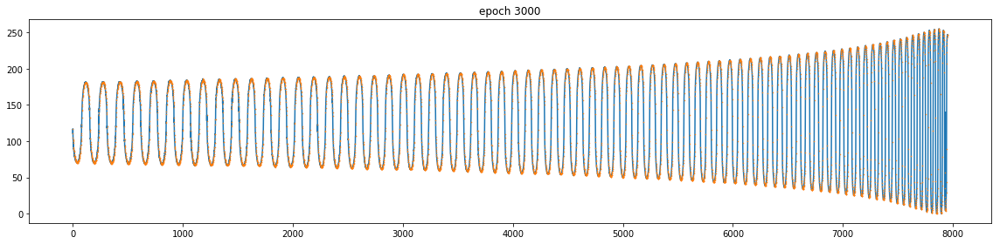

Checkpoint saved: checkpoint_epoch_mbh_batch_3000_2018_07_27__11_30.pth
It took 0.11 seconds to save data file
It took 3804.18 seconds to finish training


In [13]:
try:
    net, epoch, loss_save, optimizer = wavemod.load_checkpoint("npcheckpoint_epoch_mbh_150_2018_07_19__17_23.pth")
except:
    print("No checkpoint found - Initializing new training")
    net = wavemod.WaveNet(mu=256,n_residue=24,n_skip=128,dilation_depth=10,n_repeat=2).to(device)
    optimizer = optim.Adam(net.parameters(),lr=0.01)
    loss_save = []
    batch_size = 60
    epoch = 0

g = MBH_generator_batch(mu=256,seq_size=10000,noise=noise_time)    
batch_size = 60
max_epoch = 3000
start = time.time()

for epoch in range(max_epoch):
    start_epoch = time.time()
    epoch += 1
    optimizer.zero_grad()
    loss = 0
    
    for _ in range(batch_size):
        start_batch = time.time()
        batch = next(g)
        x = batch[:-1]
        logits = net(x)
        sz = logits.size(0)
        loss = loss + nn.functional.cross_entropy(logits, batch[-sz:])
    loss = loss/batch_size
    loss.backward()
    optimizer.step()
    loss_save.append(loss.data[0])
    
    print('It took {0:0.2f} seconds to finish an epoch'.format(time.time() - start_epoch))
    
    # monitor progress
    if epoch%10==0:
        print('epoch {}, loss {}'.format(epoch, loss.data[0]))
        batch = next(g)
        logits = net(batch[:-1])
        _, i = logits.max(dim=1)
        plt.figure(figsize=[16,4])
        plt.plot(i.data.tolist())
        plt.plot(batch.data.tolist()[sum(net.dilations)+1:],'.',ms=1)
        plt.title('epoch {}'.format(epoch))
        plt.tight_layout()
        plt.show()
    
    if epoch%50 == 0:
        start_save = time.time()
        cp = "checkpoint_epoch_mbh_batch_" + str(epoch) + "_" + strftime("%Y_%m_%d__%H_%M", localtime()) + '.pth'
        wavemod.save_checkpoint({
            'epoch': epoch,
            'state_dict': net.state_dict(),
            'optimizer' : optimizer.state_dict(),
            'loss_save' : loss_save,
        }, cp)
        print('It took {0:0.2f} seconds to save data file'.format(time.time() - start_save))
        
print('It took {0:0.2f} seconds to finish training'.format(time.time() - start))


# loss function

Text(0.5,1,'loss function')

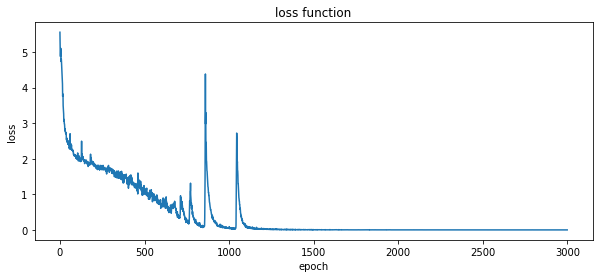

In [14]:
plt.figure(figsize=[10,4])
plt.plot(loss_save)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.title('loss function')

## data generation

In [6]:
net, epoch, loss_save, optimizer = wavemod.load_checkpoint("checkpoint_epoch_mbh_100_2018_07_25__15_58.pth")

Loaded checkpoint: checkpoint_epoch_mbh_100_2018_07_25__15_58.pth


In [22]:
dt = 20.0
Tobs = 15*24*3600
N = int(Tobs/dt)
t = np.arange(N)
%time data_complete, generated = net.generate_gap(x_all, t, 1, t_start=9000, t_end=10260)

input size: 64800
i_start:  9000
i_end:  10260
number of data points before gap: 9000
number of data points after gap: 54540
gap size: 1260
CPU times: user 7.42 s, sys: 708 ms, total: 8.13 s
Wall time: 8.13 s


In [23]:
data_complete.shape

(64800,)

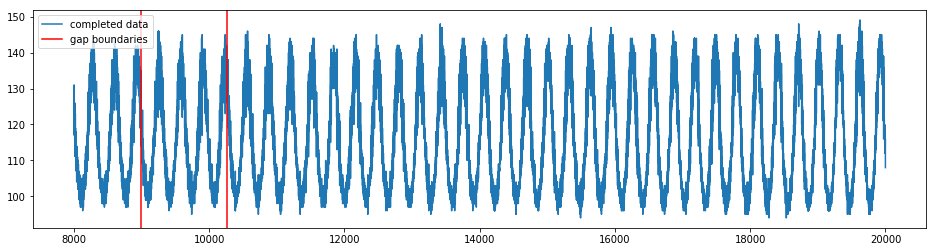

In [24]:
t_start=9000
t_end=10260

plt.figure(figsize=[16,4])
plt.plot(t[8000:20000],data_complete[8000:20000])
#plt.plot(t, x.data.tolist(),'.',ms=1)
plt.axvline(x=t_start, color='r')
plt.axvline(x=t_end, color='r')
plt.legend(['completed data', 'gap boundaries'])

In [168]:
test = next(g)

%time y_gen = net.generate(test[2500:4600], 2500)

CPU times: user 15.7 s, sys: 1.68 s, total: 17.4 s
Wall time: 17.4 s


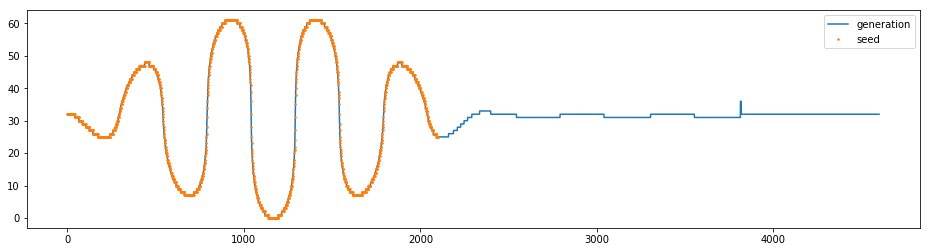

In [58]:
plt.figure(figsize=[16,4])
plt.plot(y_gen)
plt.plot(test[2500:4600].data.tolist(),'.',ms=3)
plt.legend(['generation','seed'])